In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyedfread import edf
import pickle
from glob import glob
from os.path import join
%matplotlib inline
import seaborn as sns
from scipy import signal
from scipy import interpolate
from PSPupil import Preprocessing as PS
from scipy.stats import ttest_ind
from PSPupil import dataset as dt
from decim.adjuvant import slurm_submit as slu


### Preprocessing with segmentation approach

Stand: Dezember 2023

Approach:
1. Identify artifacts/blinks/etc
2. Decide if invalid segment is to long for interpolation
- cut/off: 350 ms (arbitrary, adpoted from molly)
3. decide if valid segments are long enough
- 24s cut/off (necessary for FFT with Frequency of interest > 1/8 Hz)
4. FFT persegment
5. Average per run weighted by length of segment
6. Average across runs weighted by length of used material per run

In [10]:
preprocessing_meta=[] # collect meta data: preprocessing parameters, no of segments, segment length


## 1. PSP

- only marca data
- do preprocessing using Preprocessing script
- afterwards do segments: new segment if invalid > 350 ms, segment need to be of length 24s
- inspect result and manually redo if blink detection not satisfying
- save .hdf persegment

001 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2018_02_08_PSP_001_Baseline/000/pupil_data']
0.9


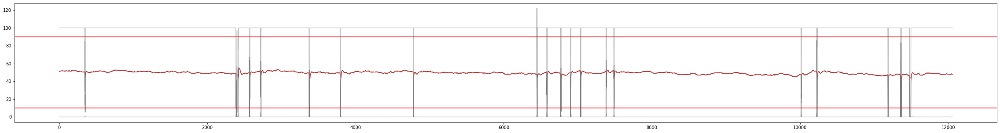

segment 0 40.493949326948496


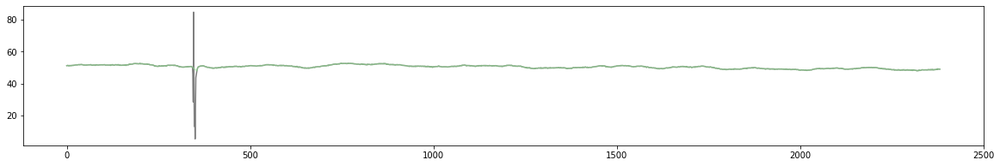

segment 1 153.96915964095388


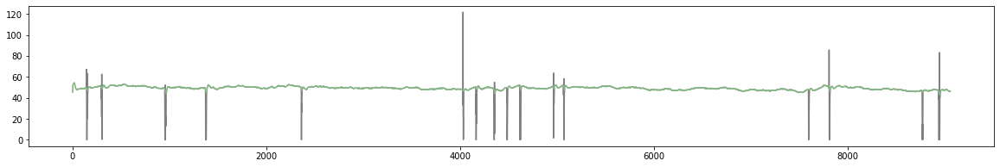

segment 2 9.45197153877234
2 segments, 194.46310896790237 seconds total length
001 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2018_02_08_PSP_001_Baseline/001/pupil_data']
0.9


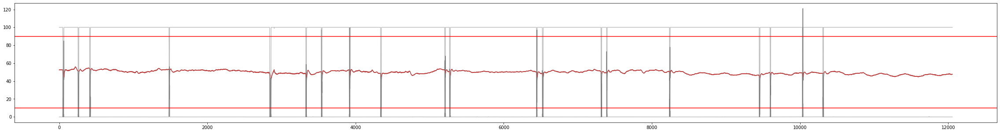

segment 0 48.24612595254439


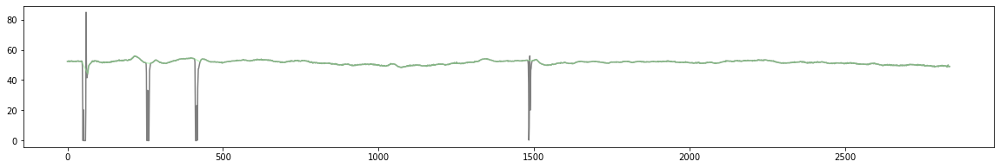

segment 1 156.3149656834139


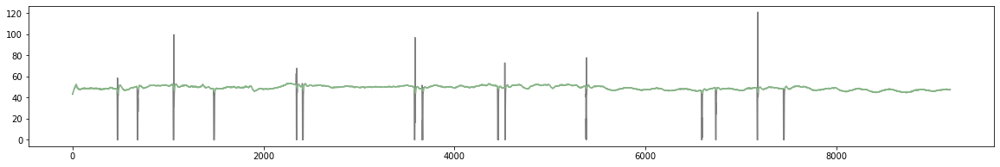

2 segments, 204.5610916359583 seconds total length
001 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2018_02_08_PSP_001_Baseline/002/pupil_data']
0.9


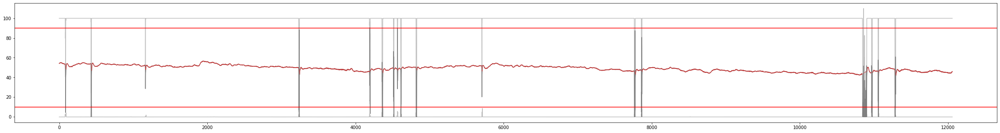

segment 0 184.31401332216046


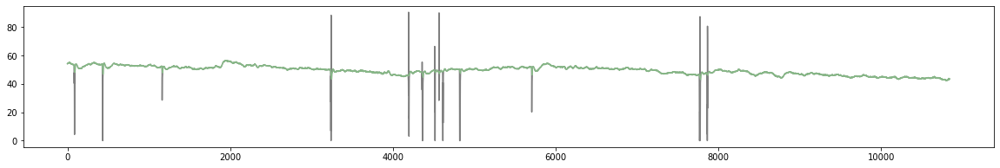

segment 1 19.56695164062694
1 segments, 184.31401332216046 seconds total length
001 Followup 001
['/Volumes/psp_data/Lisa_Marc/2018_08_16_PSP_001_Followup/001_0/pupil_data']
0.9


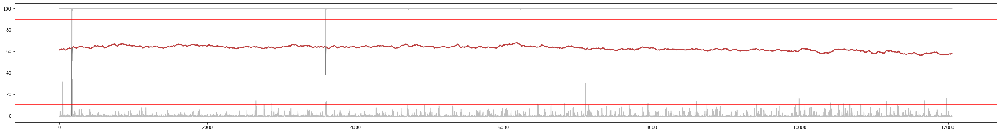

segment 0 2.7370020093094354
segment 1 201.8749403786478


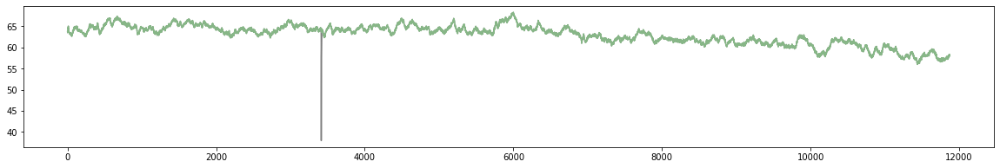

1 segments, 201.8749403786478 seconds total length
001 Followup 002
['/Volumes/psp_data/Lisa_Marc/2018_08_16_PSP_001_Followup/002_1/pupil_data']
0.9


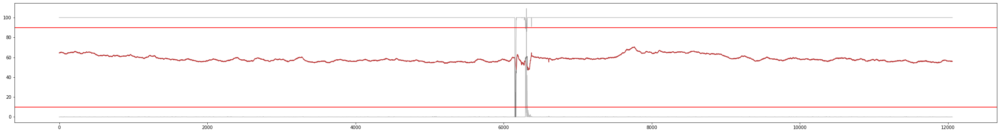

segment 0 104.53301501289661


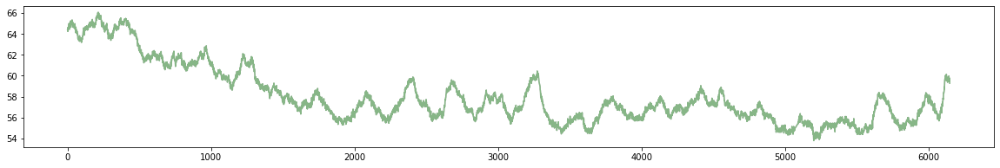

segment 1 2.0230026985809673
segment 2 97.49501921531646


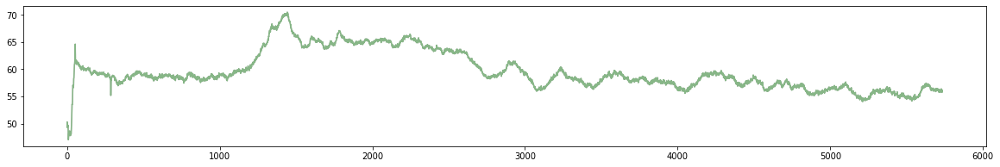

2 segments, 202.02803422821307 seconds total length
001 Followup 004
['/Volumes/psp_data/Lisa_Marc/2018_08_16_PSP_001_Followup/004_3/pupil_data']
0.9


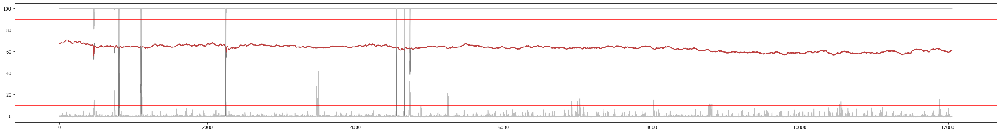

segment 0 204.96904934185204


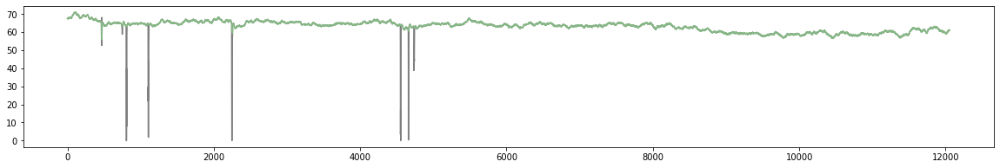

1 segments, 204.96904934185204 seconds total length
002 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2018_03_28_PSP_002_Baseline/001/pupil_data']
0.9


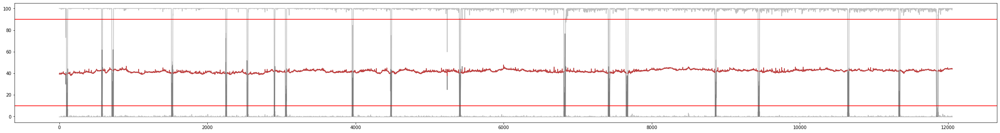

segment 0 1.4449753969165613
segment 1 10.012983092055947
segment 2 13.192026837408775
segment 3 12.018977915264259
segment 4 4.487958621080907
segment 5 8.466031660842418
segment 6 14.891991503209283
segment 7 8.466020154723083
segment 8 15.419018048414728
segment 9 23.562018933873333
segment 10 9.622099996471661
segment 11 3.6209731200360693
segment 12 19.906985437104595
segment 13 9.485970226007339
segment 14 20.110982073114428
segment 15 11.321987453797192
segment 16 8.261929592168599
segment 17 3.2129835456435103
0 segments, 0 seconds total length
002 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2018_03_28_PSP_002_Baseline/002/pupil_data']
0.9


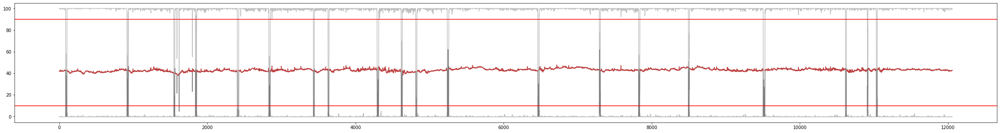

segment 0 1.4279794749891153
segment 1 13.668068921579106
segment 2 10.3359863441583
segment 3 4.607036195571709
segment 4 9.23106374222698
segment 5 6.800044903618982
segment 6 24.41200117491826


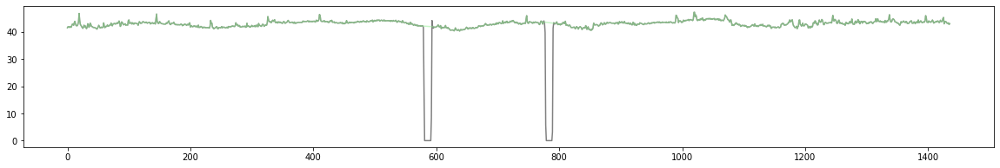

segment 7 5.049041064849007
segment 8 2.9750391229899833
segment 9 6.8510268292957335
segment 10 20.332009672296408
segment 11 22.72899596039497
segment 12 11.033001959127432
segment 13 16.82999593381828
segment 14 42.924986990627076


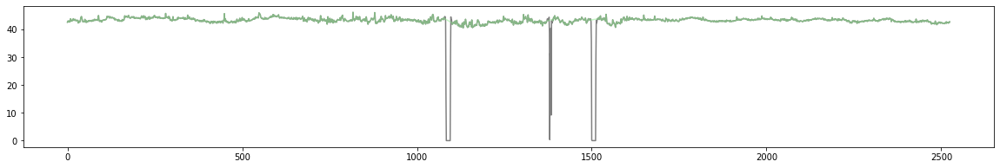

2 segments, 67.33698816554534 seconds total length
002 Baseline 003
['/Volumes/psp_data/Lisa_Marc/2018_03_28_PSP_002_Baseline/003/pupil_data']
0.9


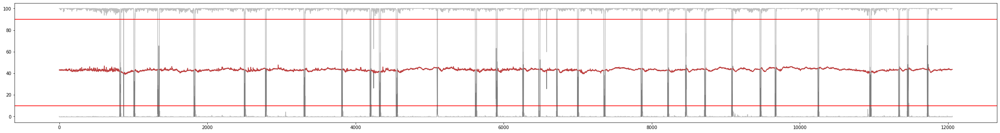

segment 0 13.820985796679452
segment 1 2.87299066655396
segment 2 5.1169785576930735
segment 3 7.819993002609408
segment 4 24.87095676903118


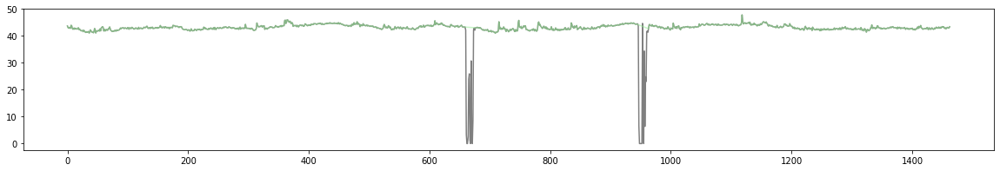

segment 5 14.789946912533196
segment 6 1.7680578424187843
segment 7 3.4679806557760458
segment 8 17.74806591511151
segment 9 4.38601930776349
segment 10 9.367034380433324
segment 11 8.448957060572866
segment 12 5.695055302690889
segment 13 8.125999062300252
segment 14 5.695188688216149
segment 15 8.109093570979894
segment 16 12.34176988038962
segment 17 24.837080579076428


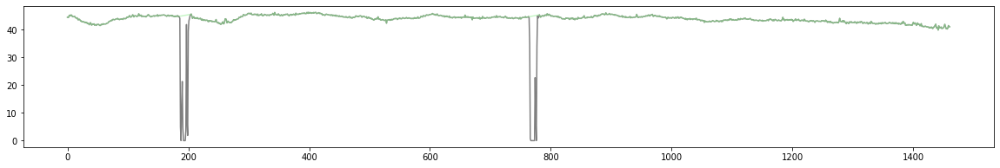

segment 18 8.211030184625997
segment 19 9.995985472669418
2 segments, 49.70803734810761 seconds total length
007 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2018_08_09_PSP_007_Baseline/000/pupil_data']
0.9


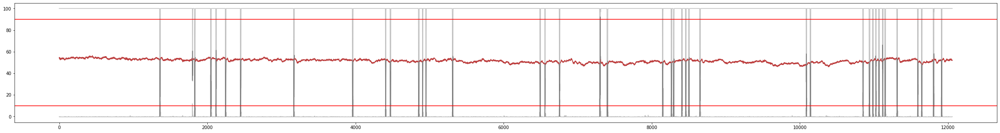

segment 0 204.96908107713966


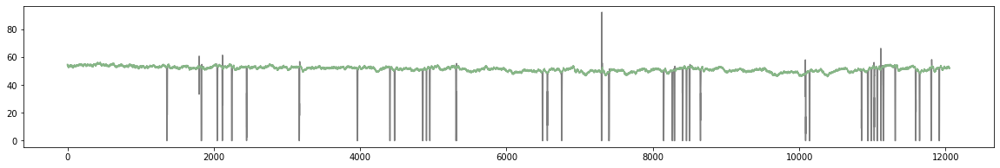

1 segments, 204.96908107713966 seconds total length
007 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2018_08_09_PSP_007_Baseline/001/pupil_data']
0.9


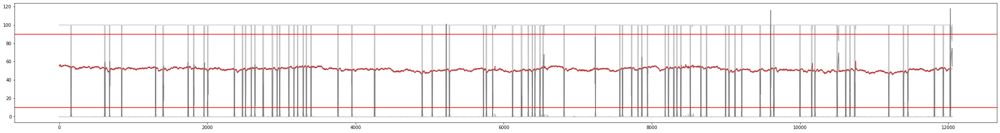

segment 0 178.39799663100723


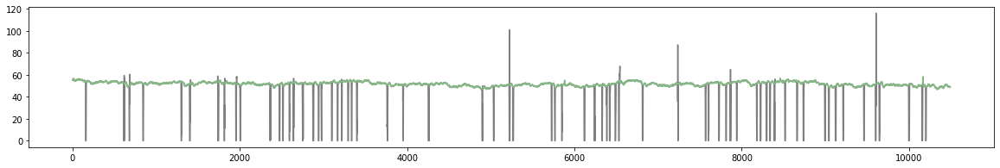

segment 1 25.380985541831024


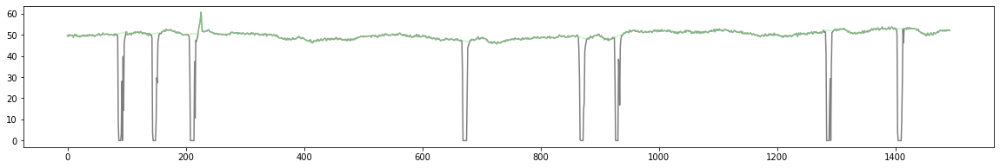

segment 2 0.0
2 segments, 203.77898217283825 seconds total length
007 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2018_08_09_PSP_007_Baseline/002/pupil_data']
0.9


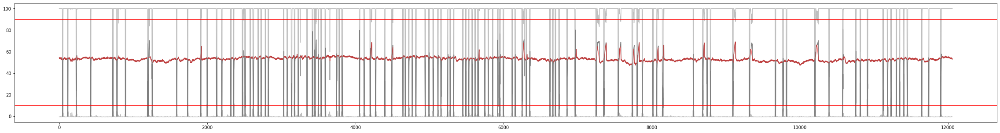

segment 0 20.196104962220716
segment 1 21.13098852701478
segment 2 15.759021941029687
segment 3 12.172020568509652
segment 4 4.521999895110184
segment 5 46.97098513511742


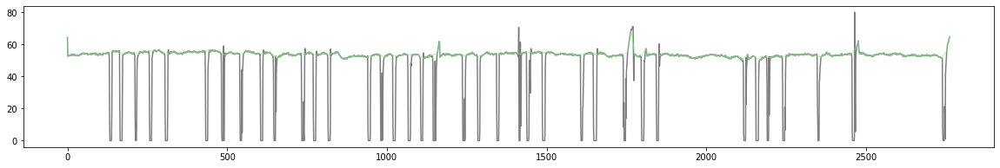

segment 6 8.500035715375134
segment 7 40.83399243946337


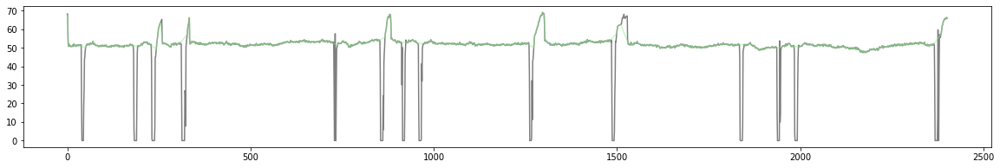

segment 8 30.66801321136063


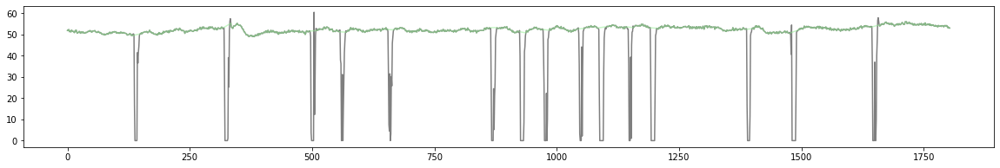

3 segments, 118.47299078594142 seconds total length
007 Followup 000
['/Volumes/psp_data/Lisa_Marc/2019_02_12_PSP_007_Followup/000/pupil_data']
0.9


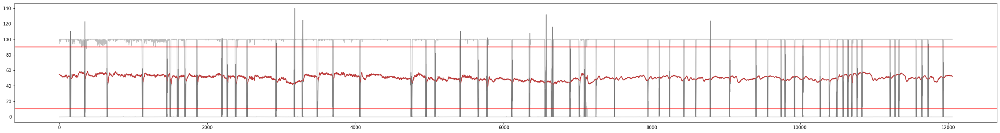

segment 0 2.362931713385933
segment 1 8.091879420020177
segment 2 14.127012368764099
segment 3 1.3089502145735423
segment 4 1.2918559305230701
segment 5 2.345986676424218
segment 6 5.321040396316221
segment 7 2.8220553388609915
segment 8 8.907978233279664
segment 9 5.694909886610731
segment 10 3.0769343781685166
segment 11 21.181981143727626
segment 12 2.9580295872642637
segment 13 11.610987368184396
segment 14 1.5979877853824291
segment 15 9.400928083033705
segment 16 3.281052470580107
segment 17 1.002952359659048
segment 18 6.918926334081334
segment 19 57.340982977261774


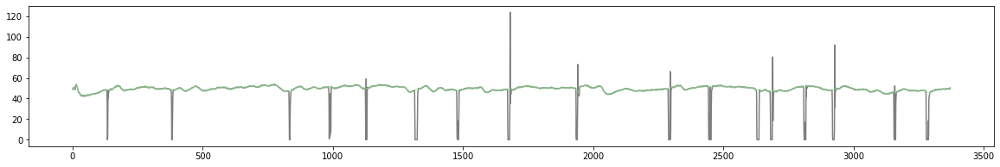

segment 20 26.333043461962916


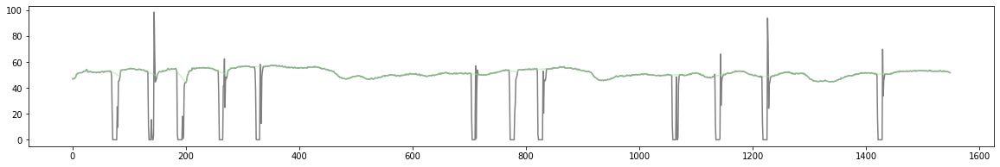

2 segments, 83.67402643922469 seconds total length
007 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_02_12_PSP_007_Followup/001/pupil_data']
0.9


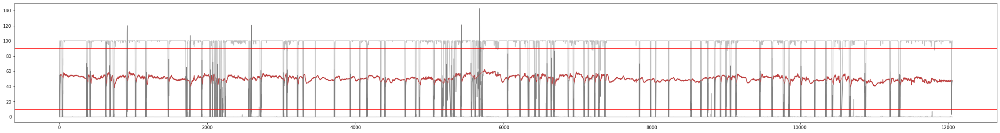

segment 0 6.137004140640329
segment 1 4.913154296406901
segment 2 0.4249997317197085
segment 3 2.6519814999260234
segment 4 1.649051053301264
segment 5 2.039991378677314
segment 6 8.874005037477673
segment 7 0.3230880979558606
segment 8 4.301030548912877
segment 9 0.7309789578162054
segment 10 0.2890535039041424
segment 11 5.6609593708603825
segment 12 1.8189842815422708
segment 13 4.8449908051838975
segment 14 0.37400716975798787
segment 15 30.039033448841565


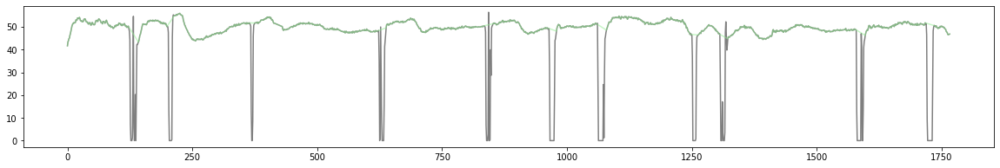

segment 16 2.923973710298469
segment 17 1.5129927415141537
segment 18 0.4250153211687575
segment 19 0.30600044264019743
segment 20 0.25510365706713856
segment 21 1.1901021029630101
segment 22 2.073893755845347
segment 23 0.25497299972766996
segment 24 10.216975180691406
segment 25 1.1559668815216355
segment 26 2.1929702575966985
segment 27 1.3259943177627065
segment 28 9.92802592616863
segment 29 28.628037271550966


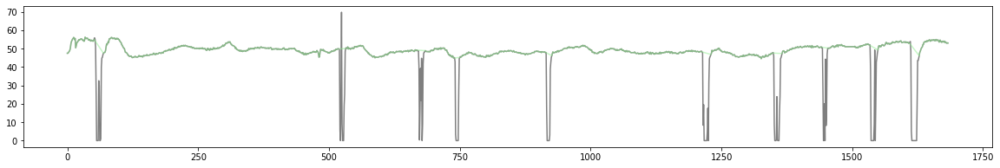

segment 30 0.5439809287577191
segment 31 11.848974268897564
segment 32 0.7819958099626092
segment 33 8.091977790985311
segment 34 3.1111252929417788
segment 35 1.3430787694496757
segment 36 3.127922494617451
segment 37 7.309993876646331
segment 38 11.882975278500453
2 segments, 58.66707072039253 seconds total length
007 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_02_12_PSP_007_Followup/002/pupil_data']
0.9


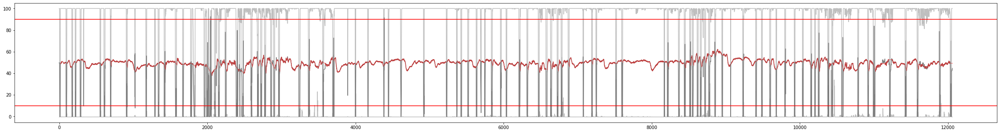

segment 0 24.021116936396993


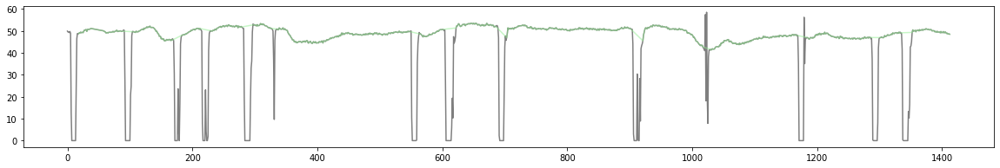

segment 1 2.209992795470498
segment 2 3.1279835772434126
segment 3 0.16988300792399968
segment 4 1.9210022608390318
segment 5 0.20398111680060538
segment 6 0.5440268797719909
segment 7 0.3059910073379797
segment 8 0.8669779133065276
segment 9 2.1247323792704265
segment 10 0.25503758028708035
segment 11 1.5979295589554567
segment 12 1.087998554855858
segment 13 0.4249963333154483
segment 14 0.5100160184497327
segment 15 0.8670308500427382
segment 16 0.7480198557937001
segment 17 4.318047421816573
segment 18 1.7849921981032821
segment 19 2.9581112244632095
segment 20 1.5979264341535782
segment 21 15.163962570657532
segment 22 26.809018228752393


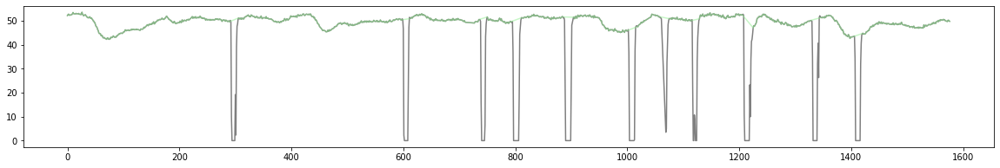

segment 23 5.830975293610663
segment 24 0.6630151583744919
segment 25 2.056926764294076
segment 26 1.2409911446911792
segment 27 29.256996470507147


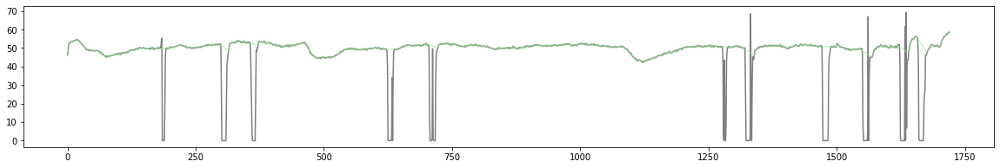

segment 28 0.3570938585157819
segment 29 1.580994257441489
segment 30 26.723996940279903


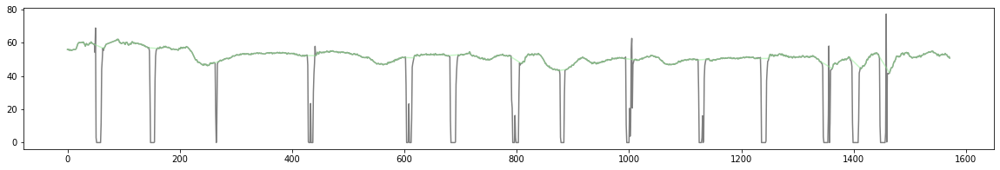

segment 31 0.39092003194900826
segment 32 1.8869494688997293
segment 33 6.766099233610021
segment 34 1.5470357282283658
segment 35 0.8330050827566993
segment 36 2.8389977378169533
segment 37 3.604103944220242
segment 38 5.796906136624784
segment 39 0.0
4 segments, 106.81112857593644 seconds total length
010 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_01_17_PSP_010_Baseline/000/pupil_data']
0.9


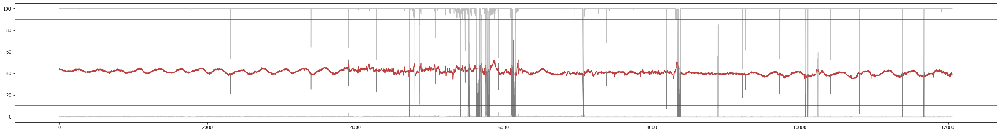

segment 0 93.82291422155186


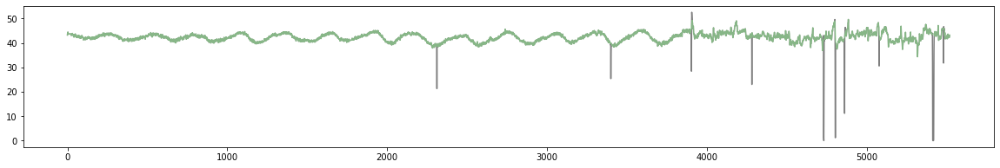

segment 1 1.4110255932428117
segment 2 0.5949862527486403
segment 3 4.9300393949970385
segment 4 37.04291163283051


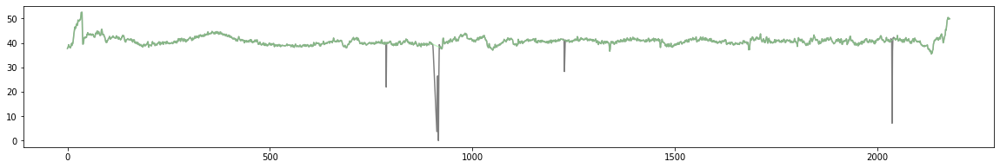

segment 5 62.25401325875737


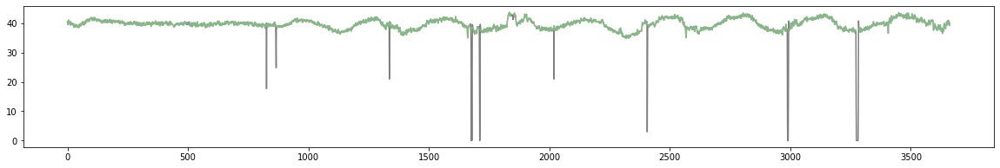

3 segments, 193.11983911313973 seconds total length
010 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_01_17_PSP_010_Baseline/001/pupil_data']
0.9


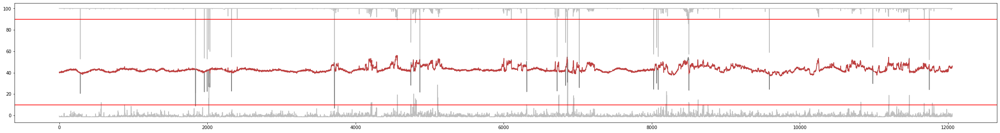

segment 0 204.96896823469115


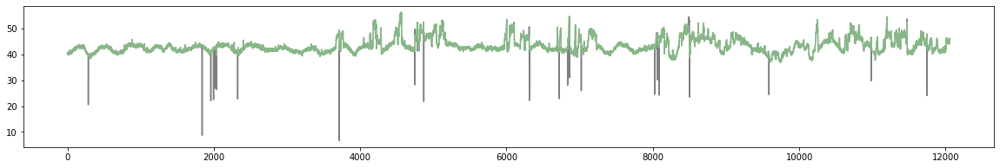

1 segments, 204.96896823469115 seconds total length
010 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_01_17_PSP_010_Baseline/002/pupil_data']
0.9


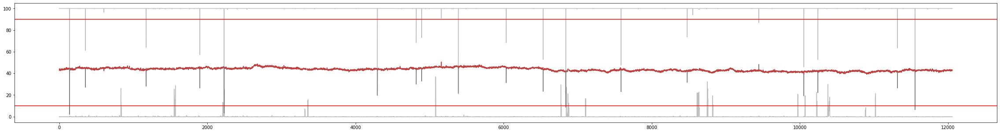

segment 0 146.31909098035248


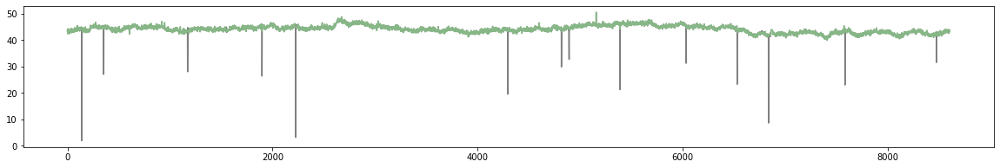

segment 1 58.072237013796894


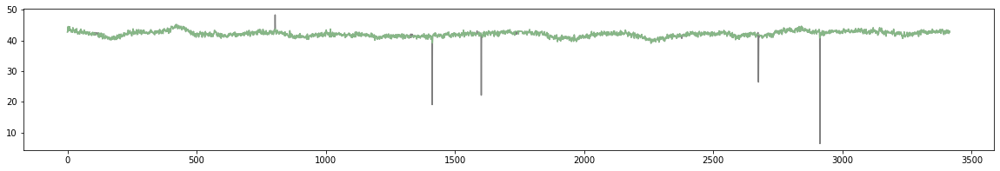

2 segments, 204.39132799414938 seconds total length
010 Followup 004
['/Volumes/psp_data/Lisa_Marc/2019_12_16_PSP_010_Followup/004/pupil_data']
0.9


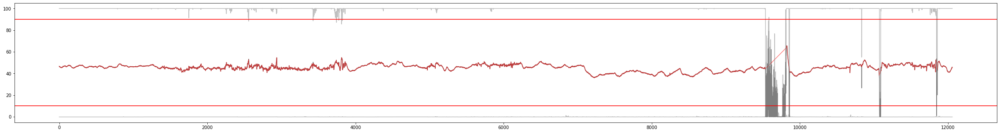

segment 0 162.0610068786541


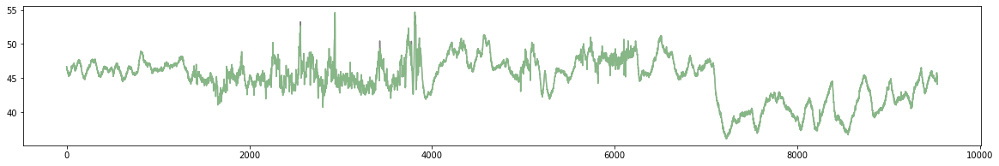

segment 1 21.317964362809107
segment 2 16.371063601418882
1 segments, 162.0610068786541 seconds total length
010 Followup 005
['/Volumes/psp_data/Lisa_Marc/2019_12_16_PSP_010_Followup/005/pupil_data']
0.9


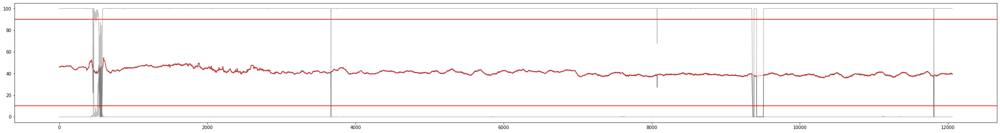

segment 0 8.73794345128681
segment 1 148.953974091075


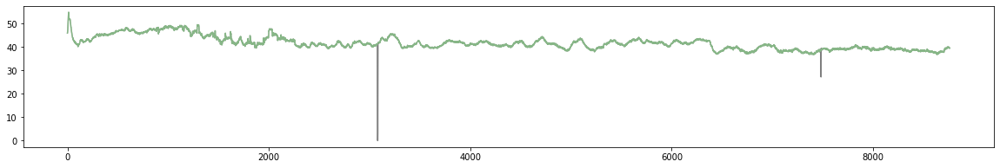

segment 2 0.47601022832304807
segment 3 43.26504334630954


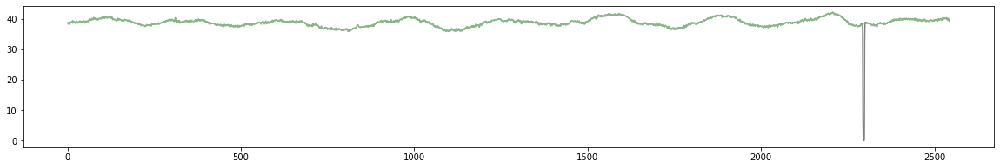

2 segments, 192.21901743738454 seconds total length
010 Followup 006
['/Volumes/psp_data/Lisa_Marc/2019_12_16_PSP_010_Followup/006/pupil_data']
0.9


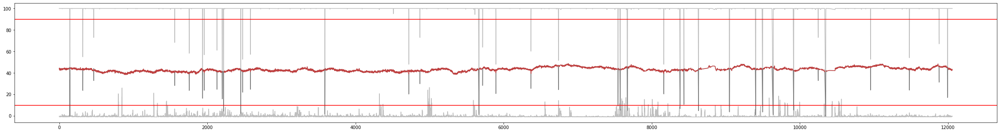

segment 0 37.33207002490326


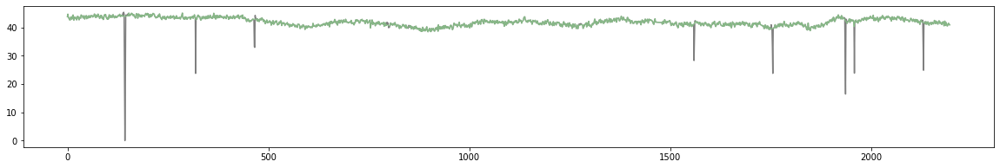

segment 1 125.78301394862365


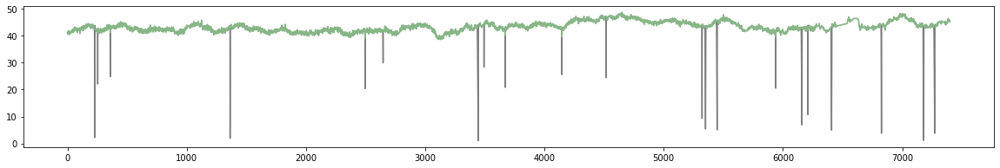

segment 2 41.02093370997727


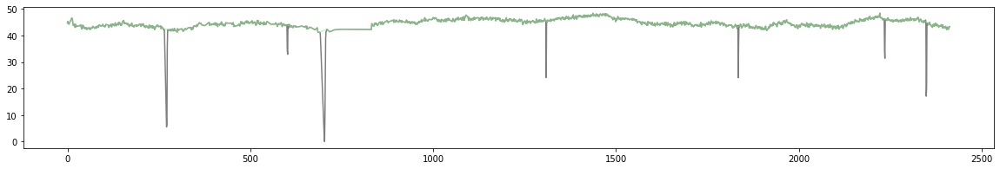

3 segments, 204.13601768350418 seconds total length
012 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_03_06_PSP_012_Baseline(alt)/000/pupil_data', '/Volumes/psp_data/Lisa_Marc/2019_03_20_PSP_012_Baseline(neu)/000/pupil_data']
0.9


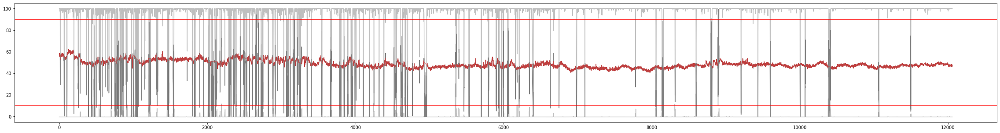

segment 0 7.90504447843341
segment 1 0.8329562862804778
segment 2 1.4620797598454374
segment 3 1.2242360500563336
segment 4 0.18703376455096077
segment 5 0.23799746571603464
segment 6 2.1586748659187833
segment 7 2.277989468301712
segment 8 1.291915739948763
segment 9 2.091055474309087
segment 10 5.67811287526456
segment 11 2.8220086473302217
segment 12 0.30604427326306904
segment 13 2.6181942394696307
segment 14 0.373957181815058
segment 15 1.9210569052697792
segment 16 1.7849994445891753
segment 17 0.7991135485094674
segment 18 5.235914170653359
segment 19 0.9517135455444077
segment 20 0.7820983947608511
segment 21 8.619200318198637
segment 22 2.1420506795370784
segment 23 0.3910725072378227
segment 24 10.131995226756317
segment 25 4.828339593847886
segment 26 6.44292769495587
segment 27 11.611067917982382
segment 28 5.269943695025177
segment 29 29.375638993229586


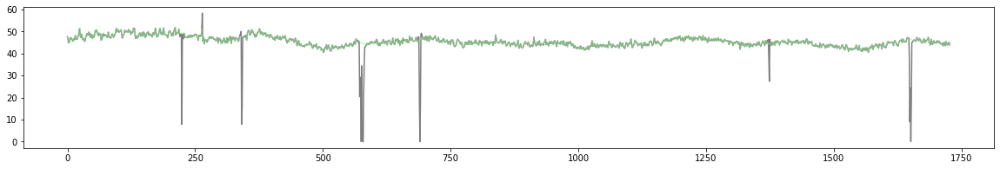

segment 30 10.743989335900551
segment 31 26.571025461691534


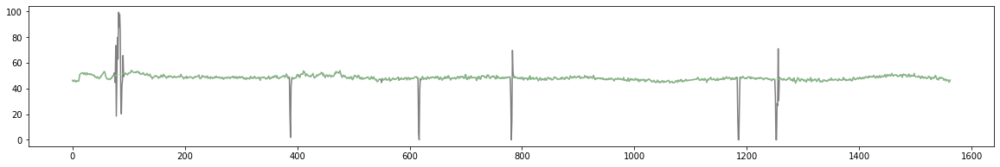

segment 32 27.86266978262347


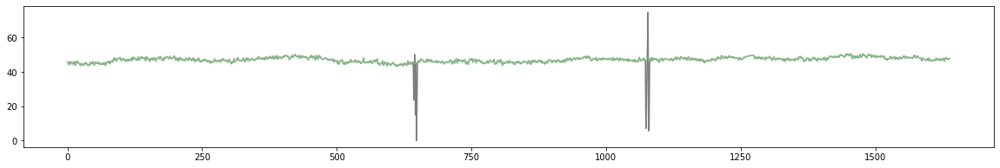

3 segments, 83.80933423754459 seconds total length
012 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_03_06_PSP_012_Baseline(alt)/001/pupil_data', '/Volumes/psp_data/Lisa_Marc/2019_03_20_PSP_012_Baseline(neu)/001/pupil_data']
0.9


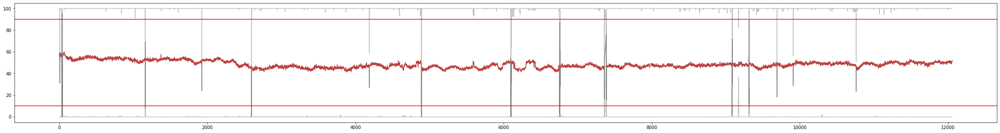

segment 0 125.05205162323546


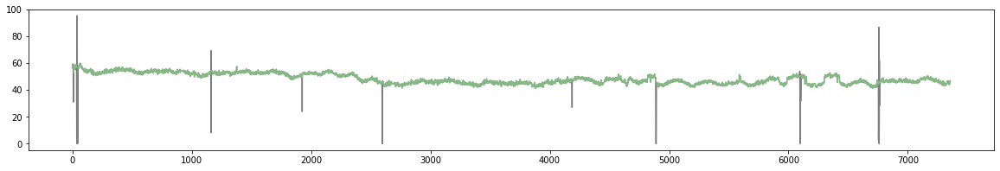

segment 1 79.30470708080611


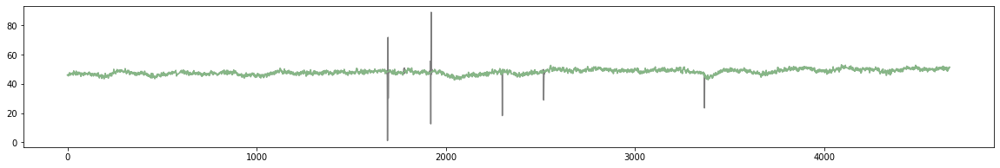

2 segments, 204.35675870404157 seconds total length
012 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_03_06_PSP_012_Baseline(alt)/002/pupil_data', '/Volumes/psp_data/Lisa_Marc/2019_03_20_PSP_012_Baseline(neu)/002/pupil_data']
0.9


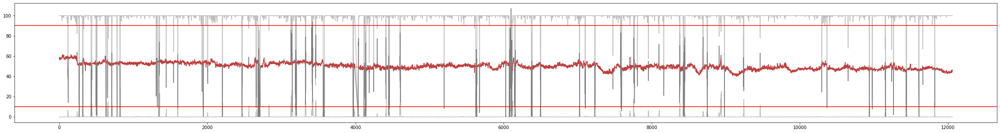

segment 0 22.18481773688245
segment 1 22.98395142356594
segment 2 6.953049626897609
segment 3 0.5780459731513474
segment 4 6.001003957426292
segment 5 6.952670029765613
segment 6 1.1219712766351222
segment 7 25.075047596691093


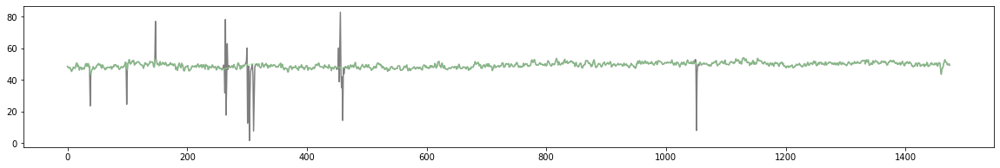

segment 8 7.292933124304454
segment 9 0.3737730820980687
segment 10 23.98708278463255
segment 11 14.007936443311792
segment 12 61.28504956150482


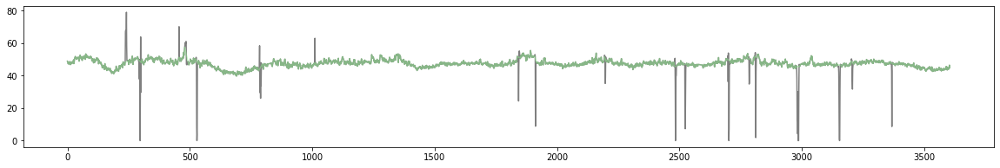

2 segments, 86.36009715819591 seconds total length
012 Followup 000
['/Volumes/psp_data/Lisa_Marc/2019_10_09_PSP_012_Followup/000/pupil_data']
0.9


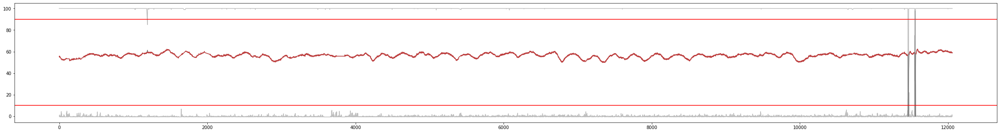

segment 0 194.73502684500681


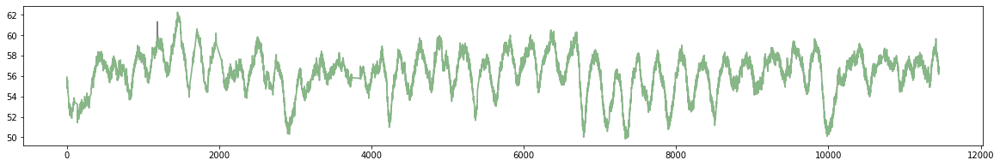

segment 1 1.1560573363458388
segment 2 8.330106060935577
1 segments, 194.73502684500681 seconds total length
012 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_10_09_PSP_012_Followup/001/pupil_data']
0.9


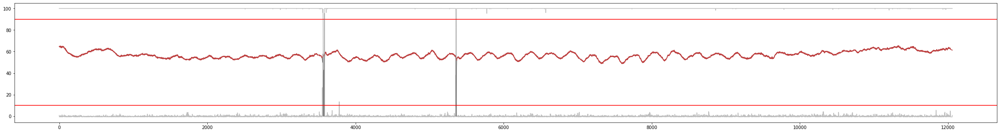

segment 0 60.333042629500596


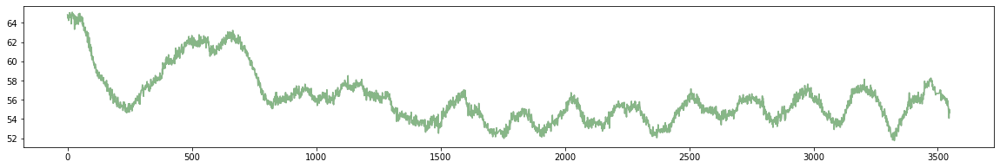

segment 1 143.98968733704214


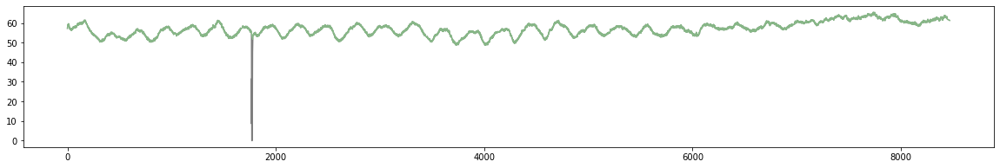

2 segments, 204.32272996654274 seconds total length
012 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_10_09_PSP_012_Followup/002/pupil_data']
0.9


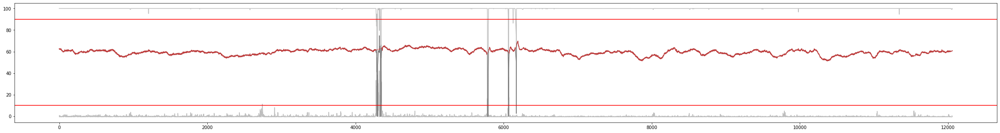

segment 0 72.65797698386723


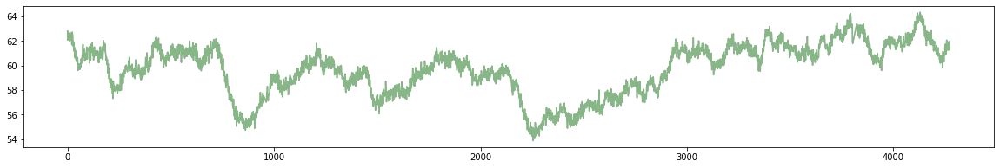

segment 1 130.89996361697104


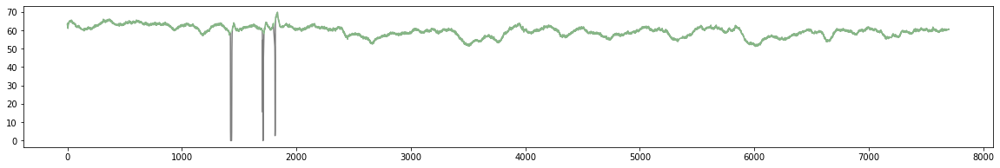

2 segments, 203.55794060083826 seconds total length
013 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_02_04_PSP_013_Baseline/000/pupil_data']
0.9


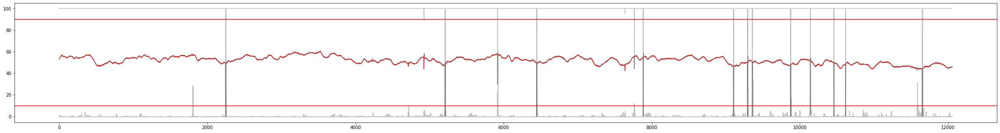

segment 0 204.96902919299828


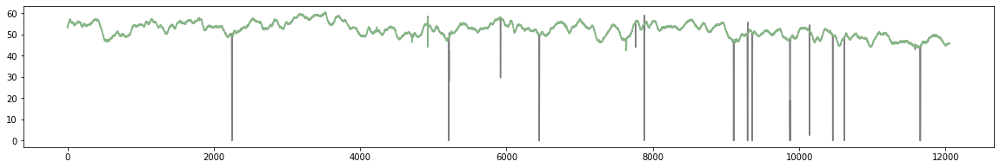

1 segments, 204.96902919299828 seconds total length
013 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_02_04_PSP_013_Baseline/001/pupil_data']
0.9


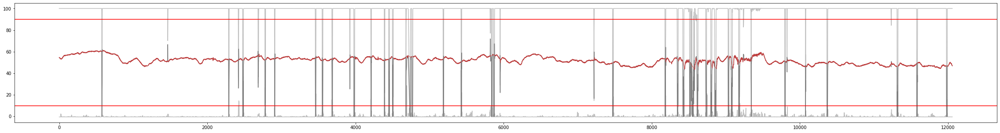

segment 0 80.10403346656858


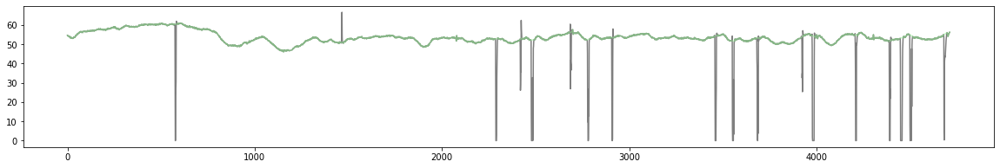

segment 1 18.17303320101746
segment 2 43.6560233908458


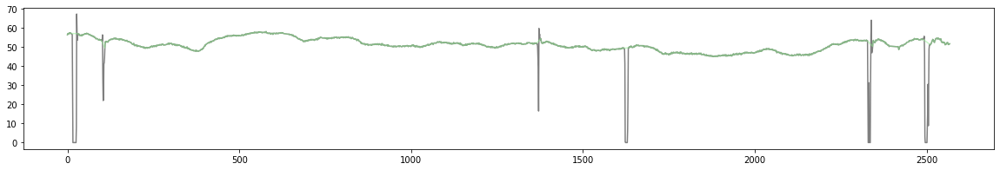

segment 3 1.1049300857357593
segment 4 0.271998515312589
segment 5 1.683036731188622
segment 6 0.7820516872270673
segment 7 0.5270156335773208
segment 8 3.3490454014990974
segment 9 50.40508070511896


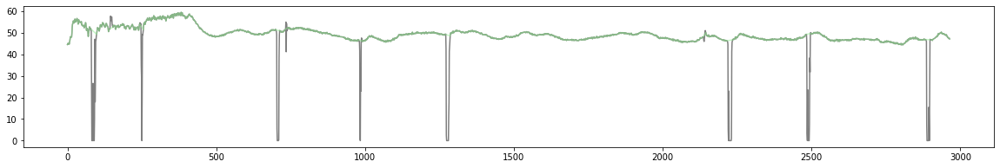

3 segments, 174.16513756253335 seconds total length
013 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_02_04_PSP_013_Baseline/002/pupil_data']
0.9


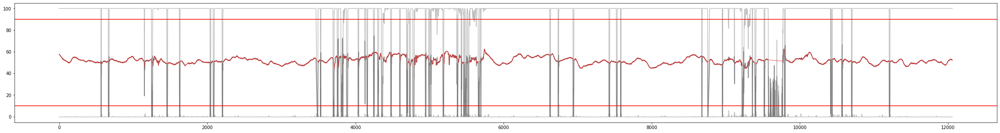

segment 0 21.13102367448664
segment 1 37.38300003943186


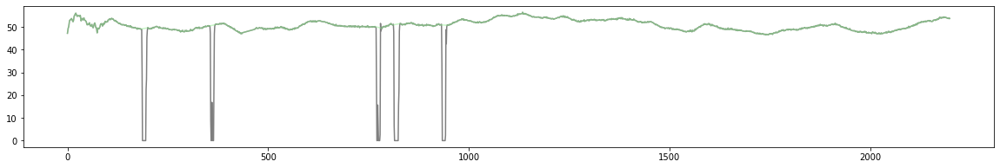

segment 2 3.348824572018202
segment 3 0.5949750343970663
segment 4 0.4589439049213979
segment 5 0.5099982621850359
segment 6 7.582003686391545
segment 7 4.94696735474281
segment 8 0.2720036048540351
segment 9 0.4419907840874657
segment 10 3.14504306841809
segment 11 7.327048113889759
segment 12 1.7680173463122628
segment 13 51.91804096751184


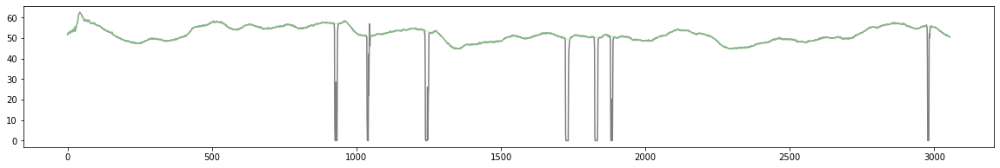

segment 14 7.361001717878025
segment 15 0.3569957062263711
segment 16 1.0030287121389847
segment 17 2.7200558115218882
segment 18 10.7950344022629
segment 19 27.47197030546704


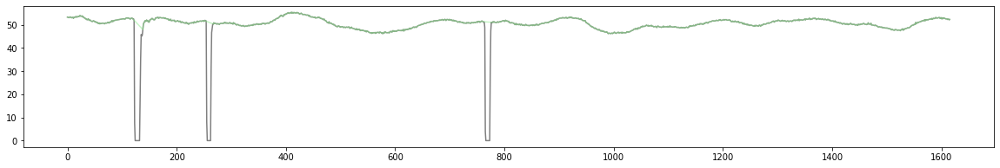

3 segments, 116.77301131241074 seconds total length
014 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_02_01_PSP_014_Baseline/000/pupil_data']
0.9


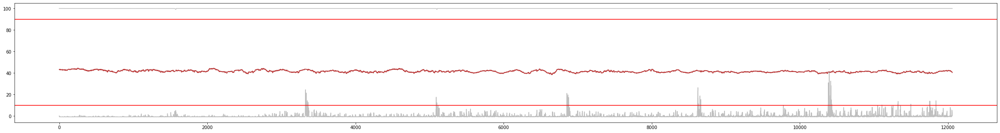

segment 0 204.9689547068001


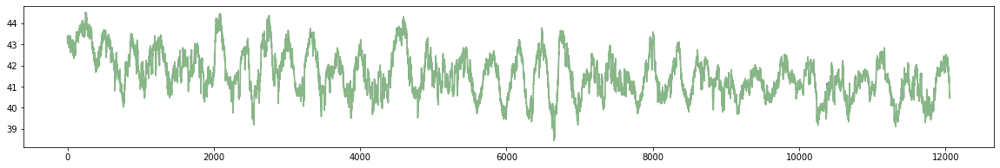

1 segments, 204.9689547068001 seconds total length
014 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_02_01_PSP_014_Baseline/001/pupil_data']
0.9


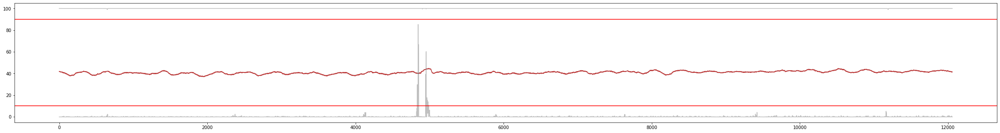

segment 0 82.12697770573595


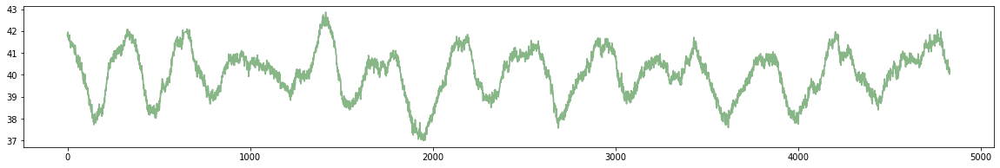

segment 1 122.40001902008134


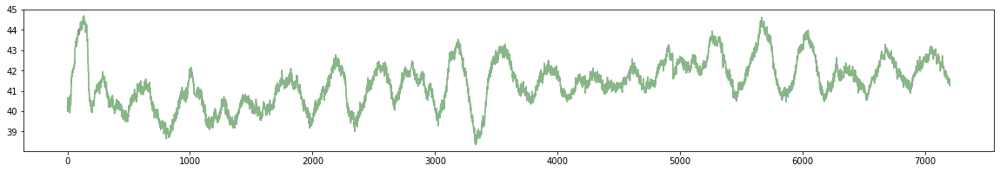

2 segments, 204.5269967258173 seconds total length
014 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_02_01_PSP_014_Baseline/002/pupil_data']
0.9


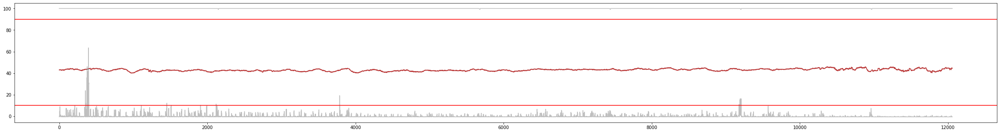

segment 0 6.289866426564913
segment 1 198.10098951247164


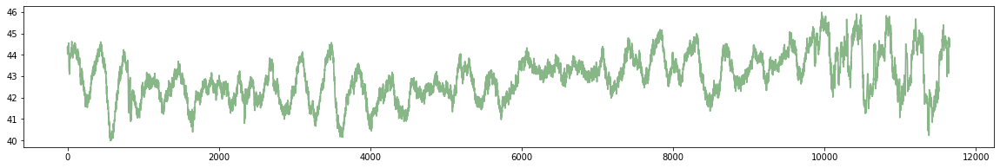

1 segments, 198.10098951247164 seconds total length
018 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_05_06_PSP_018_Baseline/001/pupil_data']
0.9


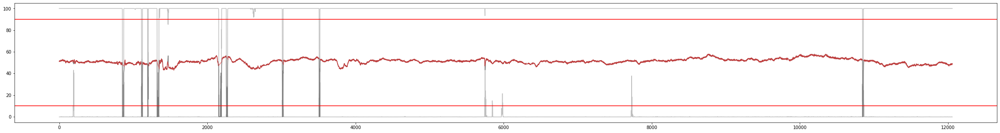

segment 0 14.450034551198769
segment 1 3.875950958528847
segment 2 3.2469823326532605
segment 3 13.61696556064635
segment 4 0.9690516875070898
segment 5 20.893011682345332
segment 6 124.30402991060373


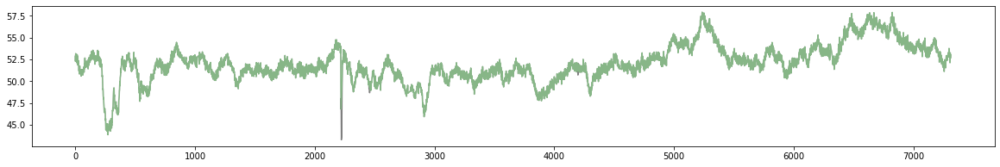

segment 7 20.298006075779995
1 segments, 124.30402991060373 seconds total length
018 Baseline 003
['/Volumes/psp_data/Lisa_Marc/2019_05_06_PSP_018_Baseline/003/pupil_data']
0.9


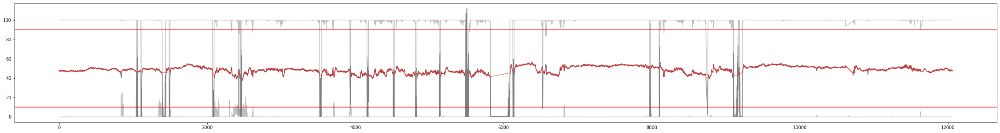

segment 0 14.16105197603747
segment 1 3.144963096103311
segment 2 5.52501909176317
segment 3 10.590960703338169
segment 4 5.525008117220295
segment 5 17.74795943015488
segment 6 10.3700737156978
segment 7 5.558988911566303
segment 8 4.759969050478048
segment 9 4.997979156494694
segment 10 5.644040186970415
segment 11 4.709020062890431
segment 12 0.5779645547804648
segment 13 7.105961764315907
segment 14 25.70400734343366


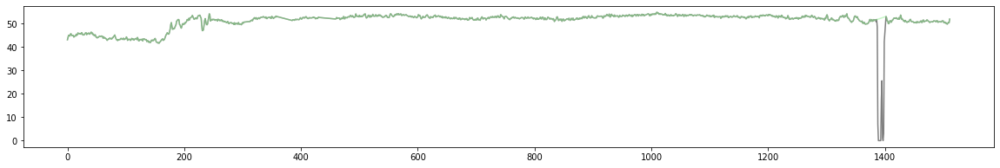

segment 15 10.3356224537456
segment 16 5.728988383315482
segment 17 0.20388640616238263
segment 18 48.1268388517351


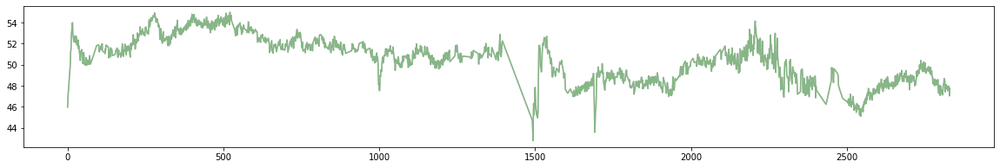

2 segments, 73.83084619516876 seconds total length
018 Baseline 004
['/Volumes/psp_data/Lisa_Marc/2019_05_06_PSP_018_Baseline/004/pupil_data']
0.9


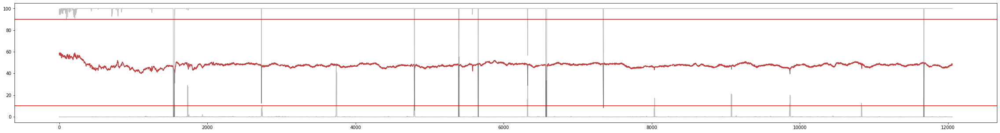

segment 0 26.128982650049238


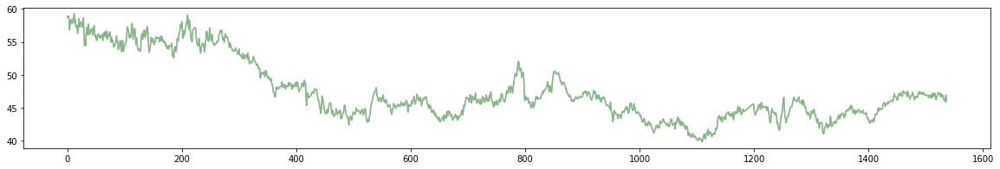

segment 1 178.43210184451482


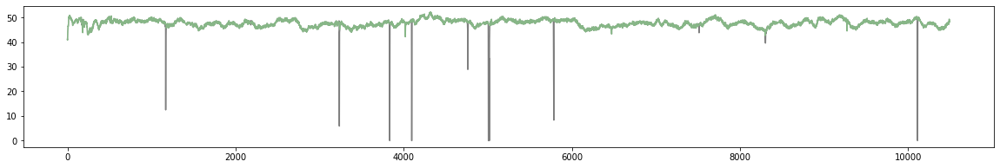

2 segments, 204.56108449456406 seconds total length
018 Followup 000
['/Volumes/psp_data/Lisa_Marc/2019_11_29_PSP_018_Followup/000/pupil_data']
0.9


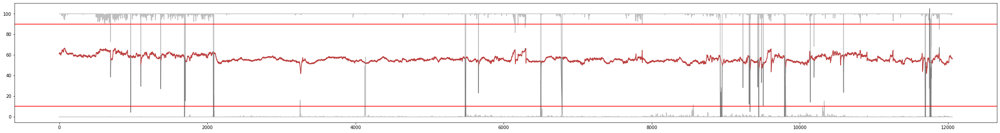

segment 0 115.1409688510073


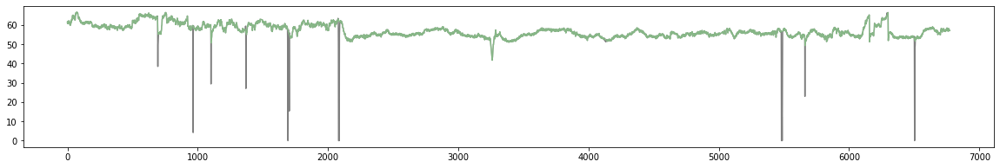

segment 1 36.14203889191231


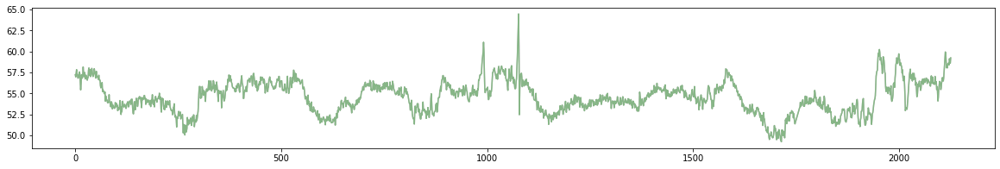

segment 2 47.5150134863602


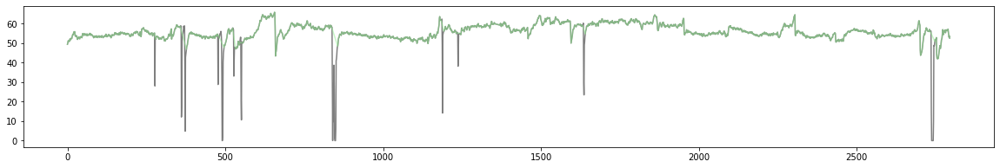

segment 3 4.7089556138237185
3 segments, 198.7980212292798 seconds total length
018 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_11_29_PSP_018_Followup/001/pupil_data']
0.9


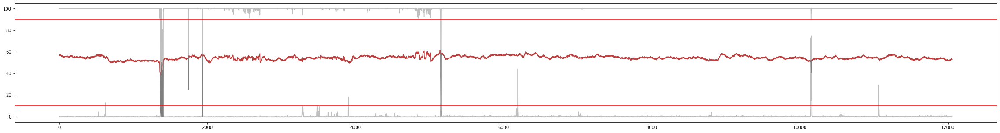

segment 0 23.204963083794155
segment 1 181.01601172799974


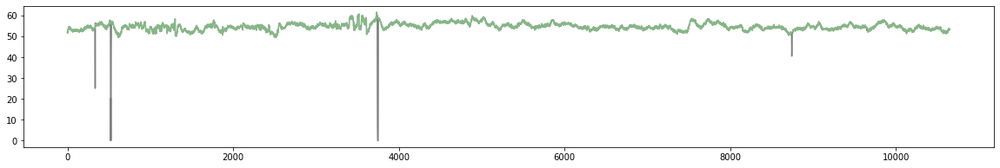

1 segments, 181.01601172799974 seconds total length
018 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_11_29_PSP_018_Followup/002/pupil_data']
0.9


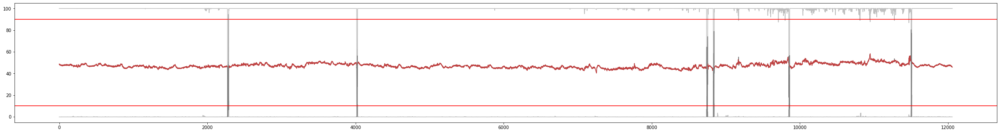

segment 0 38.59003708002183


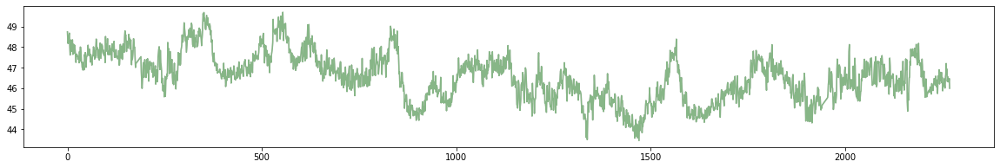

segment 1 109.58194751972133


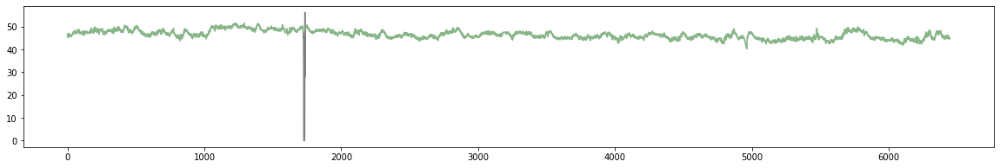

segment 2 56.06588340862527


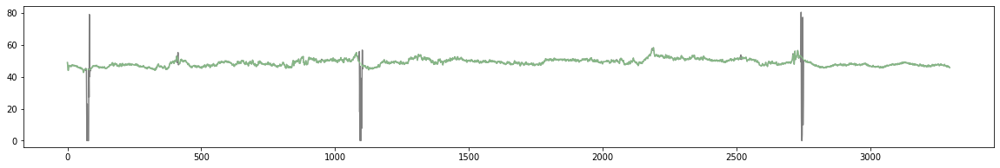

3 segments, 204.23786800836842 seconds total length
019 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_05_31_PSP_019_Baseline/000/pupil_data']
0.9


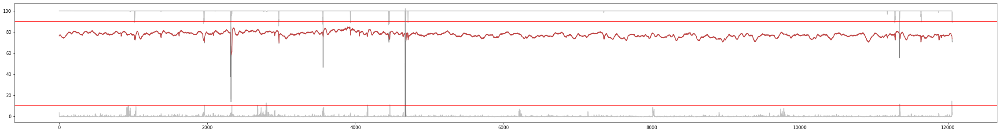

segment 0 204.96900638036823


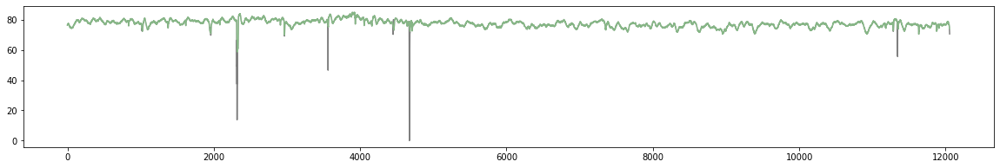

1 segments, 204.96900638036823 seconds total length
019 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_05_31_PSP_019_Baseline/001/pupil_data']
0.9


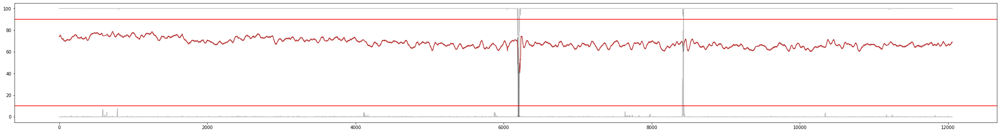

segment 0 105.11107905327162


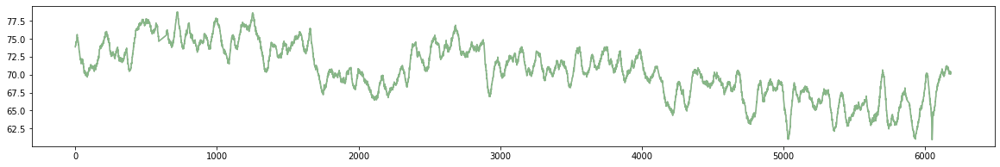

segment 1 37.24697685796082


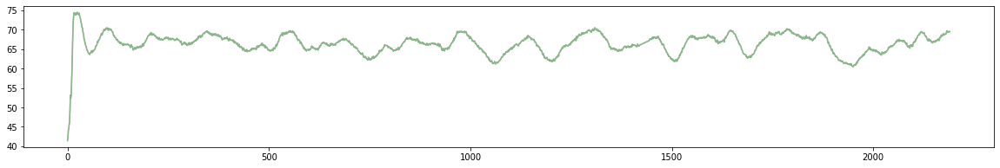

segment 2 61.607946497755165


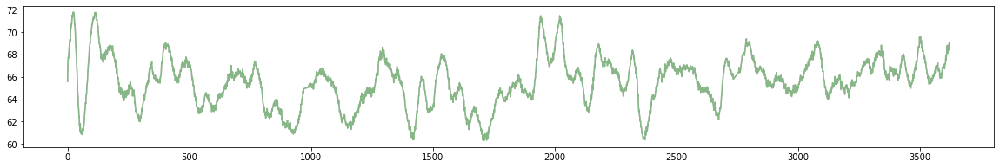

3 segments, 203.9660024089876 seconds total length
019 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_05_31_PSP_019_Baseline/002/pupil_data']
0.9


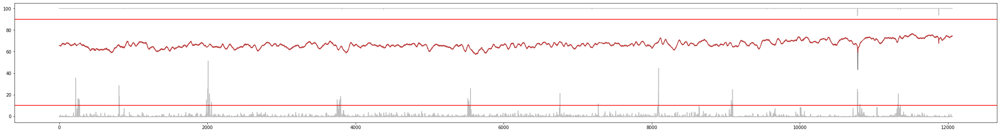

segment 0 204.96893373064722


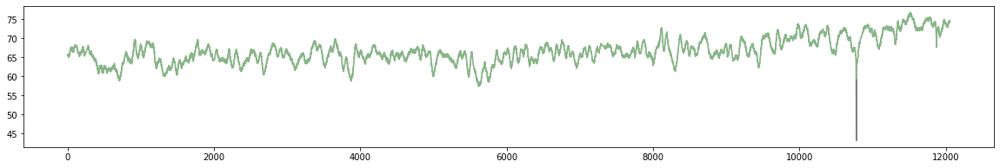

1 segments, 204.96893373064722 seconds total length
019 Followup 001
['/Volumes/psp_data/Lisa_Marc/2020_02_28_PSP_019_Followup/001/pupil_data']
0.9


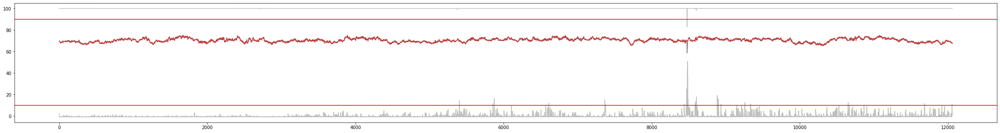

segment 0 143.93902043745038


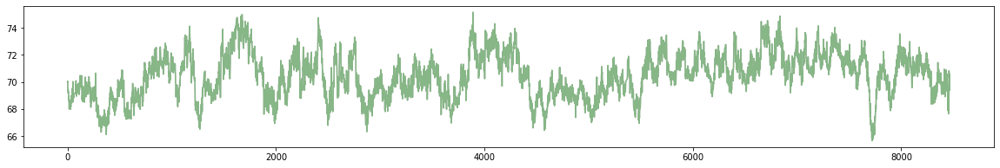

segment 1 60.62203609647804


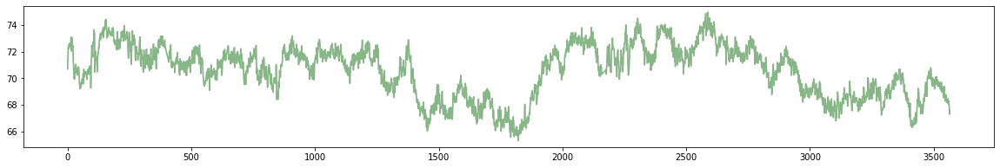

2 segments, 204.56105653392842 seconds total length
019 Followup 002
['/Volumes/psp_data/Lisa_Marc/2020_02_28_PSP_019_Followup/002/pupil_data']
0.9


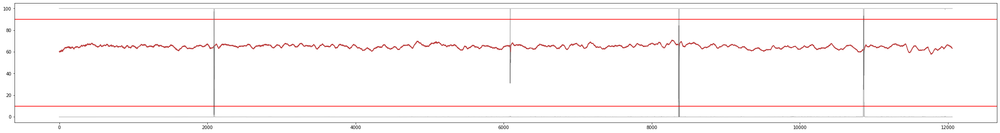

segment 0 204.96889800077952


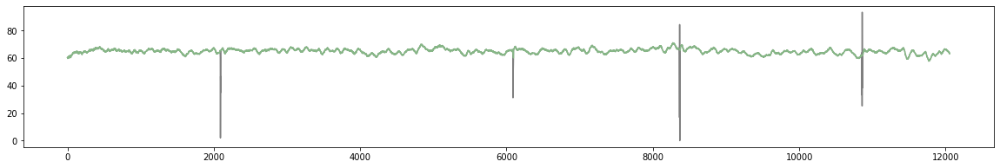

1 segments, 204.96889800077952 seconds total length
019 Followup 003
['/Volumes/psp_data/Lisa_Marc/2020_02_28_PSP_019_Followup/003/pupil_data']
0.9


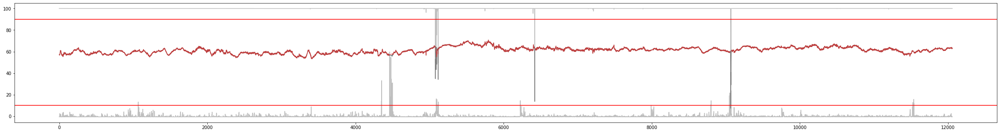

segment 0 75.78600017831195


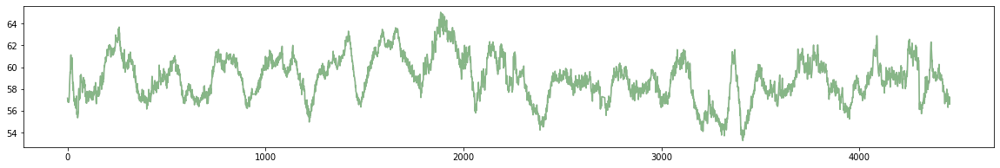

segment 1 77.28201442447244


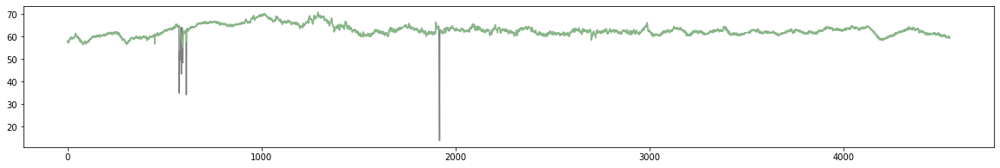

segment 2 50.67702335406648


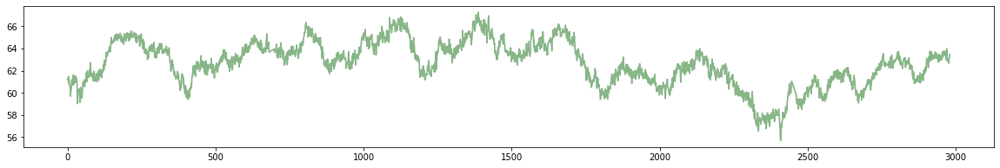

3 segments, 203.74503795685087 seconds total length
020 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_07_02_PSP_020_Baseline/000/pupil_data']
0.9


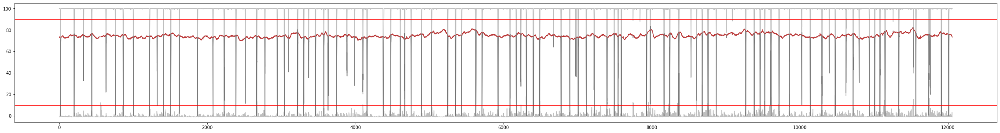

segment 0 199.5120533007473


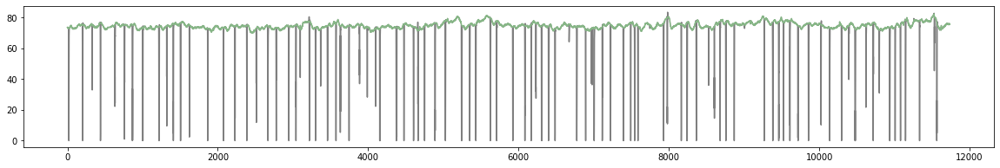

segment 1 4.980977143904511
1 segments, 199.5120533007473 seconds total length
020 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_07_02_PSP_020_Baseline/001/pupil_data']
0.9


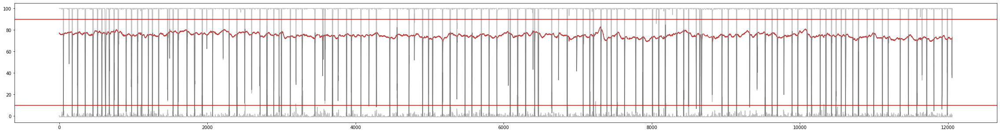

segment 0 10.455232314125055
segment 1 136.0849381802475


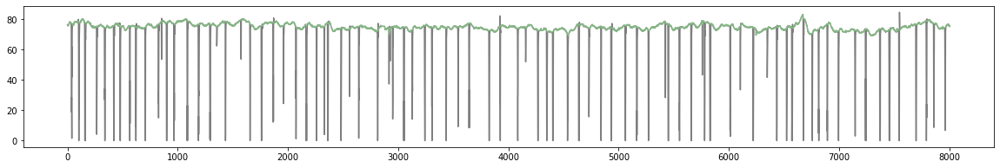

segment 2 57.42576205959426


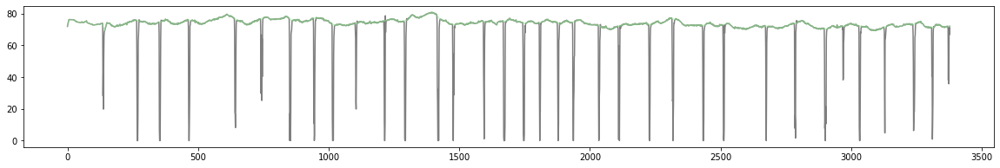

2 segments, 193.51070023984175 seconds total length
020 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_07_02_PSP_020_Baseline/002/pupil_data']
0.9


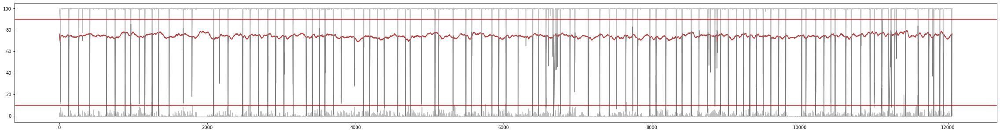

segment 0 113.25417227633943


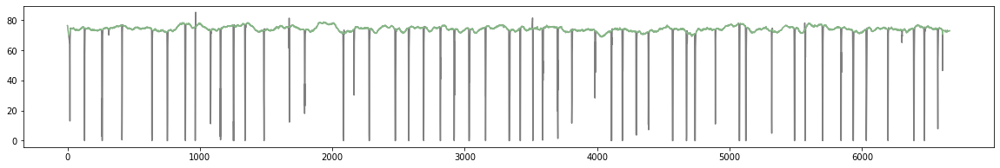

segment 1 34.81602978085334


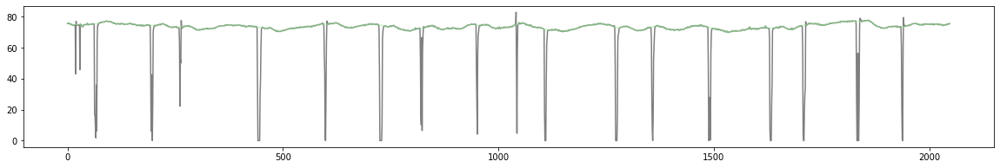

segment 2 41.190924301219866


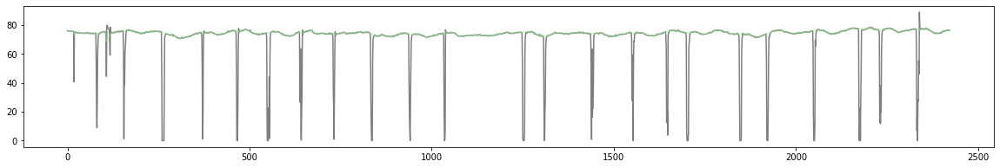

segment 3 9.401155203095414
segment 4 4.114031584372242
3 segments, 189.26112635841264 seconds total length
020 Followup 000
['/Volumes/psp_data/Lisa_Marc/2019_12_06_PSP_020_Followup/000/pupil_data']
0.9


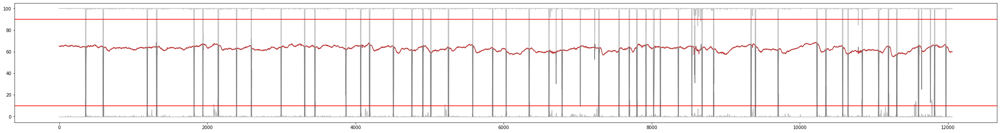

segment 0 147.1860047318089


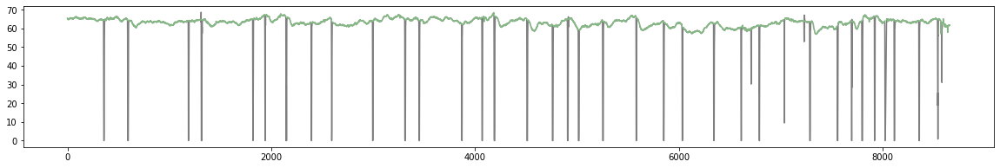

segment 1 57.29002985041916


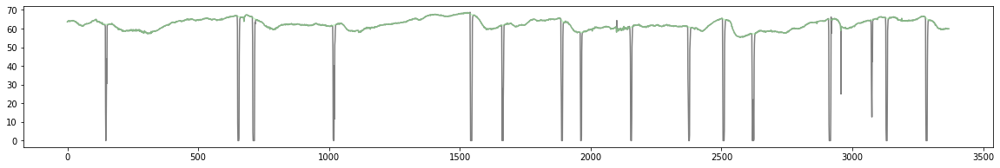

2 segments, 204.47603458222807 seconds total length
020 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_12_06_PSP_020_Followup/001/pupil_data']
0.9


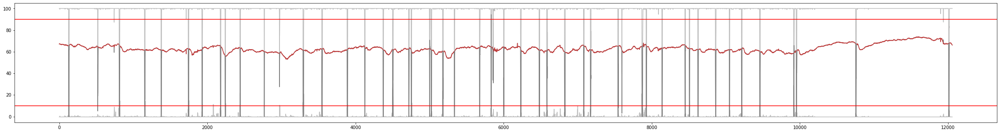

segment 0 133.6540212948821


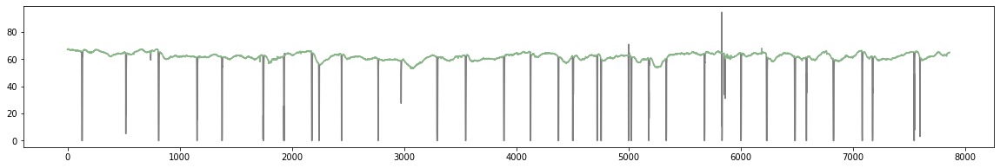

segment 1 70.95797631705909


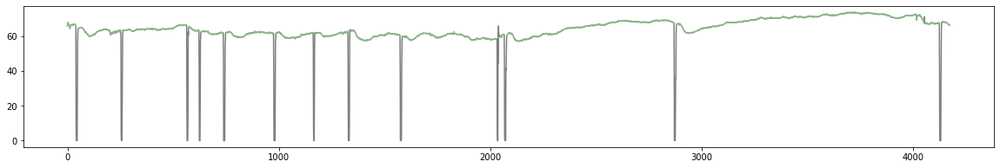

2 segments, 204.6119976119412 seconds total length
020 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_12_06_PSP_020_Followup/002/pupil_data']
0.9


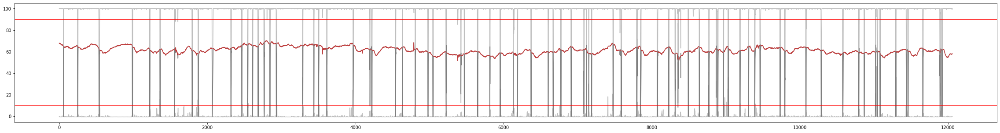

segment 0 35.02006792310317


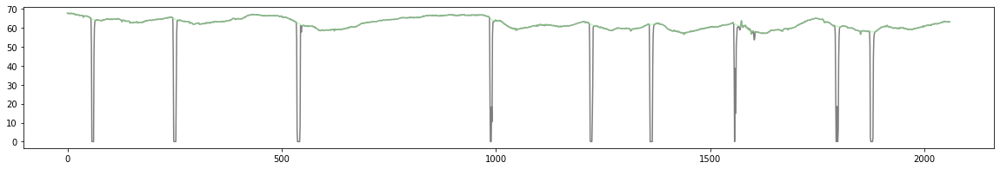

segment 1 93.26214719689051


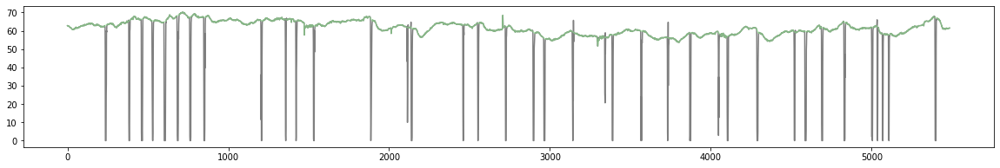

segment 2 21.590133029044182
segment 3 35.98910148189452


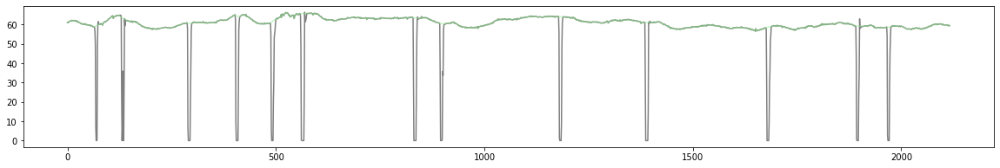

segment 4 6.392090952041826
segment 5 10.030038281470524
3 segments, 164.2713166018882 seconds total length
021 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_06_26_PSP_021_Baseline/001/pupil_data']
0.9


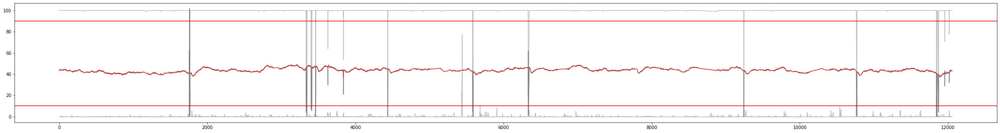

segment 0 201.26287758591496


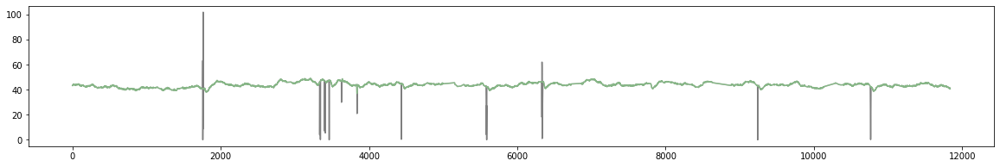

segment 1 3.077111524660154
1 segments, 201.26287758591496 seconds total length
021 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_06_26_PSP_021_Baseline/002/pupil_data']
0.9


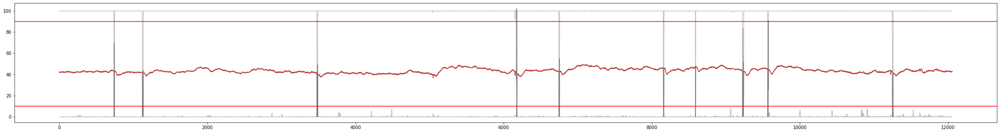

segment 0 156.75700855003413


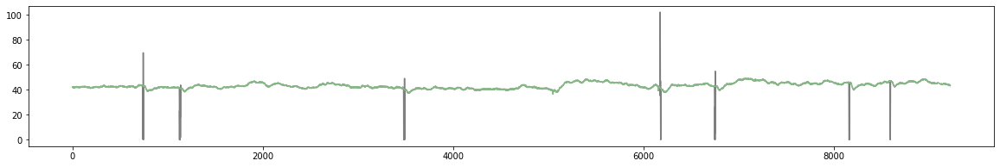

segment 1 47.80404052324286


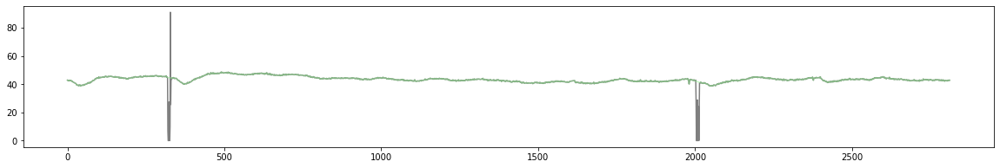

2 segments, 204.561049073277 seconds total length
021 Baseline 003
['/Volumes/psp_data/Lisa_Marc/2019_06_26_PSP_021_Baseline/003/pupil_data']
0.9


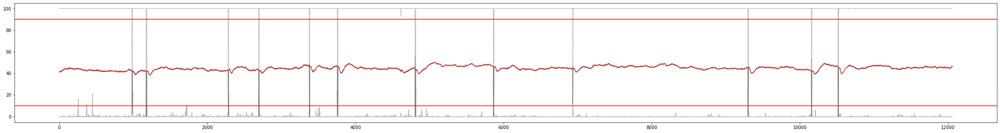

segment 0 204.96928426509226


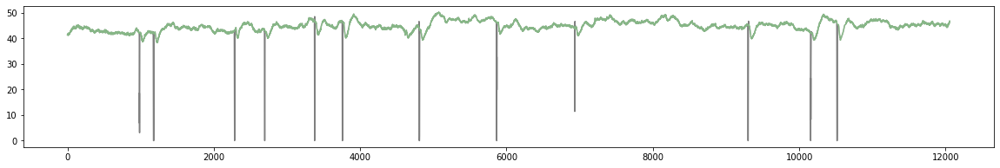

1 segments, 204.96928426509226 seconds total length
023 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_10_11_PSP_023_Baseline/000/pupil_data']
0.9


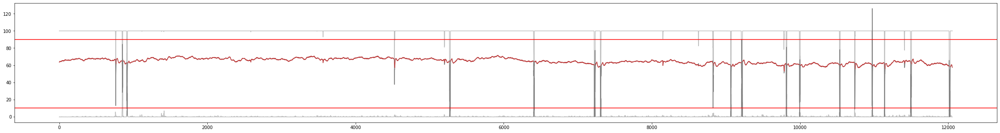

segment 0 156.50201289755296


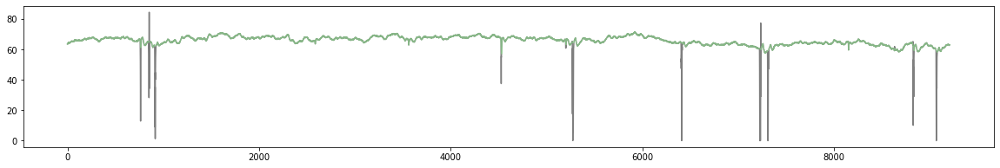

segment 1 48.1099887091259


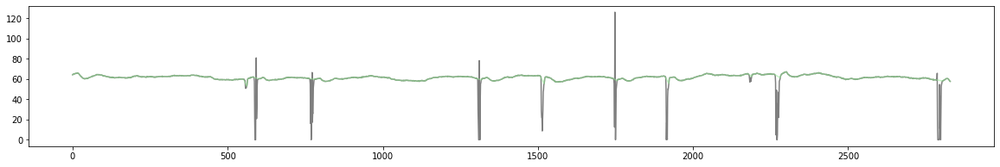

2 segments, 204.61200160667886 seconds total length
023 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_10_11_PSP_023_Baseline/001/pupil_data']
0.9


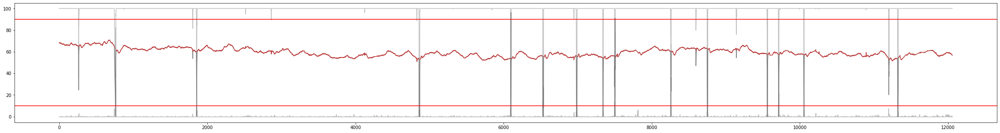

segment 0 12.631249190564631
segment 1 191.86222153794643


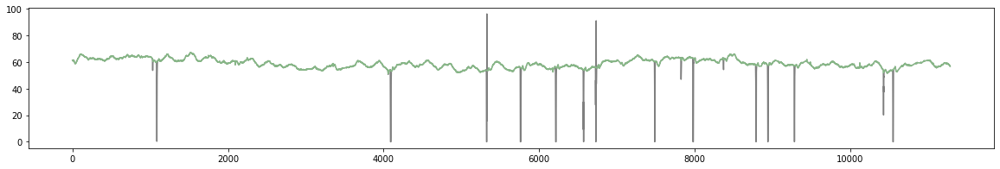

1 segments, 191.86222153794643 seconds total length
023 Baseline 003
['/Volumes/psp_data/Lisa_Marc/2019_10_11_PSP_023_Baseline/003/pupil_data']
0.9


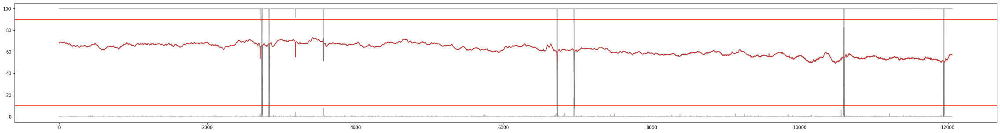

segment 0 204.96903442155963


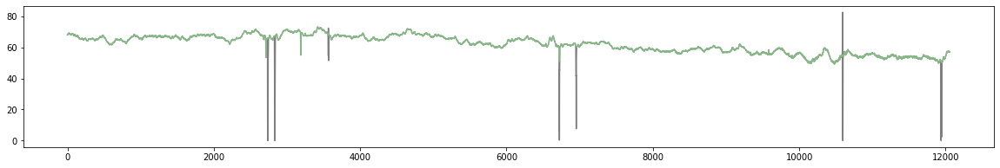

1 segments, 204.96903442155963 seconds total length
025 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2020_03_10_PSP_025_Baseline/000/pupil_data']
0.9


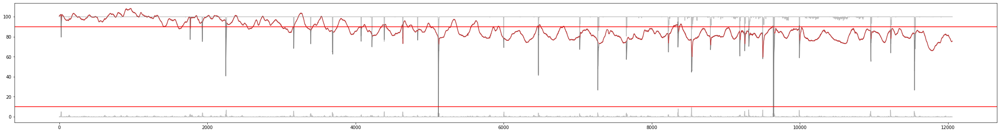

segment 0 163.8120140406172


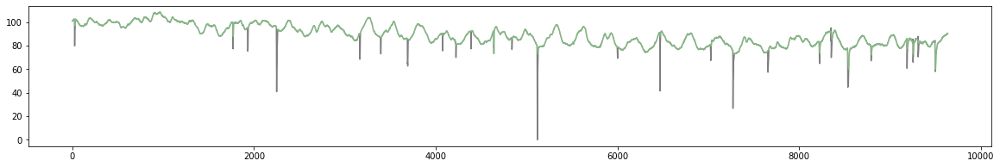

segment 1 40.749061310147226


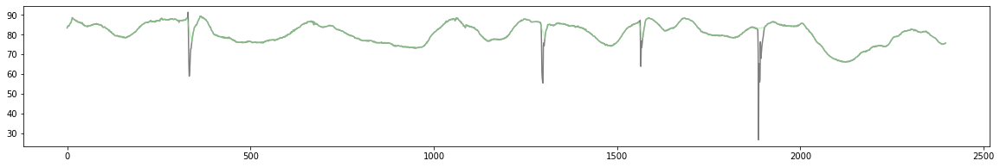

2 segments, 204.56107535076444 seconds total length
025 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2020_03_10_PSP_025_Baseline/001/pupil_data']
0.9


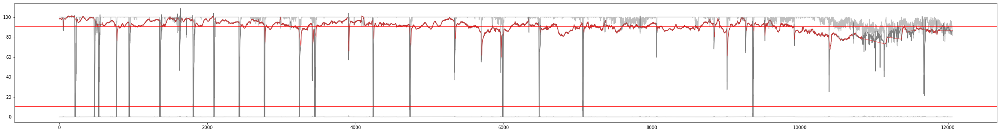

segment 0 3.5359761941563193
segment 1 3.9610304365596676
segment 2 0.18699693491907965
segment 3 6.442977900846017
segment 4 6.629999435685022
segment 5 3.417102753486688
segment 6 2.787966390089423
segment 7 4.164981141837416
segment 8 5.28700638477676
segment 9 13.277006733293092
segment 10 3.110979305449291
segment 11 21.42003231412491
segment 12 29.325026949405583


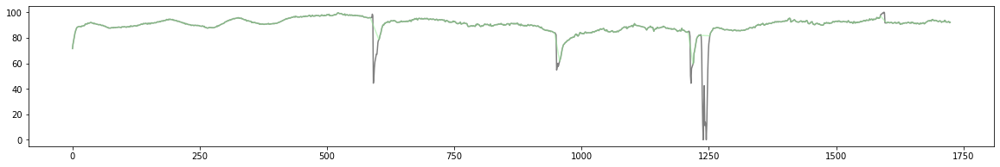

segment 13 18.411126454553596
segment 14 3.688992130017141
segment 15 44.96495300135393


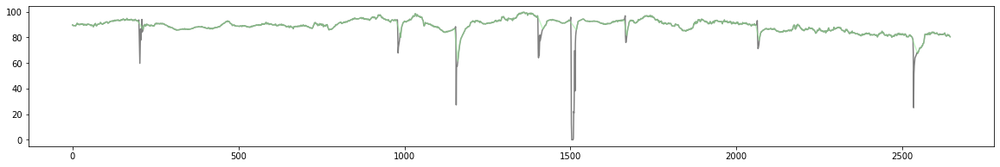

segment 16 0.16994898075608944
segment 17 2.7709255857771495
segment 18 0.5100489356918843
segment 19 0.6289695117829979
segment 20 1.0879435283368366
segment 21 2.0400539493002725
segment 22 3.043022753958212
segment 23 0.0
2 segments, 74.28997995075952 seconds total length
025 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2020_03_10_PSP_025_Baseline/002/pupil_data']
0.9


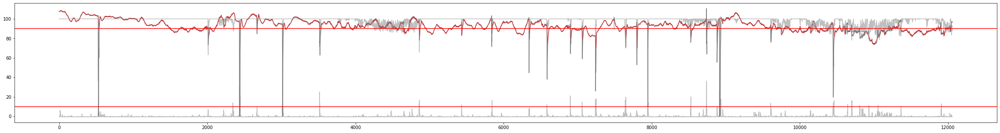

segment 0 59.6870017805104


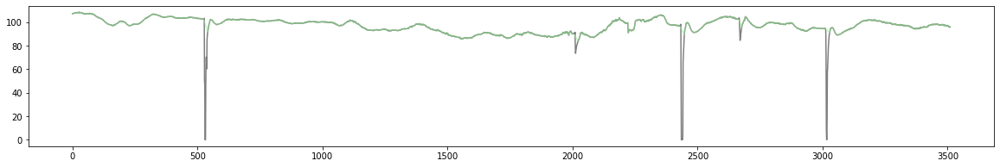

segment 1 12.546046219204072
segment 2 0.2889483883391222
segment 3 1.9549963543649937
segment 4 0.7479502344976936
segment 5 2.1590523804443364
segment 6 69.8019152508623


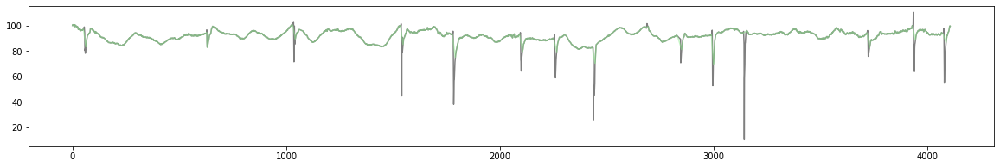

segment 7 13.685051939077312
segment 8 6.8850576683544205
segment 9 2.7029985275676154
segment 10 0.3569910912610794
segment 11 1.9040950484068162
segment 12 0.1870074368907808
segment 13 0.39054341256269254
segment 14 0.2720437233128905
segment 15 0.8838399221858708
segment 16 1.0029607625237986
segment 17 1.7339929292411398
segment 18 10.149008193870031
segment 19 0.4929843203171913
2 segments, 129.4889170313727 seconds total length
026 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2020_04_30_PSP_026_Baseline/000/pupil_data']
0.9


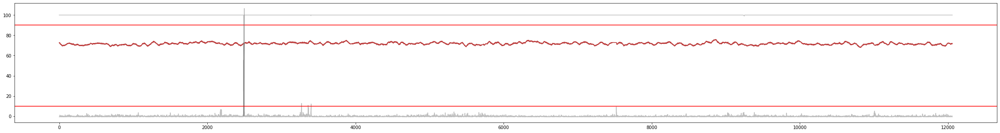

segment 0 204.96890088824875


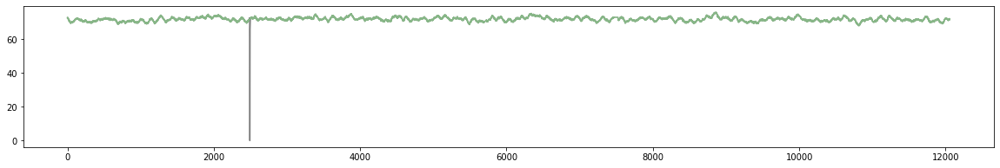

1 segments, 204.96890088824875 seconds total length
026 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2020_04_30_PSP_026_Baseline/001/pupil_data']
Confidence equal in both eyes
0.9


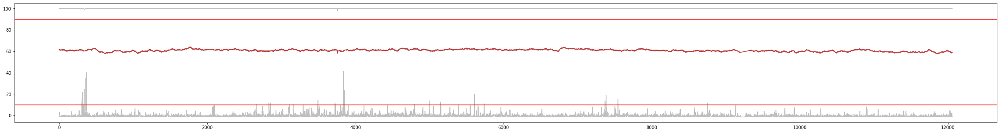

segment 0 65.12698519218247


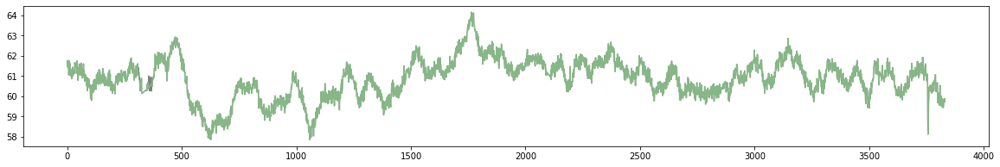

segment 1 139.40008863598632


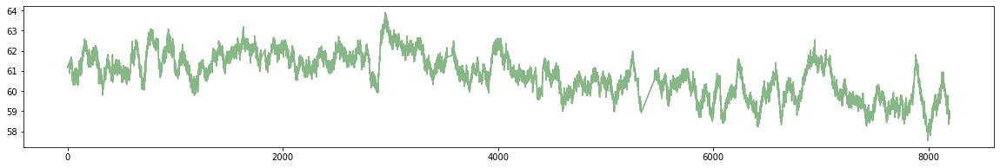

2 segments, 204.5270738281688 seconds total length
026 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2020_04_30_PSP_026_Baseline/002/pupil_data']
0.9


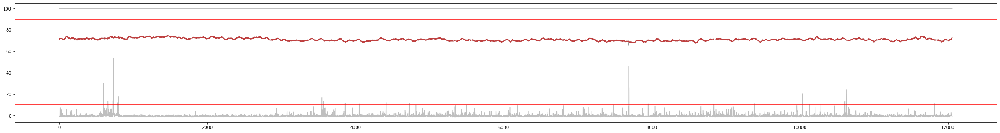

segment 0 204.96899044324527


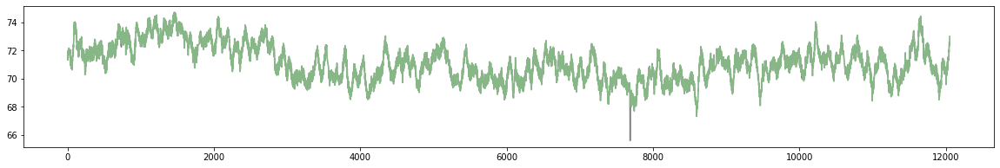

1 segments, 204.96899044324527 seconds total length
003 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2018_05_31_PSP_003_Baseline/000/pupil_data']
0.9


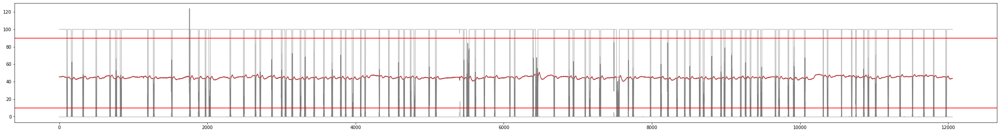

segment 0 2.7200234311985696
segment 1 9.775006898000015
segment 2 0.6972487011512385
segment 3 19.958052948519594
segment 4 17.01691905217683
segment 5 4.079914545183897
segment 6 10.573962209502497
segment 7 13.803986623646892
segment 8 11.695996238176349
segment 9 15.147043249168746
segment 10 7.922015738661912
segment 11 3.3660257526614714
segment 12 1.971974196044357
segment 13 3.5020105876865273
segment 14 2.9240830371470565
segment 15 6.051899702073342
segment 16 1.241011430698336
segment 17 7.820054234706049
segment 18 1.496147053397408
segment 19 2.5499826420073077
segment 20 8.041014218340251
segment 21 3.6720387547866267
segment 22 3.060047666124774
segment 23 16.711074344801773
segment 24 19.09089348560269
0 segments, 0 seconds total length
003 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2018_05_31_PSP_003_Baseline/001/pupil_data']
0.9


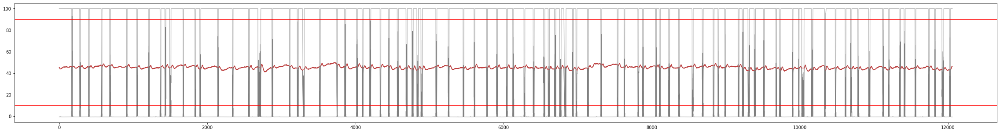

segment 0 25.296008411390176


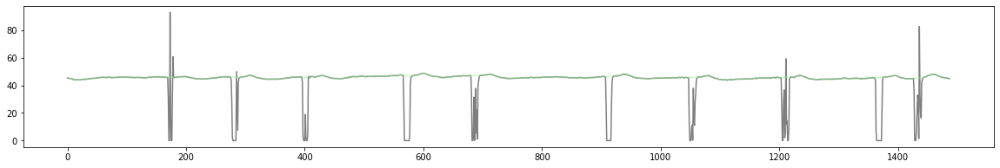

segment 1 19.821945176948702
segment 2 8.279006616955712
segment 3 0.8670601005073877
segment 4 11.900019970727953
segment 5 2.635028467669372
segment 6 5.966958757338261
segment 7 1.6490122944214818
segment 8 0.9689906157725545
segment 9 0.7310226283530028
segment 10 0.4930034742424141
segment 11 27.744018717477957


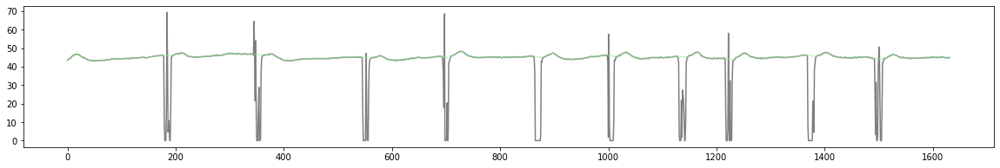

segment 12 0.6630038874677666
segment 13 1.0540100037546836
segment 14 0.7479903817377362
segment 15 0.5610552396178718
segment 16 21.301015866698663
segment 17 18.700043748722692
segment 18 0.9180379635886311
segment 19 0.9689677542280606
segment 20 5.372011943331472
segment 21 4.708978147500375
segment 22 1.580993002970672
segment 23 8.551034227272112
segment 24 3.7739807522939373
segment 25 2.804968551051843
segment 26 3.433977037238037
segment 27 0.7140763503086873
segment 28 6.6469687975147735
segment 29 1.3430447161767916
segment 30 1.1900059192792014
segment 31 0.3229992766612213
2 segments, 53.04002712886813 seconds total length
003 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2018_05_31_PSP_003_Baseline/002/pupil_data']
0.9


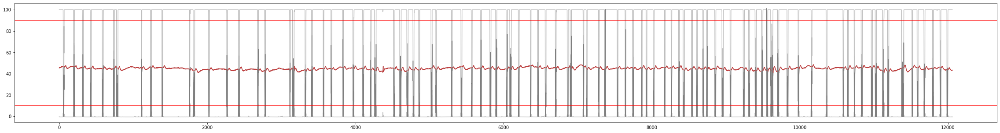

segment 0 13.107053779838225
segment 1 17.153023276477825
segment 2 22.355053508558512
segment 3 18.377027144948215
segment 4 3.910051302958209
segment 5 1.0030124568897918
segment 6 1.1900201215587458
segment 7 1.0029947668517707
segment 8 3.791062954823701
segment 9 10.965027597389508
segment 10 1.8189745843039873
segment 11 0.9689913700149191
segment 12 2.039953136762051
segment 13 0.45902967951428764
segment 14 13.430012290176819
segment 15 7.480054747007443
segment 16 17.646049855253978
segment 17 2.618028967963255
segment 18 1.920970807919275
segment 19 3.2300619057646145
segment 20 4.470995460759923
segment 21 0.8670118473683033
segment 22 1.1389292095734618
segment 23 1.037047487676773
segment 24 0.7480242706765239
segment 25 0.5780181652060037
segment 26 0.9690425161397798
segment 27 1.7850101793162594
segment 28 16.659926361264525
segment 29 1.9209716455955004
segment 30 0.5440323875068316
segment 31 1.2410073035366622
segment 32 0.7140433699858022
segment 33 2.80496457893355

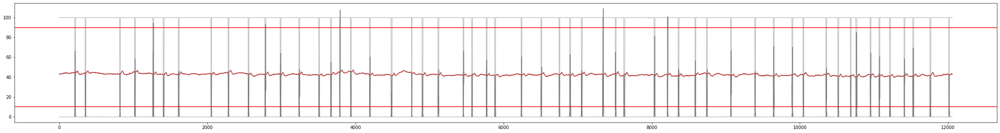

segment 0 129.5229652687425


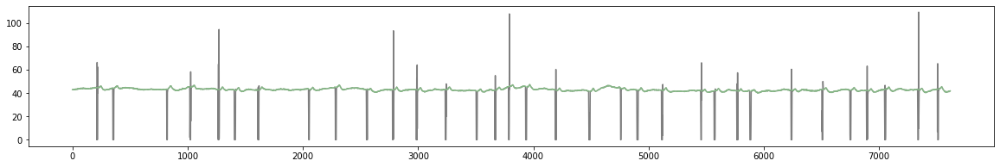

segment 1 52.90410002637509


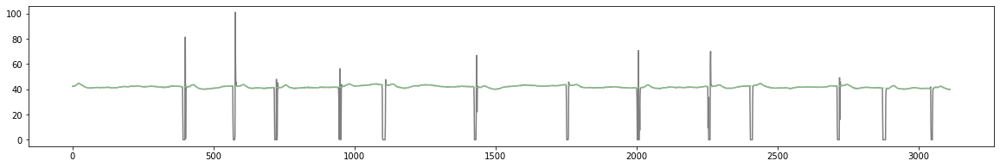

segment 2 21.82803115235265
2 segments, 182.4270652951176 seconds total length
003 Followup 001
['/Volumes/psp_data/Lisa_Marc/2018_11_28_PSP_003_Followup/001/pupil_data']
0.9


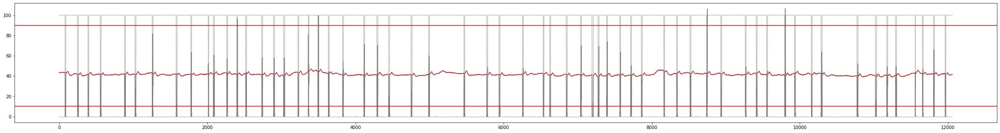

segment 0 51.44202509664774


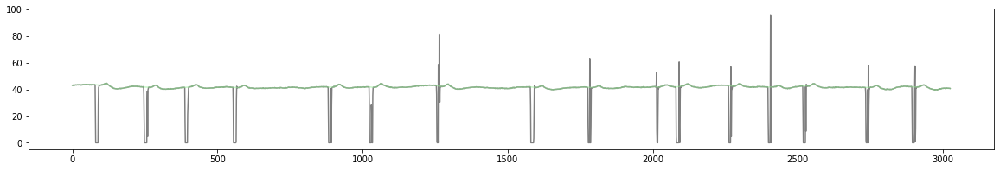

segment 1 23.73198772221349
segment 2 4.793934916353237
segment 3 31.44990767324998


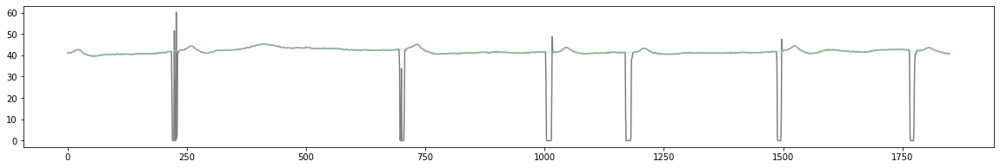

segment 4 9.350003002951553
segment 5 0.9860464825299005
segment 6 59.07507176861782


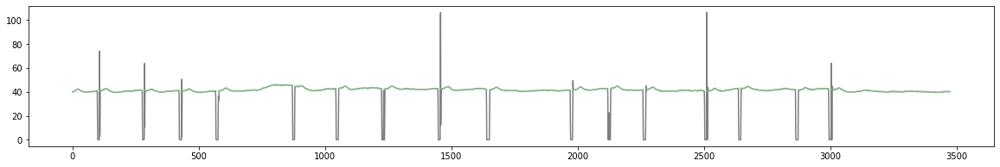

segment 7 3.8930054198897324
segment 8 17.30601182366695
3 segments, 141.96700453851554 seconds total length
003 Followup 002
['/Volumes/psp_data/Lisa_Marc/2018_11_28_PSP_003_Followup/002/pupil_data']
0.9


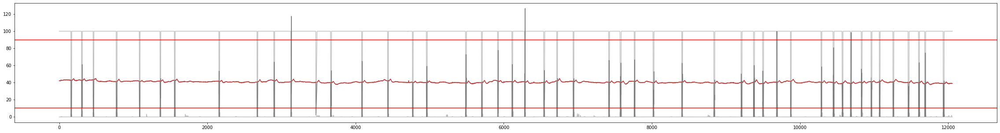

segment 0 58.83694465883809


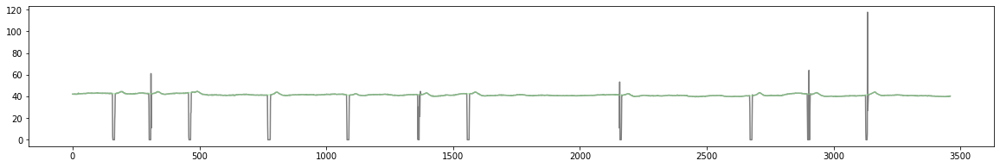

segment 1 69.46202097554351


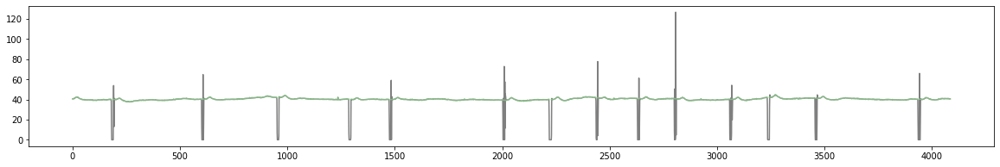

segment 2 75.93899172873535


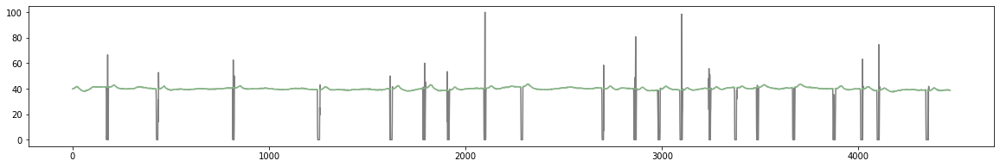

3 segments, 204.23795736311695 seconds total length
006 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2018_10_24_PSP_006_Baseline/000/pupil_data']
0.9


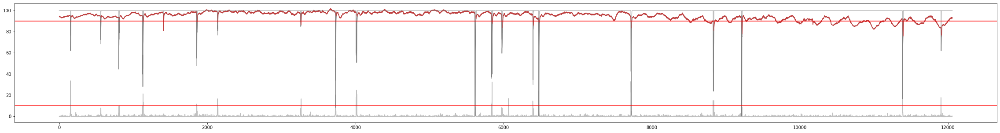

segment 0 204.96897687853743


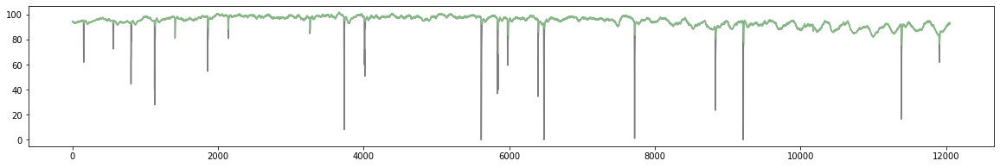

1 segments, 204.96897687853743 seconds total length
006 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2018_10_24_PSP_006_Baseline/001/pupil_data']
0.9


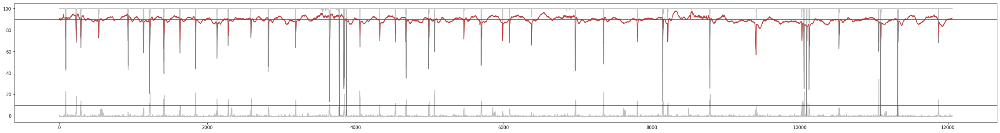

segment 0 204.9689972099709


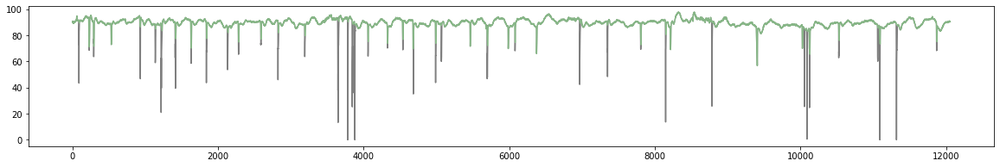

1 segments, 204.9689972099709 seconds total length
006 Baseline 004
['/Volumes/psp_data/Lisa_Marc/2018_10_24_PSP_006_Baseline/004/pupil_data']
0.9


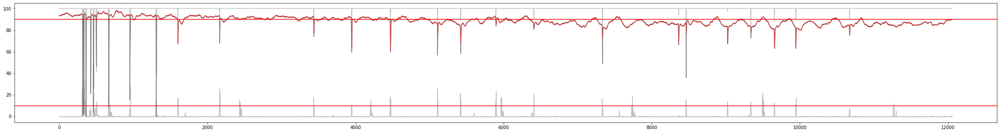

segment 0 5.202003609308122
segment 1 199.12098045516268


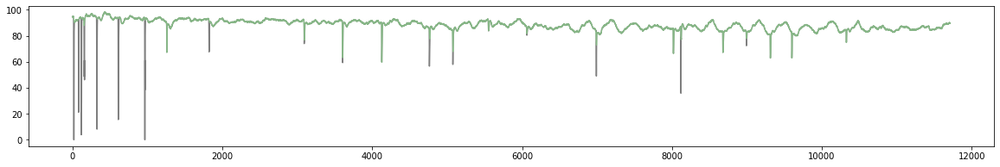

1 segments, 199.12098045516268 seconds total length
006 Followup 000
['/Volumes/psp_data/Lisa_Marc/2019_06_12_PSP_006_Followup/000/pupil_data']
Confidence equal in both eyes
0.9


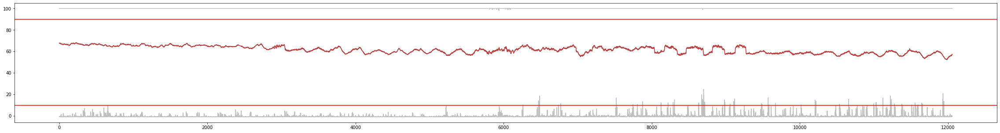

segment 0 204.96898783141887


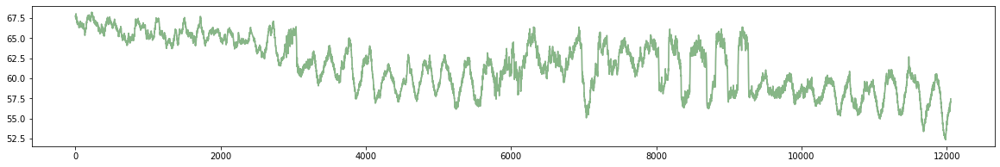

1 segments, 204.96898783141887 seconds total length
006 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_06_12_PSP_006_Followup/001/pupil_data']
0.9


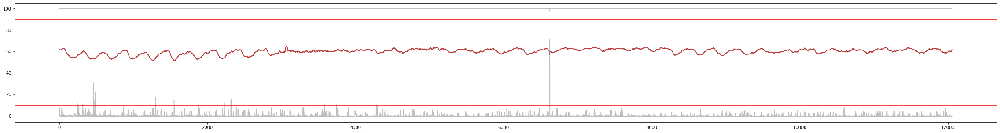

segment 0 204.96898653878998


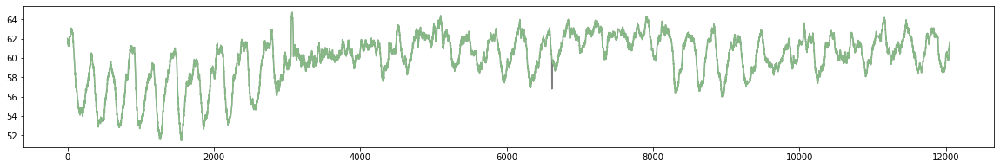

1 segments, 204.96898653878998 seconds total length
006 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_06_12_PSP_006_Followup/002/pupil_data']
Confidence equal in both eyes
0.9


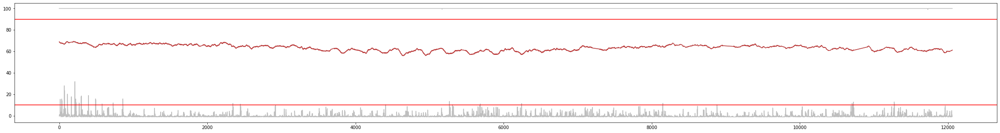

segment 0 204.96921437201445


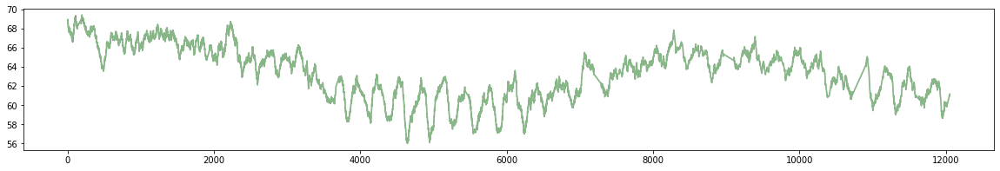

1 segments, 204.96921437201445 seconds total length
009 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_01_10_PSP_009_Baseline/000/pupil_data']
0.9


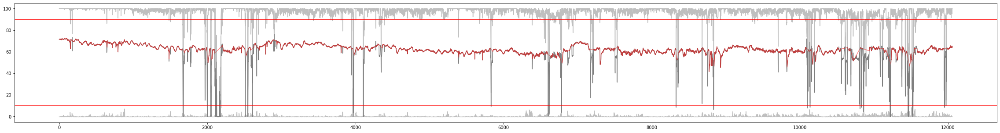

segment 0 28.287961429799225


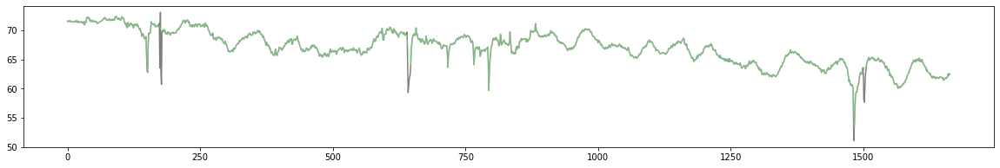

segment 1 6.901967406470703
segment 2 6.459979362029571
segment 3 4.488058257188641
segment 4 20.076987090840703
segment 5 3.281039503683587
segment 6 24.85402642019858


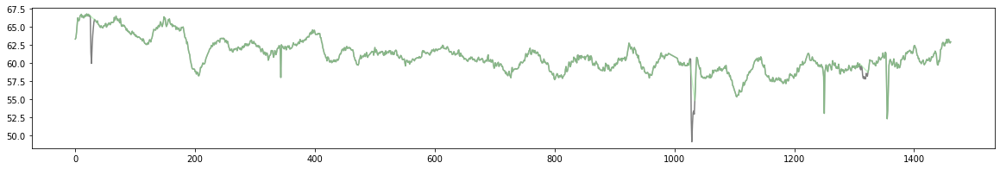

segment 7 11.679070850852895
segment 8 0.5099927433016092
segment 9 0.4419975974922181
segment 10 0.8669740762206857
segment 11 1.3089645318432304
segment 12 0.4759468673385072
segment 13 3.791034540999817
segment 14 4.862000593412176
segment 15 43.128998602205456


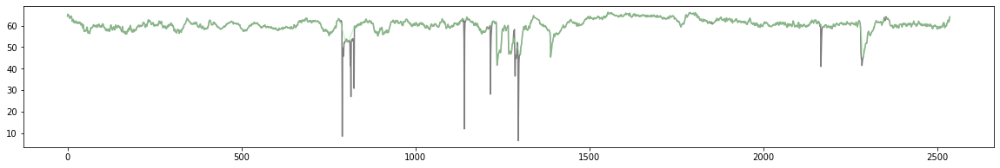

segment 16 7.360931240941227
segment 17 0.7140293691620627
segment 18 0.2379351666909315
segment 19 0.16994027996338446
segment 20 2.3969870279477163
segment 21 0.5440293868525714
segment 22 1.0879500116618601
segment 23 2.176007723941666
segment 24 0.5099907554260881
segment 25 0.22100143674992978
segment 26 6.153983411661329
segment 27 1.2239318591764459
3 segments, 96.27098645220326 seconds total length
009 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_01_10_PSP_009_Baseline/001/pupil_data']
0.9


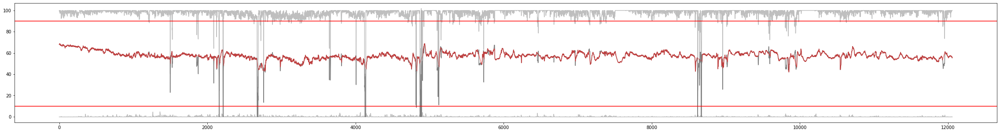

segment 0 31.501032337257357


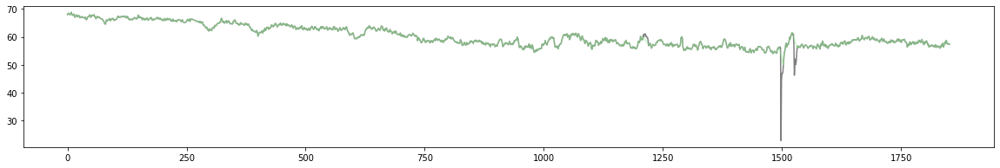

segment 1 13.3960056221772
segment 2 16.217642716948603
segment 3 7.734976029477593
segment 4 12.307855310146806
segment 5 3.2130006654413137
segment 6 0.32302030808818927
segment 7 8.3640210804042
segment 8 27.132060725029078


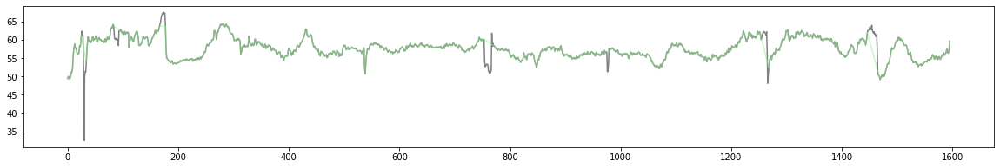

segment 9 22.014959577698164
segment 10 15.215009321021853
segment 11 3.3829971313311944
segment 12 1.6489857880073941
segment 13 33.50706022448526


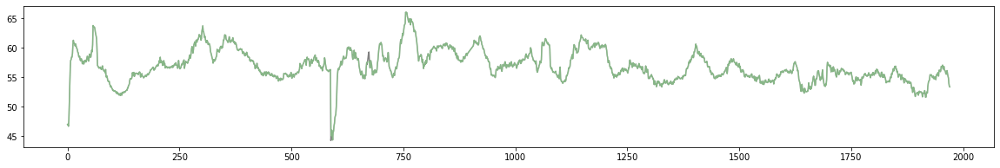

segment 14 1.6659868670146807
3 segments, 92.14015328677169 seconds total length
009 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_01_10_PSP_009_Baseline/002/pupil_data']
0.9


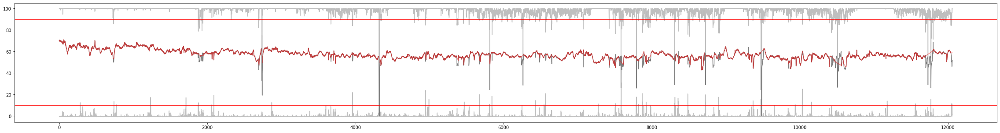

segment 0 31.85795570969117


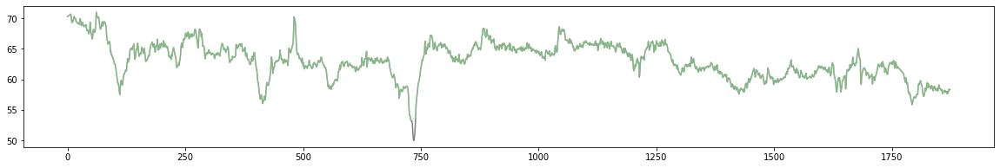

segment 1 0.20398159629462498
segment 2 58.157020620603134


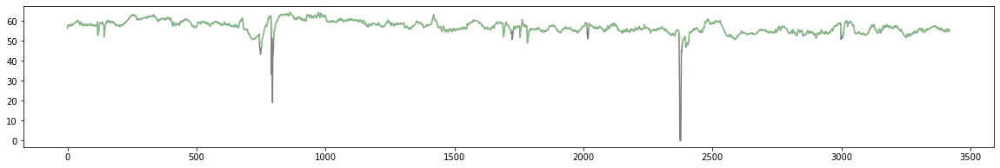

segment 3 14.415972052397137
segment 4 21.913009588779687
segment 5 4.249985851368365
segment 6 0.6290512845807825
segment 7 8.414981889968203
segment 8 5.185433659700266
segment 9 0.8669702036465878
segment 10 9.231069435823429
segment 11 15.50407754879393
segment 12 0.27201422533130426
segment 13 0.5099896735882794
segment 14 18.240945688301736
segment 15 4.369008337117748
2 segments, 90.0149763302943 seconds total length
016 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_04_25_PSP_016_Baseline/000/pupil_data']
0.9


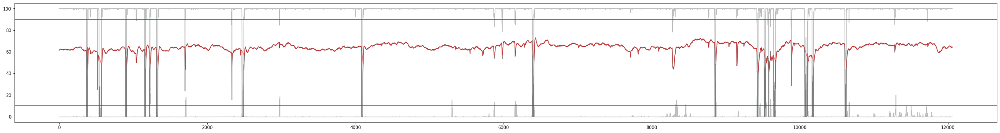

segment 0 9.077924375838165
segment 1 5.388995872066062
segment 2 4.028985960911882
segment 3 2.3290006283676803
segment 4 19.192973927022194
segment 5 26.808980913374967


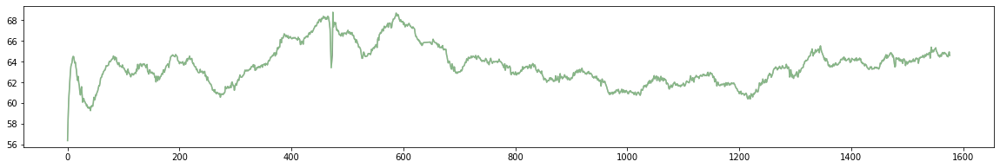

segment 6 38.725951456220514


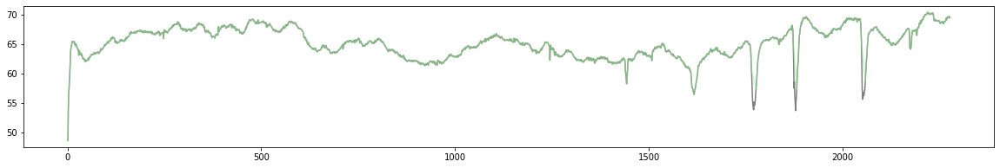

segment 7 51.06813824234848


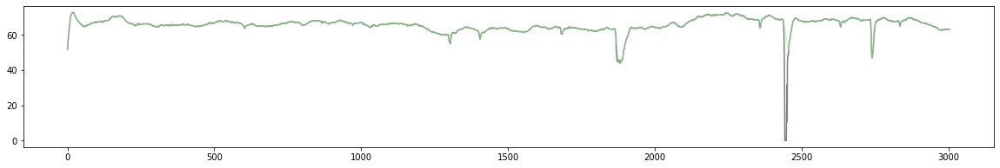

segment 8 1.258016261286798
segment 9 0.39098069590454543
segment 10 0.9860273063751492
segment 11 6.562001195374933
segment 12 0.8500208704118677
segment 13 7.038034016474512
segment 14 24.258967821279498


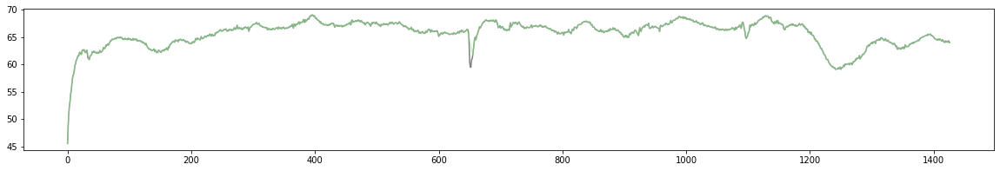

4 segments, 140.86203843322346 seconds total length
016 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_04_25_PSP_016_Baseline/001/pupil_data']
0.9


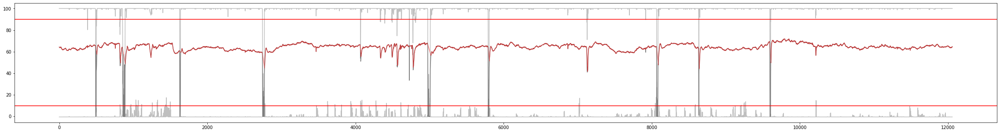

segment 0 14.484075043580788
segment 1 31.432933098735248


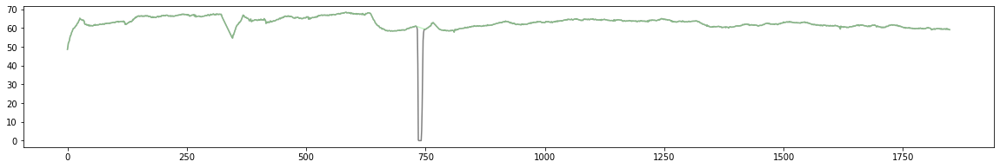

segment 2 37.40004348417642


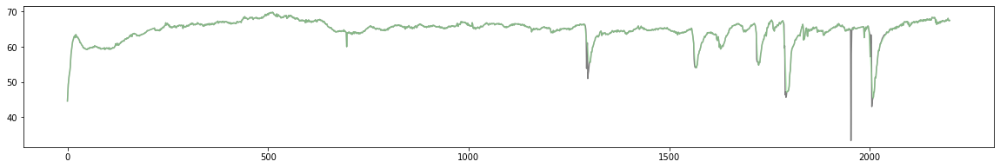

segment 3 51.747982810897156


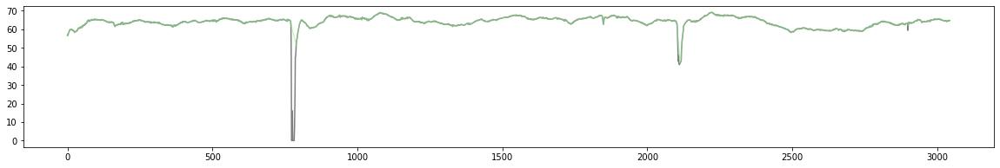

segment 4 67.47305732490463


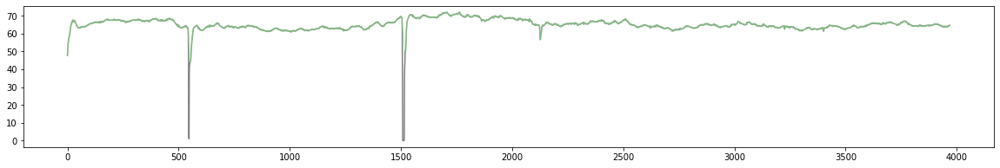

4 segments, 188.05401671871346 seconds total length
016 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_04_25_PSP_016_Baseline/002/pupil_data']
0.9


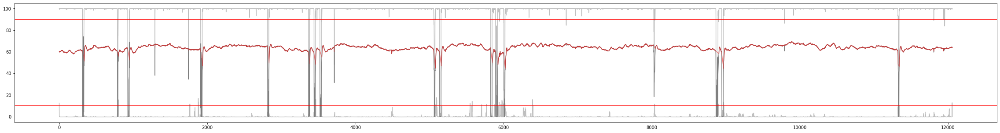

segment 0 5.3040506453530725
segment 1 9.945003288602948
segment 2 16.251996428771918
segment 3 14.9090455280666
segment 4 10.284897894107871
segment 5 0.9520033522865106
segment 6 25.653045837122363


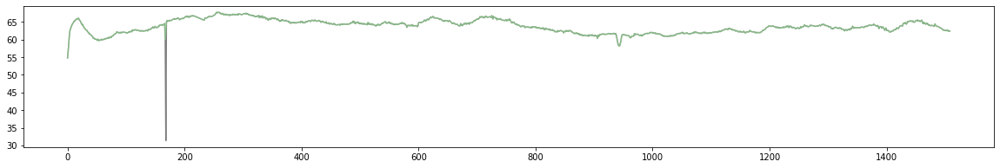

segment 7 0.935287199147524
segment 8 11.287892390882462
segment 9 0.7139487559704776
segment 10 1.308963723095303
segment 11 34.03396389659588


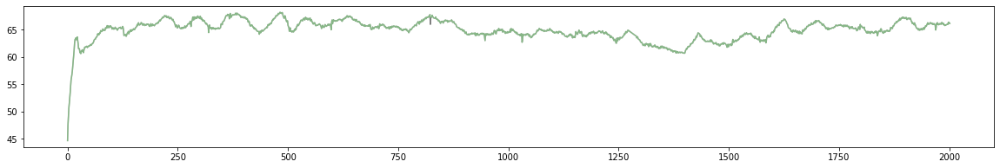

segment 12 13.8890290108086
segment 13 0.6289895976253774
segment 14 52.512986418470746


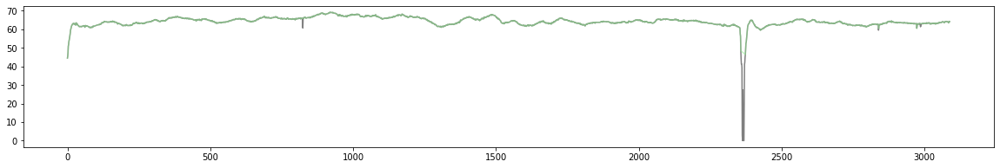

3 segments, 112.19999615218899 seconds total length
016 Followup 001
['/Volumes/psp_data/Lisa_Marc/2019_10_08_PSP_016_Followup/001/pupil_data']
0.9


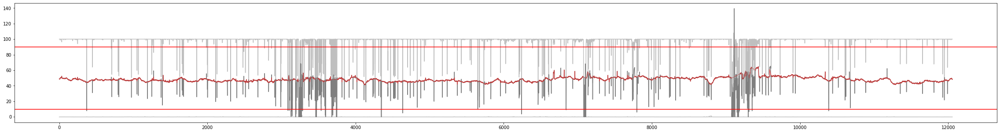

segment 0 33.76196604036045


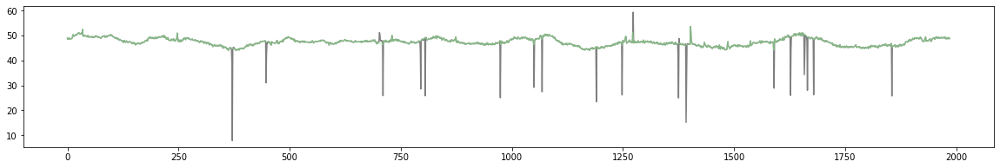

segment 1 18.98893875427939
segment 2 0.5952814079309974
segment 3 0.23809038588274234
segment 4 1.8530416765440805
segment 5 0.30604039739705513
segment 6 0.4590857332550513
segment 7 2.0400233939781174
segment 8 12.886010510610504
segment 9 43.14600462955832


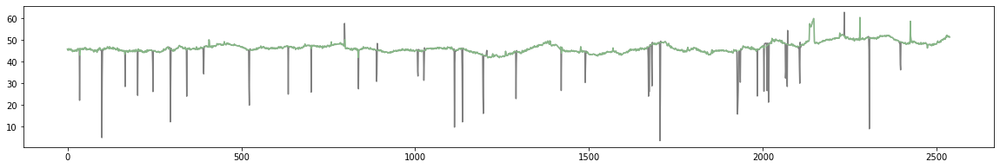

segment 10 0.3569706425023469
segment 11 9.468979161691323
segment 12 0.4079696984927068
segment 13 21.318045154941274
segment 14 1.5470444212062375
segment 15 0.4930401231324595
segment 16 3.2469842168159175
segment 17 41.56504737336786


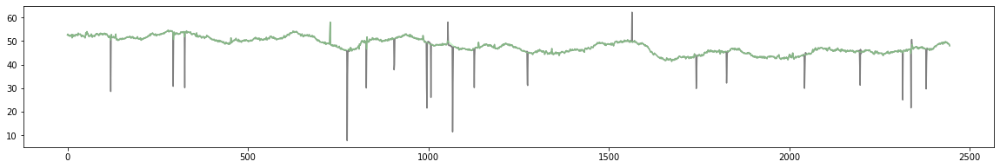

3 segments, 118.47301804328663 seconds total length
016 Followup 002
['/Volumes/psp_data/Lisa_Marc/2019_10_08_PSP_016_Followup/002/pupil_data']
0.9


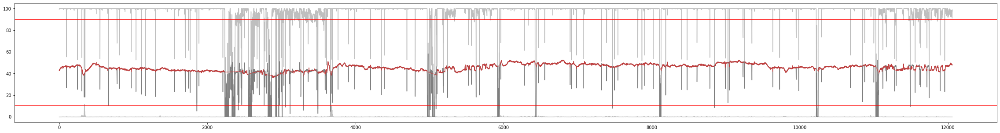

segment 0 37.960941627838565


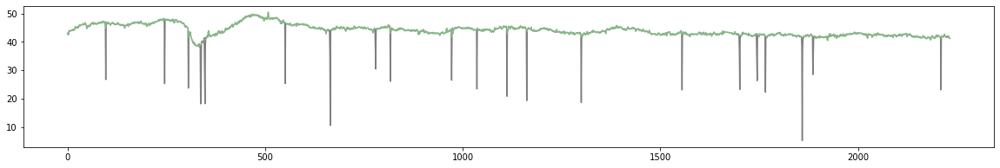

segment 1 1.3940659863897054
segment 2 0.850015903426538
segment 3 0.2719731518895969
segment 4 0.8159467030368432
segment 5 0.30597262828723615
segment 6 0.23806107033828994
segment 7 1.274995629382829
segment 8 1.1899719124855892
segment 9 1.275043280183354
segment 10 0.30598932999282624
segment 11 0.32299598280155806
segment 12 0.9689703548601756
segment 13 23.32401474700032
segment 14 13.821056359750173
segment 15 8.058038959831038
segment 16 28.1689989763604


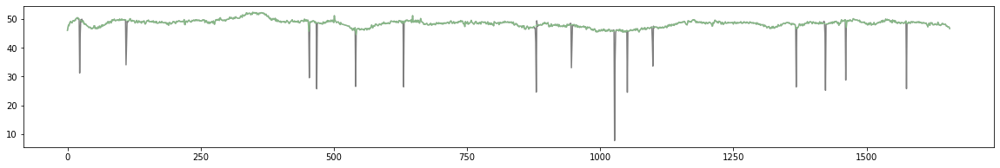

segment 17 35.51301265402208


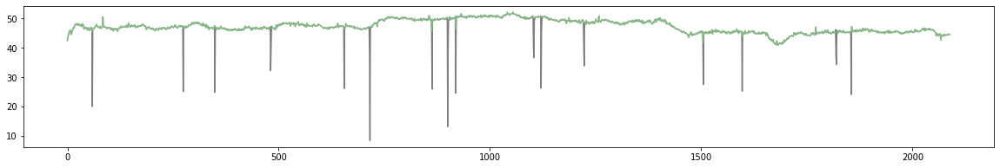

segment 18 13.123856761764046
segment 19 1.4449800148302074
segment 20 1.7680056658455214
segment 21 2.805080688492353
segment 22 0.3229098360586704
segment 23 0.9690514071544385
segment 24 1.2410690093631729
segment 25 5.252967734117874
3 segments, 101.64295325822104 seconds total length
016 Followup 003
['/Volumes/psp_data/Lisa_Marc/2019_10_08_PSP_016_Followup/003/pupil_data']
0.9


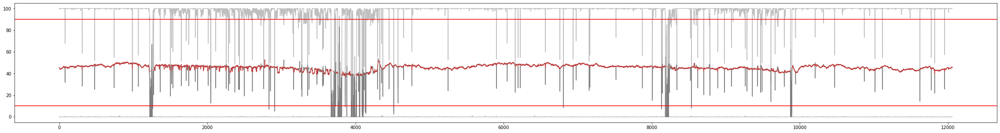

segment 0 20.68908842641281
segment 1 33.06505069003674


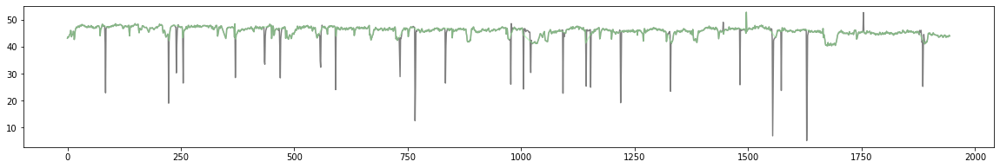

segment 2 0.8330539921323634
segment 3 0.20392690144853987
segment 4 2.193001802426352
segment 5 2.2950137923055536
segment 6 0.3569926369780205
segment 7 2.0400162516300497
segment 8 0.32301057449308246
segment 9 0.3740380959409322
segment 10 0.18702181987487165
segment 11 0.8840494966759707
segment 12 66.8100313337502


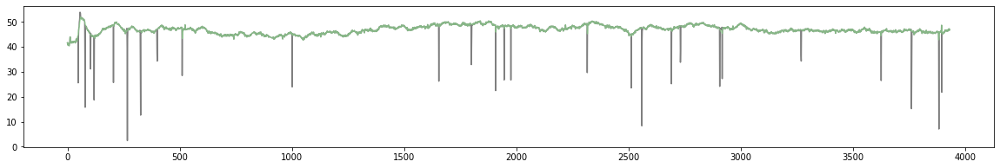

segment 13 4.1990158003482065
segment 14 15.724919857345867
segment 15 6.443034707147035
segment 16 36.75405414194847


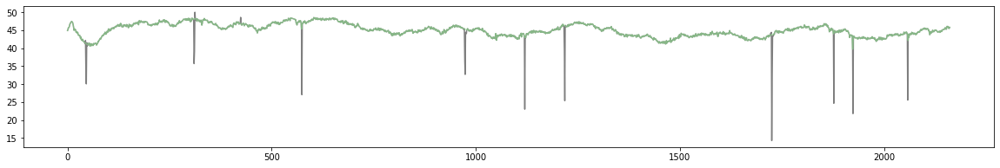

3 segments, 136.62913616573542 seconds total length
022 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2019_07_31_PSP_022_Baseline/000/pupil_data']
0.9


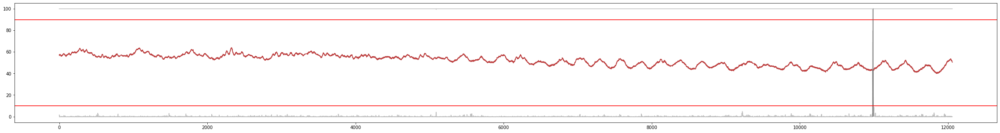

segment 0 204.9690975021033


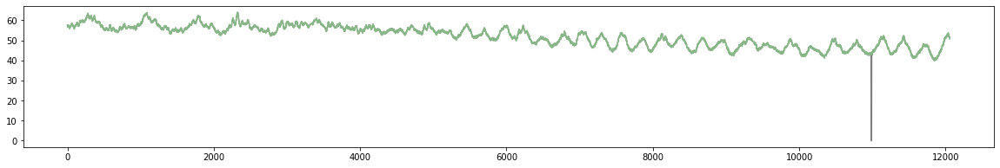

1 segments, 204.9690975021033 seconds total length
022 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2019_07_31_PSP_022_Baseline/001/pupil_data']
0.9


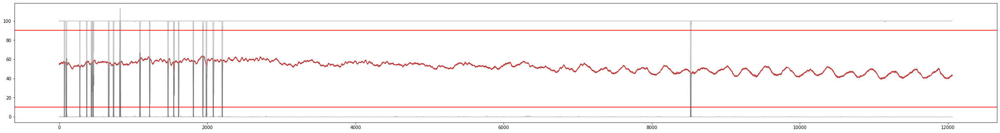

segment 0 7.293168643917397
segment 1 5.796774154843206
segment 2 190.82537240206557


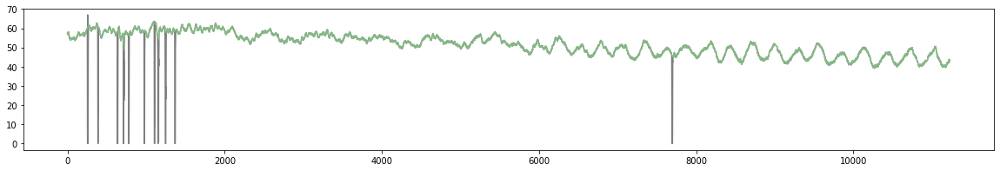

1 segments, 190.82537240206557 seconds total length
022 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2019_07_31_PSP_022_Baseline/002/pupil_data']
0.9


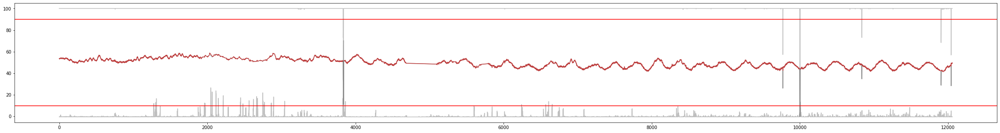

segment 0 34.71395694481225


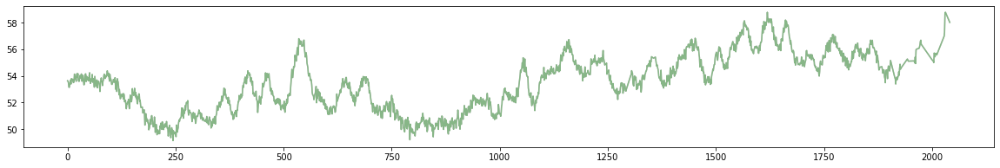

segment 1 169.76210283760065


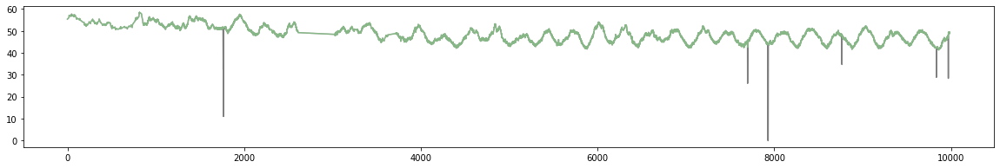

2 segments, 204.4760597824129 seconds total length
024 Baseline 000
['/Volumes/psp_data/Lisa_Marc/2020_03_12_PSP_024_Baseline/000/pupil_data']
0.9


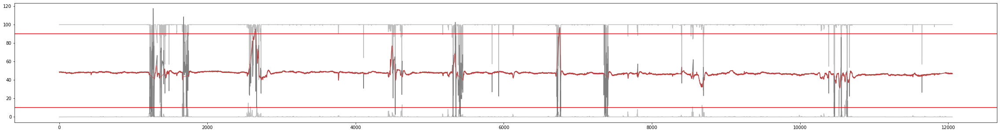

segment 0 20.70595195703936
segment 1 1.15593259754678
segment 2 4.267039621514414
segment 3 13.803932816696033
segment 4 0.45876008559935144
segment 5 31.059156785824598


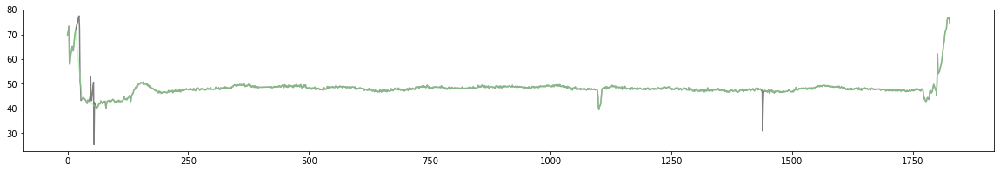

segment 6 14.246014042357274
segment 7 21.471060751184268
segment 8 10.199927727790055
segment 9 78.93095365683621


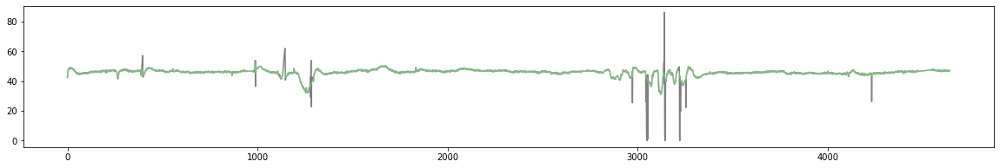

2 segments, 109.99011044266081 seconds total length
024 Baseline 001
['/Volumes/psp_data/Lisa_Marc/2020_03_12_PSP_024_Baseline/001/pupil_data']
0.9


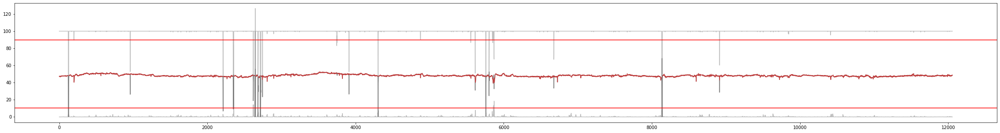

segment 0 204.9689130305851


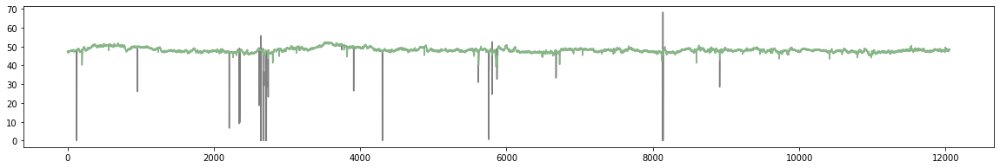

1 segments, 204.9689130305851 seconds total length
024 Baseline 002
['/Volumes/psp_data/Lisa_Marc/2020_03_12_PSP_024_Baseline/002/pupil_data']
0.9


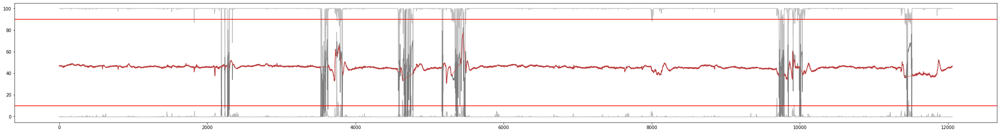

segment 0 38.55598272867792


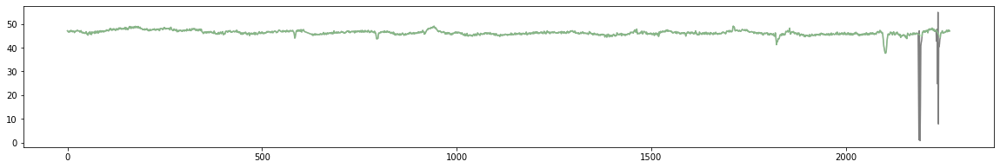

segment 1 20.841997377450753
segment 2 2.516150990013557
segment 3 12.648035387217533
segment 4 0.5271157441784453
segment 5 8.856961663281254
segment 6 0.6460244908994355
segment 7 71.77397551839749


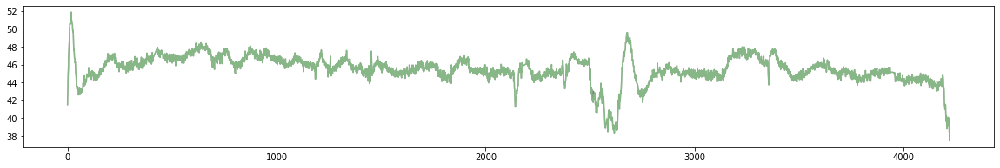

segment 8 0.7140296196630516
segment 9 2.3120283658972767
segment 10 23.544948615006433
segment 11 9.196989577514614
2 segments, 110.32995824707541 seconds total length


In [33]:
out_dir = '/Volumes/psp_data/Preprocessing_segmented_2023-12-27/PSP'
slu.mkdir_p(out_dir)


for subject, dictionary in dt.runs.items():
    for session, runs in dictionary.items():
        if runs != None:
            for run in runs:
                if float(subject) < 27:
                    print(subject, session, run)
                    sub = subject
                    group = 'PSP'
                    
                    path = glob(join('/Volumes/psp_data/Lisa_Marc/20*SP_{0}_{2}*'.format(sub, run, session),'{}*'.format(run),  'pupil_data'))
                    print(path)
                    with open(path[0], 'rb') as f:
                        file = pickle.load(f, encoding="latin-1")
                    df = pd.DataFrame(file['pupil_positions'])    
                    p = PS.PupilFrame(subject, group, session, run, directory='', out_dir=out_dir)

                    p.pupil['left'] = df.loc[df.id == 0].drop(['norm_pos',
                                                                  'ellipse',
                                                                  'method'], axis=1)
                    p.pupil['right'] = df.loc[df.id == 1].drop(['norm_pos',
                                                                   'ellipse',
                                                                   'method'], axis=1)
                    p.pupil['gaze'] = pd.DataFrame(file['gaze_positions'])


                    p.cut_resample()
                    p.excel()
                    excel_thresh=10
                    confidence_thresh=.9
                    islands=10
                    margin1=3
                    margin2=3

                    p.discard_interp(excel_thresh=excel_thresh, confidence_thresh=confidence_thresh,
                                         islands=islands, margin2=margin2, margin1=margin1)

                    f, ax = plt.subplots(figsize=(40, 5))
                    ax.plot(p.gp.diameter_mean.values, color='black', alpha=.5)
                    ax.plot(p.gp.d_intp.values, color='red', alpha=.5)

                    ax.plot(p.gp.confidence_d.values*100, color='grey', alpha=.5)
                    ax.axhline(confidence_thresh*100, color='red')
                    print(confidence_thresh)

                    ax.plot(p.gp.acceleration.values*2, color='grey', alpha=.5)
                    ax.axhline(excel_thresh, color='red')
                    plt.show()
                    p.normalize()

                    threshhold = 350

                    long_invalid_start = []
                    long_invalid_end = []


                    array = p.gp.diameter_blink.isnull()
                    convolved = np.convolve(~array, [0.5, 1], 'same')
                    ev_start = np.where(convolved == .5)[0]
                    fragment_ends = ev_start
                    if convolved[0] != 0:
                        fragment_ends = fragment_ends[1:len(fragment_ends)]
                    if convolved[len(convolved) - 1] == 0:
                        fragment_ends = np.append(fragment_ends, len(array))
                    ev_end = np.where(convolved == 1)[0]
                    if convolved[0] == 0:
                        fragment_starts = np.append(0, ev_end)
                    else:
                        fragment_starts = ev_end
                    if convolved[-1] == 1:
                        fragment_starts = fragment_starts[0:-1]
                    assert len(fragment_ends) == len(fragment_starts)
                    if fragment_ends[-1] == len(array):
                        fragment_ends[-1] = fragment_ends[-1] - 1
                    for i, s in enumerate(fragment_starts):
                        timedelta = array.reset_index().iloc[fragment_ends[i]].time - array.reset_index().iloc[fragment_starts[i]].time
                        if timedelta > pd.Timedelta('350ms'):
                            long_invalid_start.append(fragment_starts[i])
                            long_invalid_end.append(fragment_ends[i])


                    long_invalid_end = np.append(0, long_invalid_end).astype(int)
                    long_invalid_start = np.append(long_invalid_start, len(array)-1).astype(int)

                    cum_length = []
                    segments = []
                    for i, s in enumerate(long_invalid_start):
                        segment = p.gp[long_invalid_end[i]:long_invalid_start[i]]
                        segment_length = p.gp.iloc[long_invalid_start[i]].timestamp.iloc[0] - p.gp.iloc[long_invalid_end[i]].timestamp.iloc[0]
                        print("segment", i, segment_length)
                        if segment_length > 24:
                            segments.append(segment)
                            cum_length.append(segment_length)
                            segment.drop(['id', 'time', 'timestamp'], axis=1).to_hdf(join(out_dir, 'Pupil_Preprocessed_SUB-{0}_{1}_{2}_{3}.hdf'.
                                                format(subject,
                                                       session,
                                                       run, i)), key='Pupil')
                            f, ax = plt.subplots(figsize=(20, 3))
                            ax.plot(segment.diameter_mean.values, color='black', alpha=.5)
                            ax.plot(segment.d_intp.values, color='lightgreen', alpha=.5)
                            plt.show()

                    pdm = {'group':group,
                'subject': subject,
                                 'session': session,
                                 'run': run,
                                 'number_of_segments': len(segments),
                                 'segment_length': sum(cum_length),
                                 'excel_thresh': excel_thresh, 'confidence_thresh': confidence_thresh, 'islands': islands,
                                  'margin':margin1}
                    preprocessing_meta.append(pdm)
                    print('{0} segments, {1} seconds total length'.format(pdm['number_of_segments'], pdm['segment_length']))



## Controls

- only Gulbi Controls
- same approach as above

02 Followup 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_20_HOT_K02/000/pupil_data']
0.9


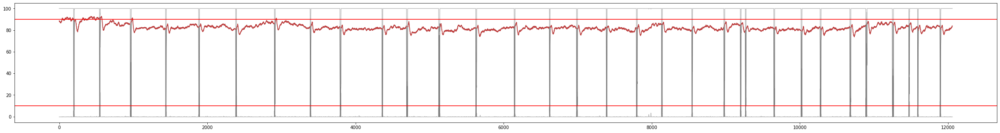

segment 0 87.03995849858438


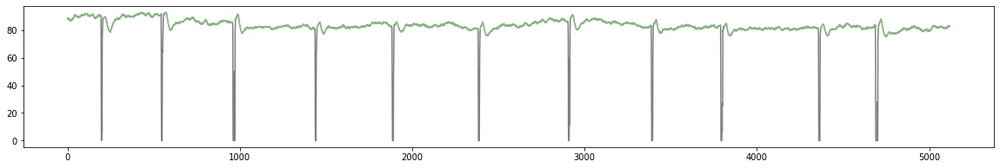

segment 1 97.68193874352073


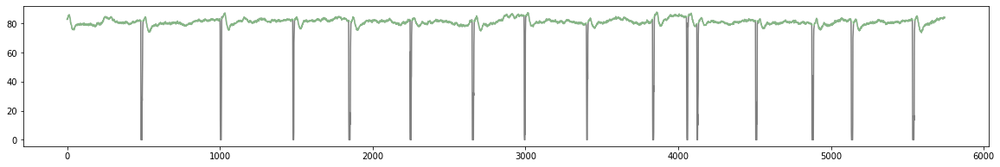

segment 2 19.533021259252564
2 segments, 184.72189724210511 seconds total length
02 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_20_HOT_K02/001/pupil_data']
0.9


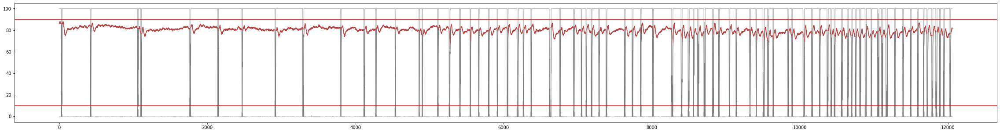

segment 0 55.84495862746189


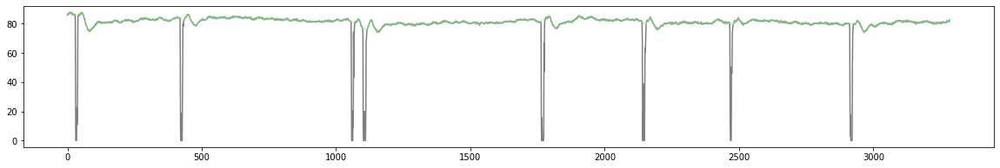

segment 1 48.82401628507432


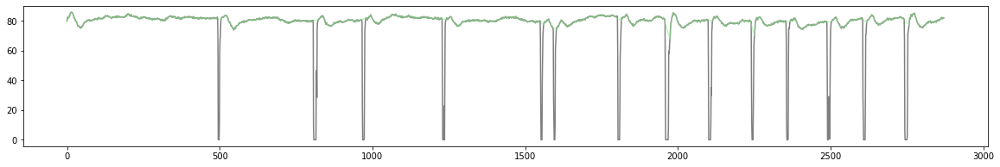

segment 2 7.004003094982181
segment 3 27.540018378844252


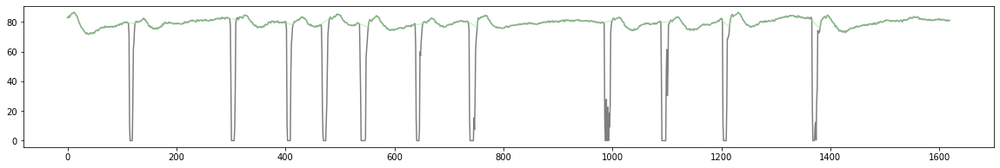

segment 4 3.4001020269206492
segment 5 1.8191203491460328
segment 6 1.0709683512650372
segment 7 1.5300541568558401
segment 8 11.237036426158738
segment 9 8.789079180405679
segment 10 5.065974447008557
segment 11 4.249983889361829
segment 12 2.447933721325171
segment 13 0.884065636952073
segment 14 2.4820528038217162
segment 15 1.495970171119552
segment 16 8.92497279176132
segment 17 1.6830149395791523
segment 18 1.3089879694325646
segment 19 1.7679725698253606
3 segments, 132.20899329138047 seconds total length
02 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_20_HOT_K02/002/pupil_data']
0.9


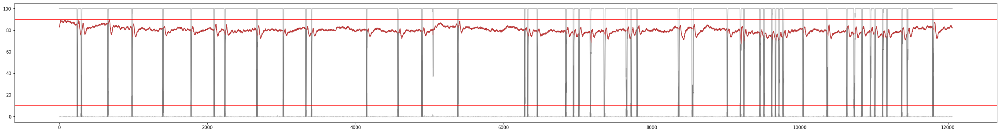

segment 0 77.62203641671658


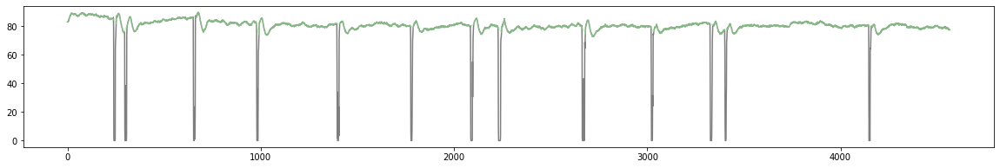

segment 1 64.00499835889968


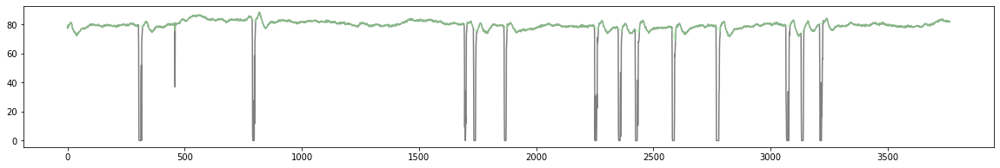

segment 2 2.838989256286368
segment 3 20.41701717574324
segment 4 9.706942263277597
segment 5 7.599054495140081
segment 6 2.5839173364365706
segment 7 7.140007219386462
segment 8 5.542012988800707
segment 9 4.21604829187163
2 segments, 141.62703477561627 seconds total length
03 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_21_GUN_K03/000/pupil_data']
Confidence equal in both eyes
0.9


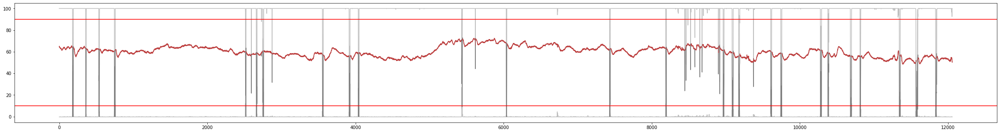

segment 0 66.48699791807303


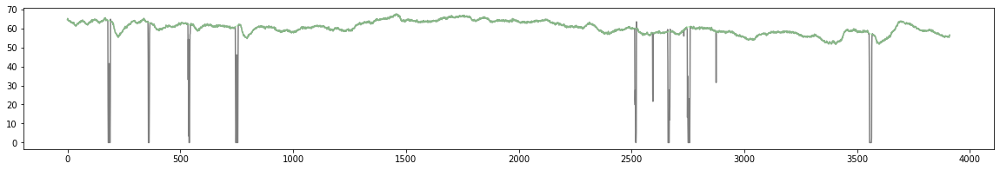

segment 1 107.79698642460426


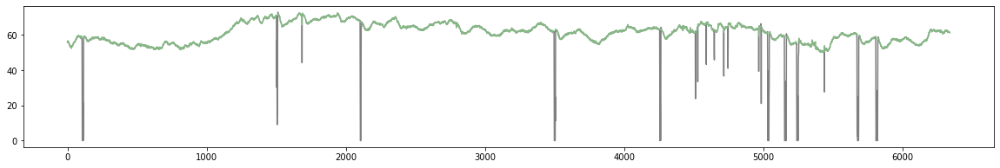

segment 2 6.511091488180682
segment 3 14.671037637112022
segment 4 7.853982078304398
2 segments, 174.2839843426773 seconds total length
03 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_21_GUN_K03/001/pupil_data']
0.9


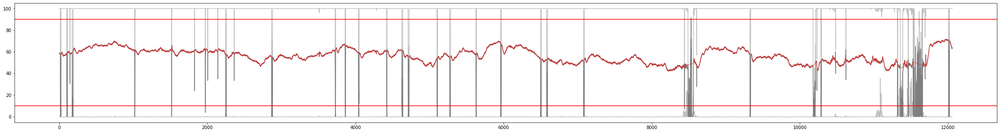

segment 0 143.88798573116946


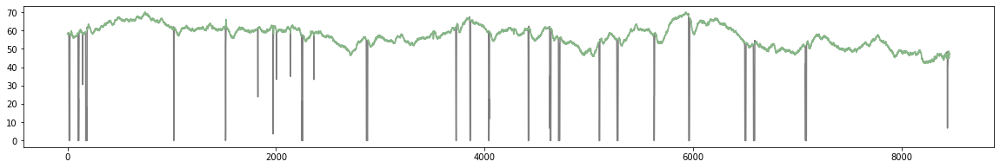

segment 1 27.404012246355705


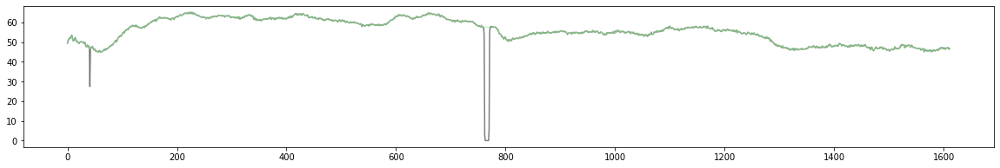

segment 2 14.722079678940645
segment 3 4.012050781813741
segment 4 0.867002065970155
segment 5 0.2720465637612506
segment 6 0.18699858748004772
segment 7 6.731989441454061
2 segments, 171.29199797752517 seconds total length
03 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_21_GUN_K03/002/pupil_data']
0.9


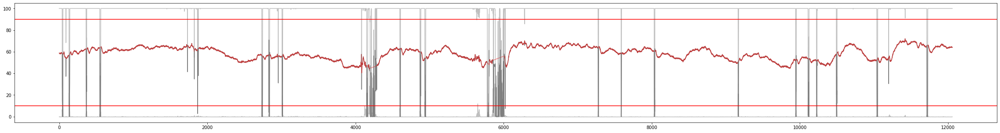

segment 0 70.51594560875674


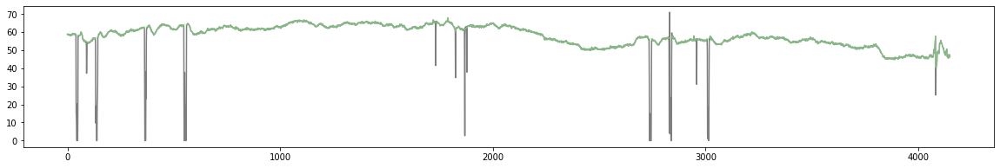

segment 1 0.33995952073019
segment 2 25.312991800405143


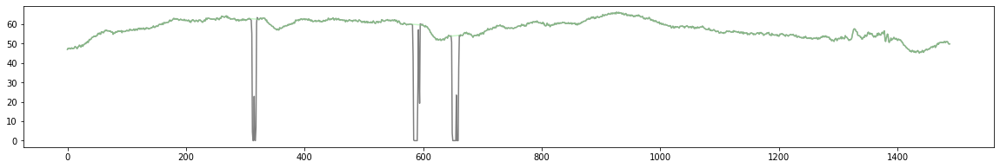

segment 3 0.8330223568773363
segment 4 102.79904135718243


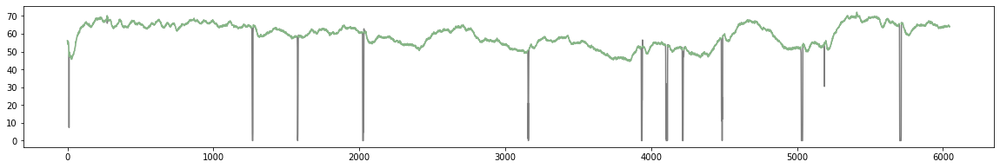

3 segments, 198.6279787663443 seconds total length
04 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_22_WEJ_K04/000/pupil_data']
0.9


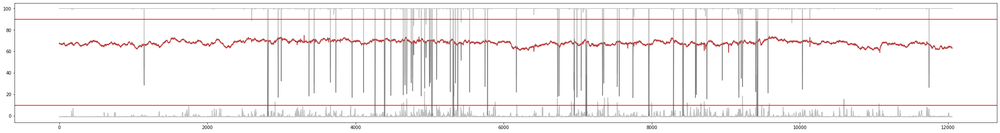

segment 0 124.61004548482015


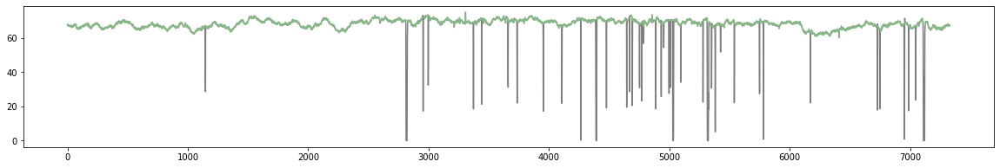

segment 1 20.909993725595996
segment 2 13.497988774150144
segment 3 44.57402354865917


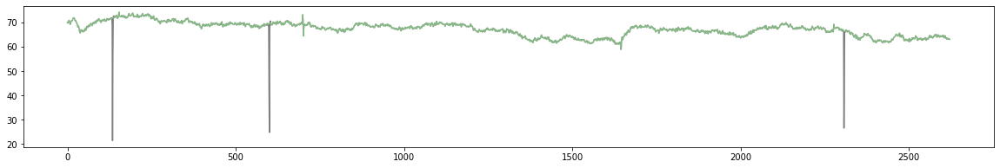

2 segments, 169.18406903347932 seconds total length
04 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_22_WEJ_K04/001/pupil_data']
0.9


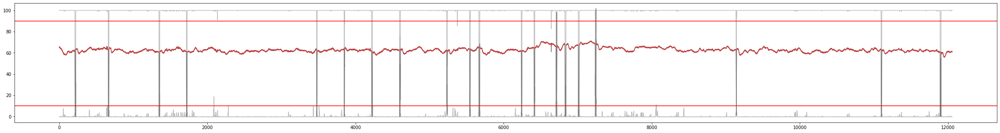

segment 0 204.96894487575628


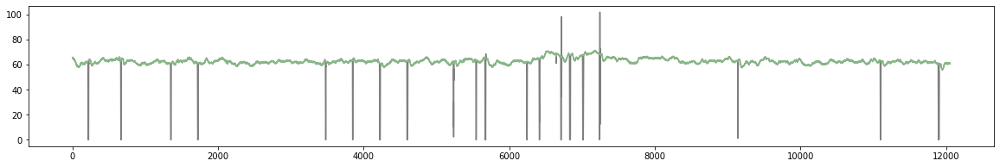

1 segments, 204.96894487575628 seconds total length
04 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_06_22_WEJ_K04/002/pupil_data']
0.9


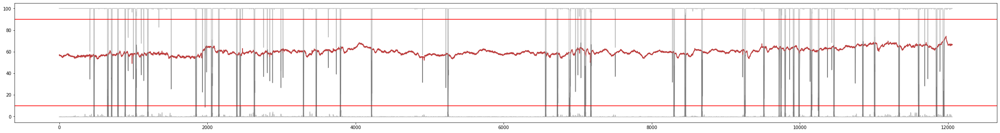

segment 0 34.866932835149555


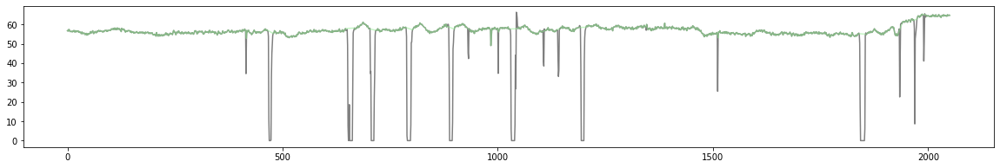

segment 1 81.71902863322055


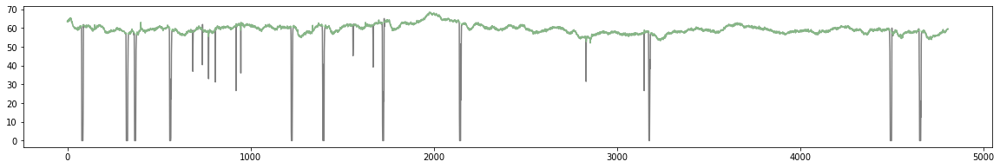

segment 2 3.127949364500296
segment 3 36.278029012573484


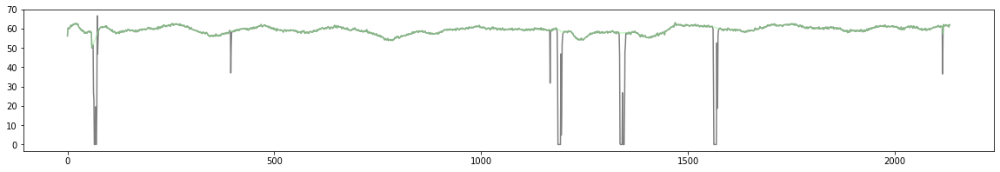

segment 4 14.77298441400751
segment 5 29.987952139441063


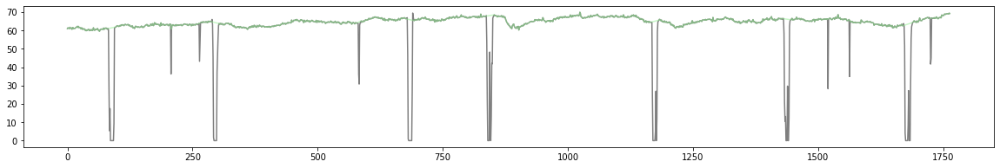

segment 6 1.8020259984336917
4 segments, 182.85194262038465 seconds total length
05 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_ECK_K05/000/pupil_data']
Confidence equal in both eyes
0.9


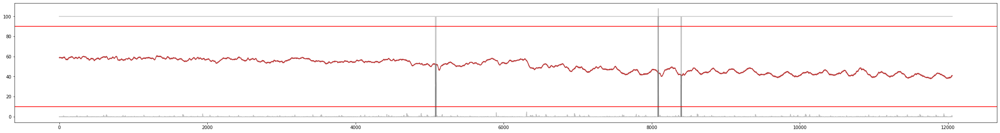

segment 0 204.96894994351896


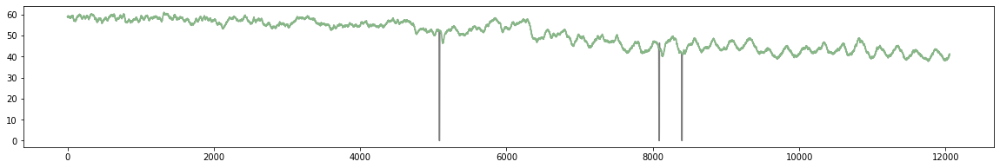

1 segments, 204.96894994351896 seconds total length
05 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_ECK_K05/001/pupil_data']
0.9


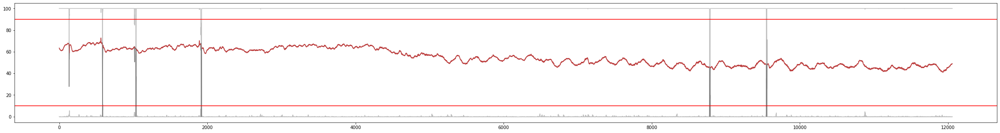

segment 0 17.204010227666004
segment 1 187.18702219839906


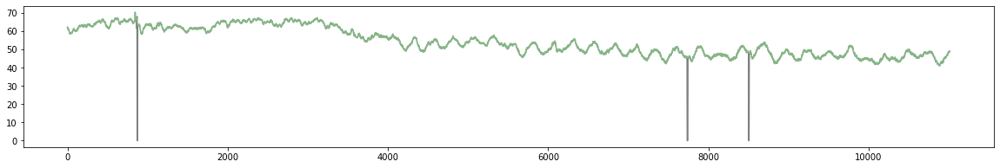

1 segments, 187.18702219839906 seconds total length
05 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_ECK_K05/002/pupil_data']
0.9


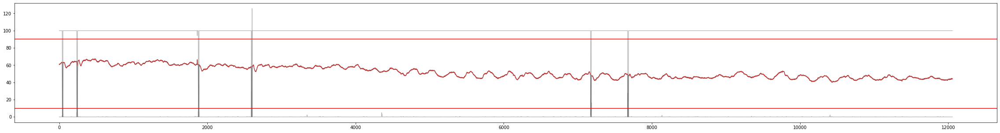

segment 0 204.96905277311453


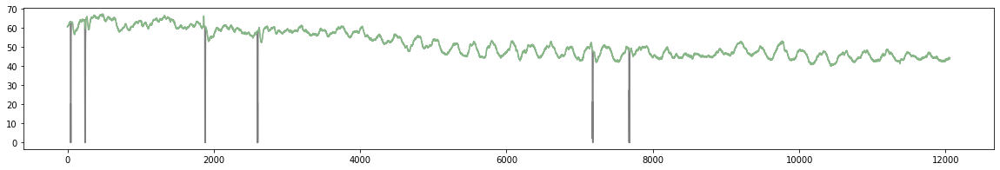

1 segments, 204.96905277311453 seconds total length
06 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_CLW_K06/001/pupil_data']
0.9


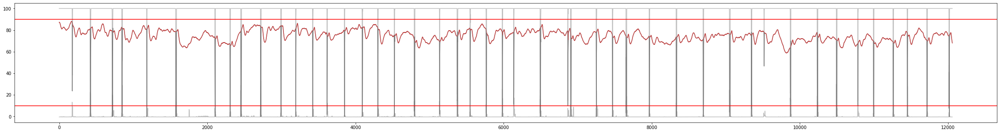

segment 0 204.96891411097022


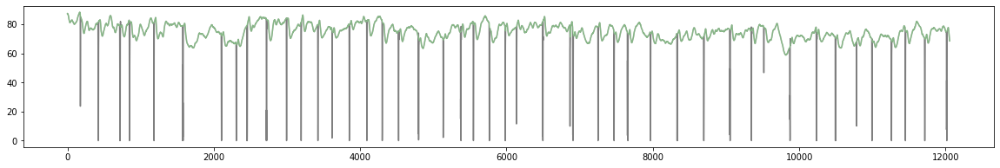

1 segments, 204.96891411097022 seconds total length
06 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_CLW_K06/002/pupil_data']
0.9


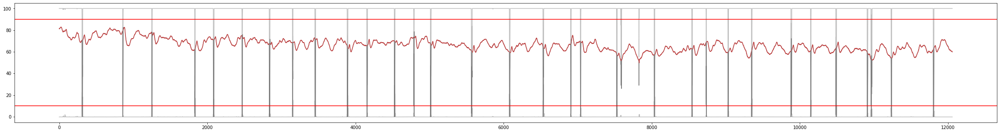

segment 0 204.96916001380305


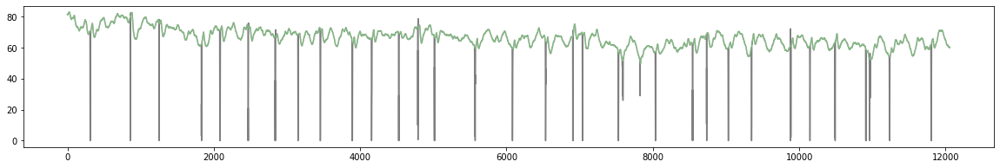

1 segments, 204.96916001380305 seconds total length
06 Baseline 003
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_CLW_K06/003/pupil_data']
0.9


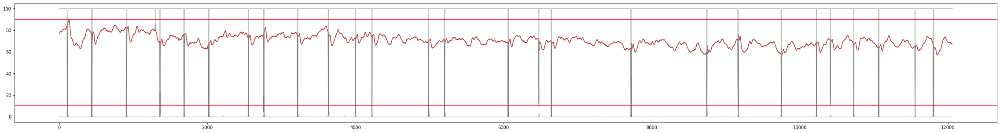

segment 0 204.9687976743735


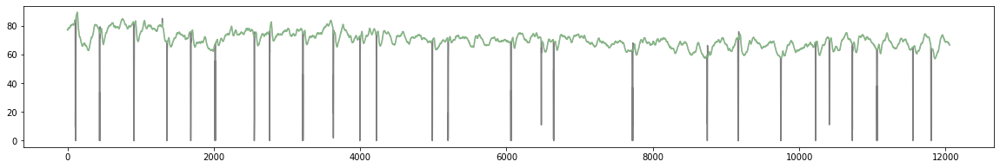

1 segments, 204.9687976743735 seconds total length
07 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_BEE_K07/000/pupil_data']
0.9


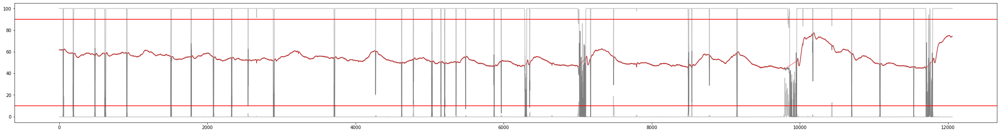

segment 0 106.81099371617893


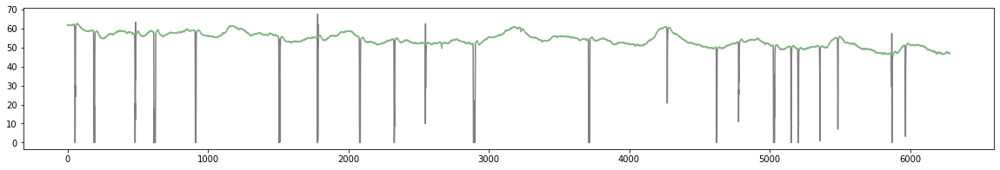

segment 1 11.746976715046912
segment 2 45.5429949372774


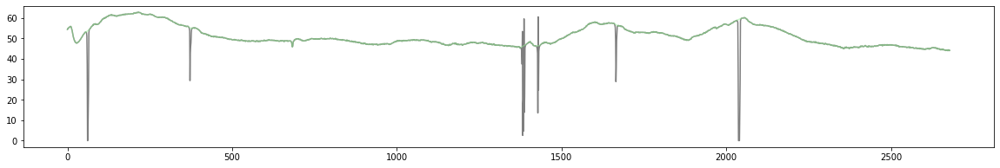

segment 3 29.546072571130935


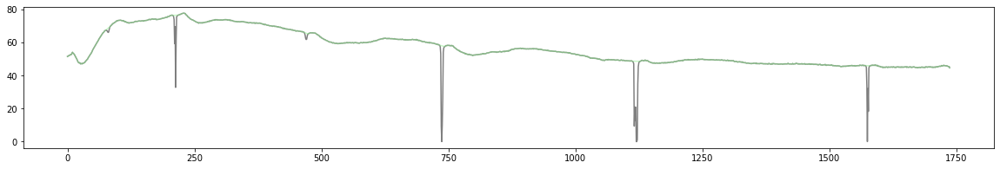

segment 4 4.454010509711225
3 segments, 181.90006122458726 seconds total length
07 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_BEE_K07/001/pupil_data']
0.9


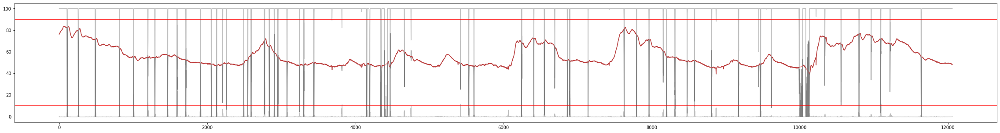

segment 0 74.61301769831334


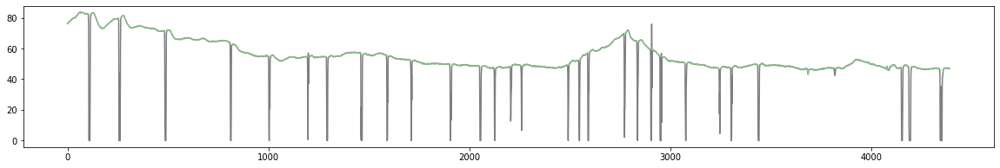

segment 1 94.34991995288874


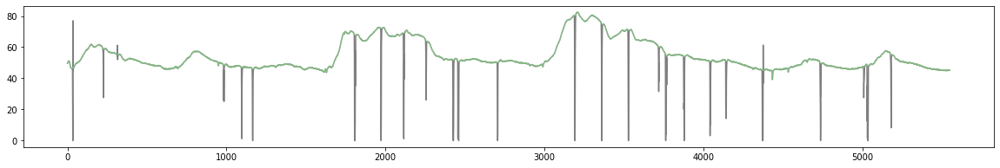

segment 2 0.6120318801549729
segment 3 32.724950117000844


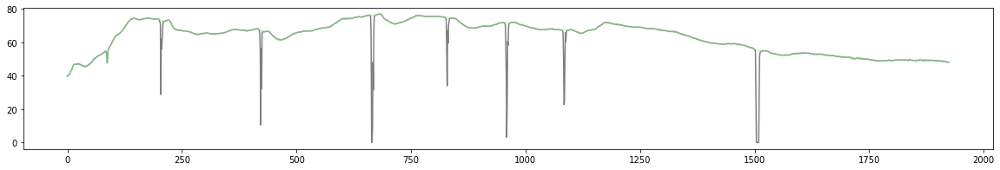

3 segments, 201.68788776820293 seconds total length
07 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_04_BEE_K07/002/pupil_data']
0.9


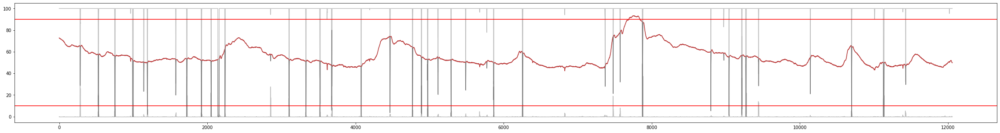

segment 0 36.36295637494186


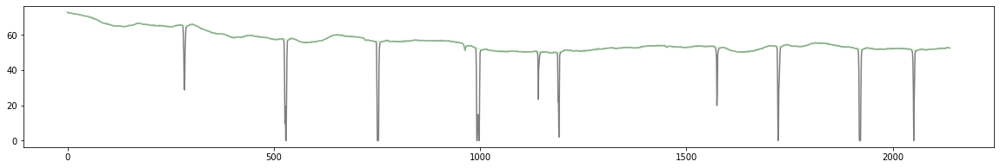

segment 1 168.21500090431073


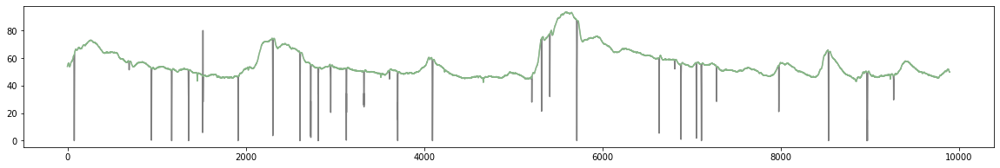

2 segments, 204.5779572792526 seconds total length
08 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_GOH_K08/000/pupil_data']
0.9


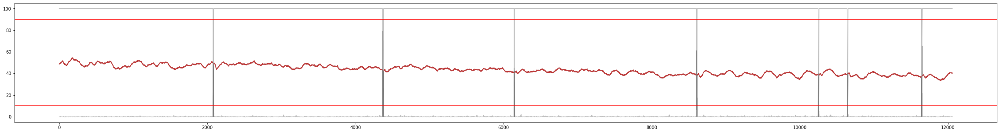

segment 0 204.96917250973638


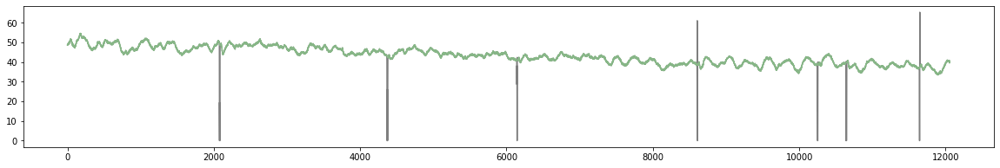

1 segments, 204.96917250973638 seconds total length
08 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_GOH_K08/001/pupil_data']
0.9


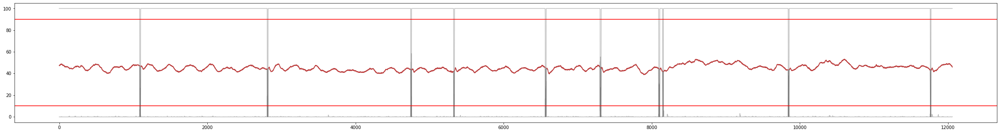

segment 0 111.50305248162476


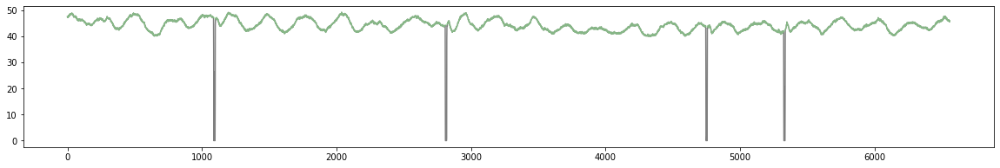

segment 1 12.206075985683128
segment 2 13.107073860126548
segment 3 67.08208913228009


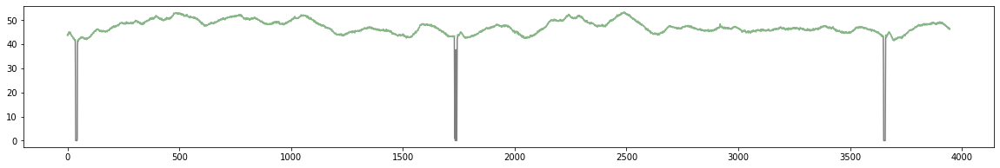

2 segments, 178.58514161390485 seconds total length
08 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_GOH_K08/002/pupil_data']
0.9


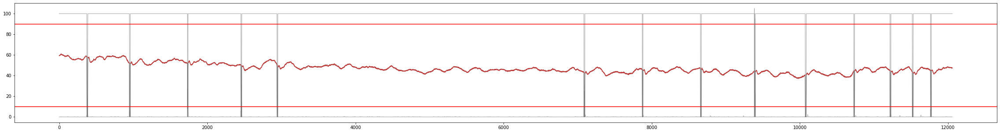

segment 0 204.96893965819618


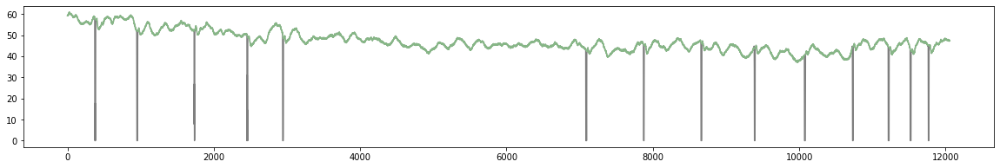

1 segments, 204.96893965819618 seconds total length
09 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_MAM_K09/000/pupil_data']
0.9


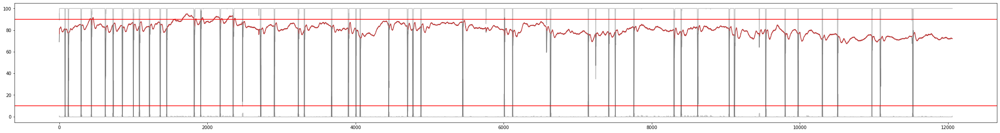

segment 0 195.68710650969865


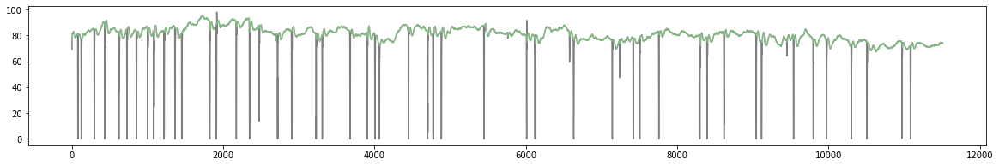

segment 1 8.87395420861776
1 segments, 195.68710650969865 seconds total length
09 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_MAM_K09/001/pupil_data']
0.9


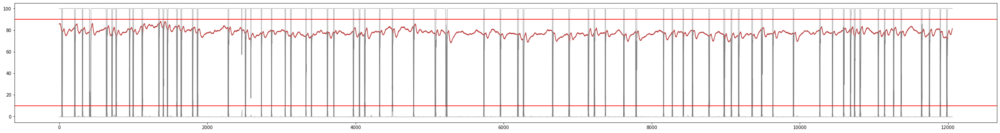

segment 0 6.901961668073454
segment 1 81.32796787906636


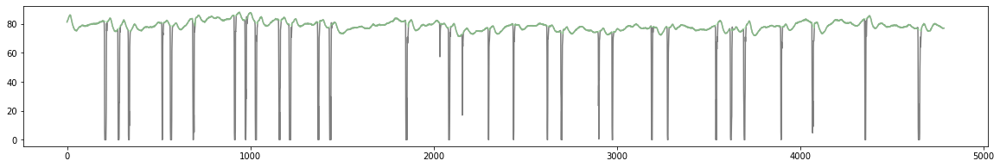

segment 2 43.14597049710551


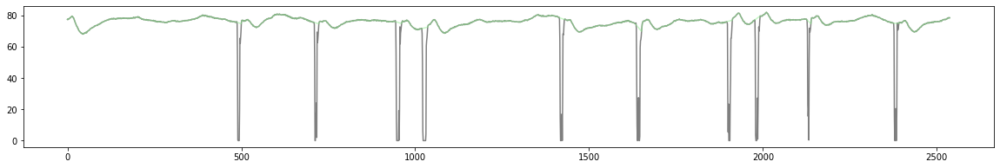

segment 3 72.35198362704364


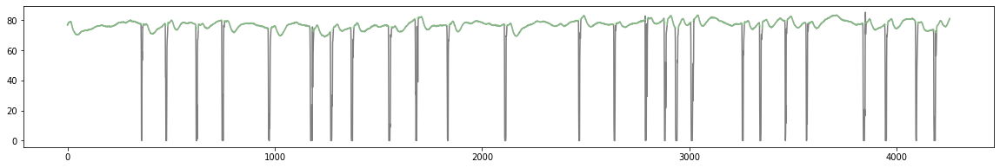

3 segments, 196.8259220032155 seconds total length
09 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_13_MAM_K09/002/pupil_data']
0.9


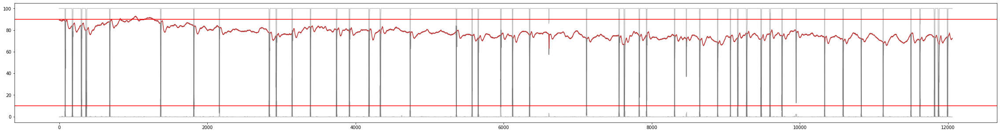

segment 0 204.96900371928018


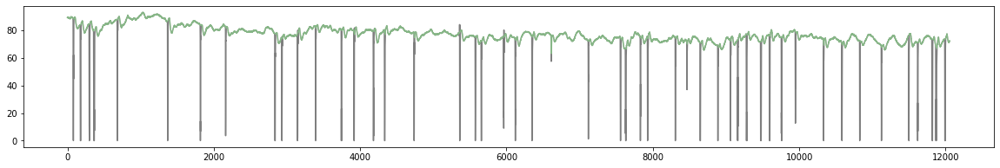

1 segments, 204.96900371928018 seconds total length
10 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_NIP_K10/000/pupil_data']
0.9


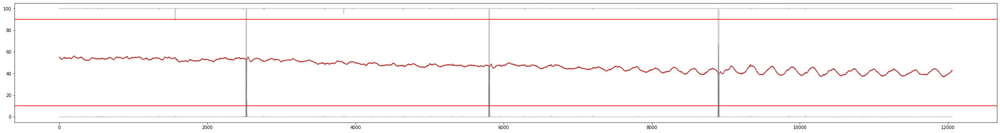

segment 0 151.1638843553228


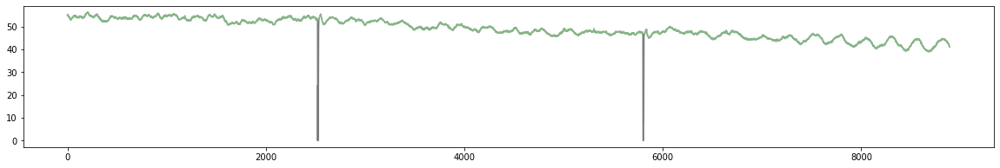

segment 1 53.44781250903179


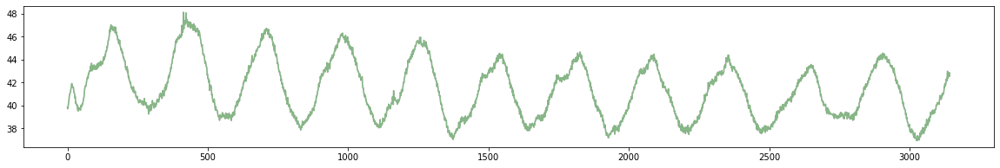

2 segments, 204.6116968643546 seconds total length
10 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_NIP_K10/001/pupil_data']
0.9


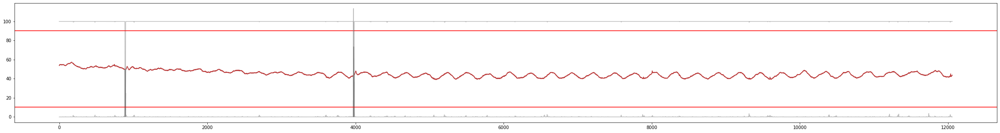

segment 0 204.96904162864666


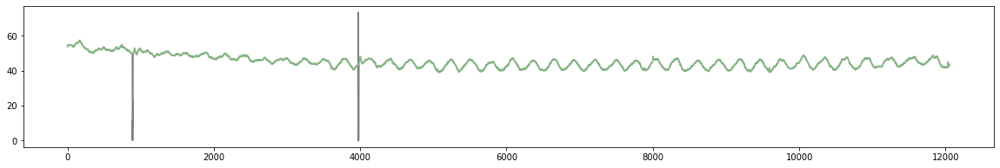

1 segments, 204.96904162864666 seconds total length
10 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_NIP_K10/002/pupil_data']
0.9


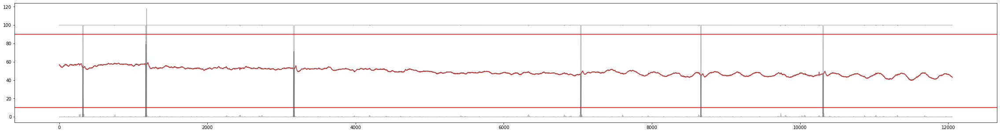

segment 0 204.96862841672555


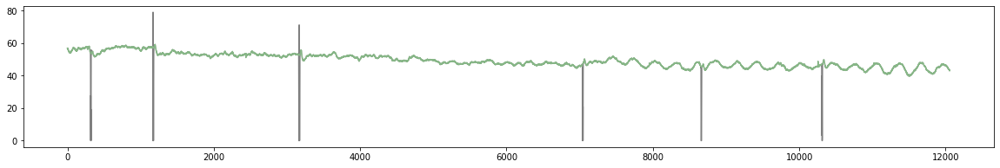

1 segments, 204.96862841672555 seconds total length
11 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_TIF_K11/000/pupil_data']
0.9


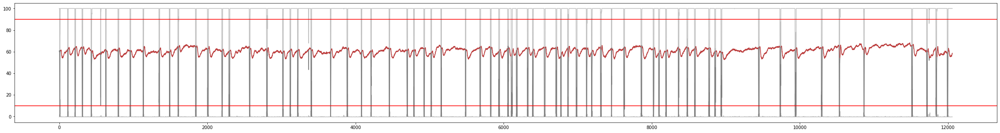

segment 0 103.68306886301434


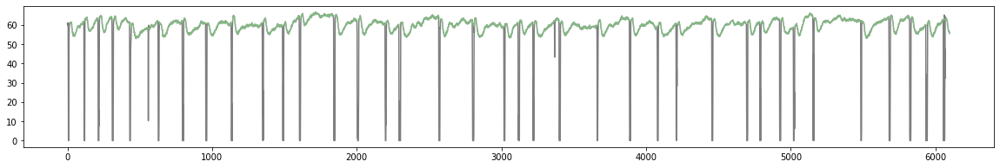

segment 1 100.92891802879603


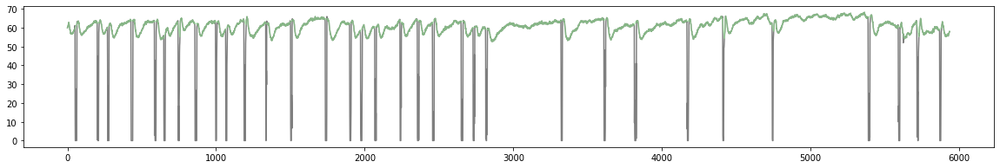

2 segments, 204.61198689181037 seconds total length
11 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_TIF_K11/001/pupil_data']
0.9


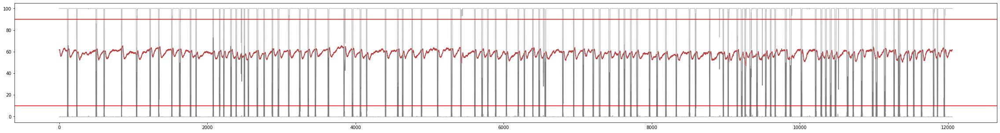

segment 0 27.505940840550466


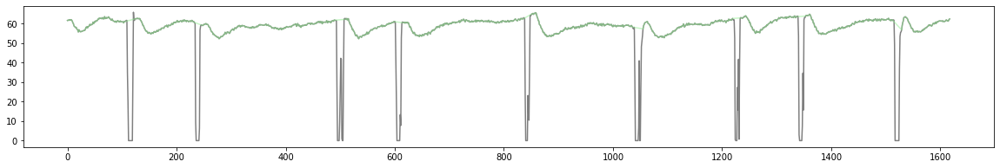

segment 1 37.40003115109721


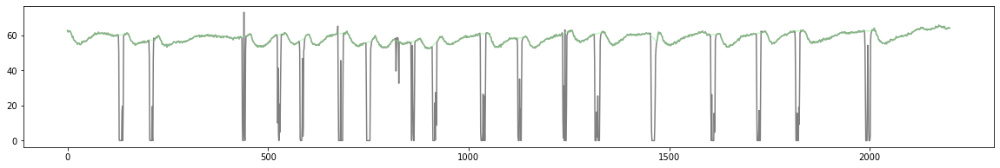

segment 2 1.4450381592614576
segment 3 10.064012789262051
segment 4 33.45598305663589


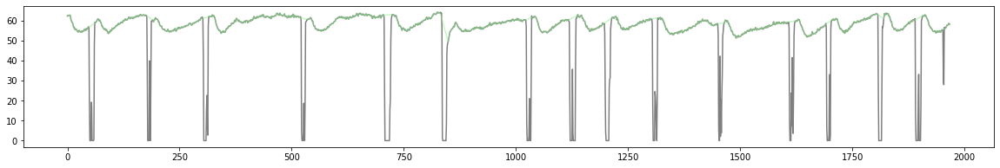

segment 5 14.364976815675618
segment 6 6.000964240120084
segment 7 23.663947453766013
segment 8 1.5979986759193707
segment 9 7.667028312629554
segment 10 0.696922559858649
segment 11 6.680966302323213
segment 12 0.6799726497483789
segment 13 0.7310686167693348
segment 14 0.7139951415010728
segment 15 2.397021849108569
segment 16 2.856015808887605
segment 17 3.026035293121822
segment 18 1.513031553782639
segment 19 2.822051637180266
segment 20 11.951043178116379
3 segments, 98.36195504828356 seconds total length
11 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_14_TIF_K11/002/pupil_data']
0.9


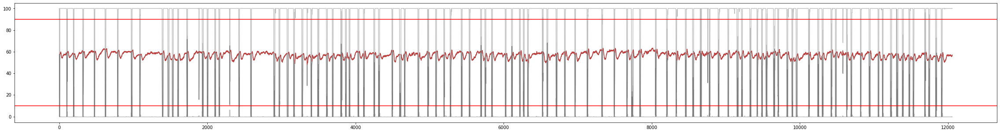

segment 0 24.888109813051415


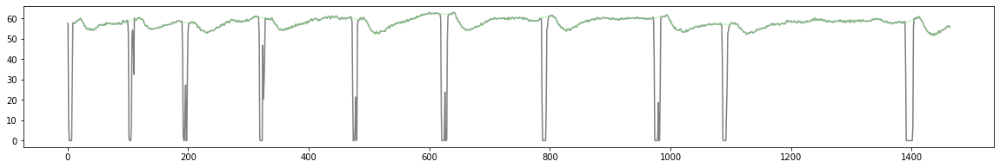

segment 1 23.93599772217567
segment 2 2.702963803487364
segment 3 3.0090827582680504
segment 4 3.280977282054664
segment 5 4.913040343250032
segment 6 8.279027426549874
segment 7 4.454037881165277
segment 8 52.80200863473874


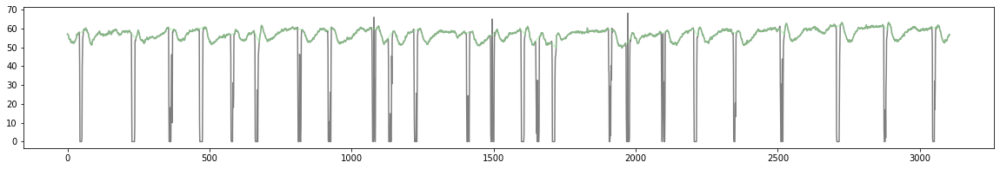

segment 9 13.583039069155348
segment 10 1.4110444898615242
segment 11 8.04101306132361
segment 12 2.5839855856756913
segment 13 5.04895726594259
segment 14 4.74298313093459
segment 15 2.482000498333946
segment 16 1.7509216139733326
segment 17 0.645978132430173
segment 18 10.403984266238695
segment 19 5.932982677695691
segment 20 0.9179714132187655
segment 21 5.694979574196623
segment 22 5.099981963699975
2 segments, 77.69011844779016 seconds total length
12 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_CVH_K12/000/pupil_data']
0.9


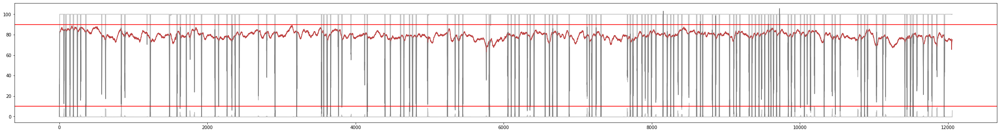

segment 0 98.6000361241313


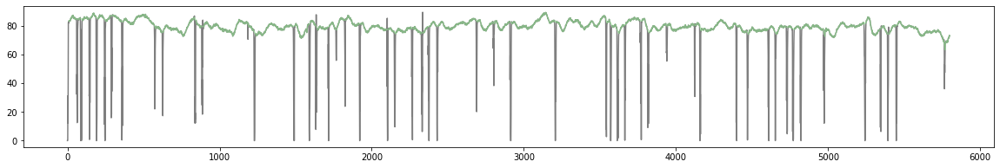

segment 1 105.9439198288892


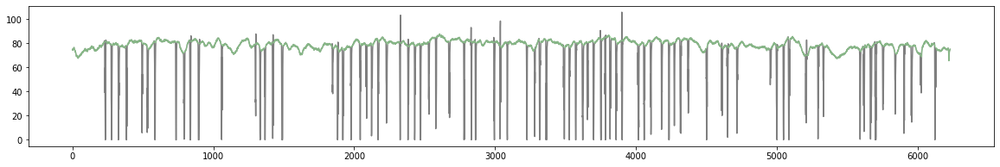

2 segments, 204.5439559530205 seconds total length
12 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_CVH_K12/001/pupil_data']
0.9


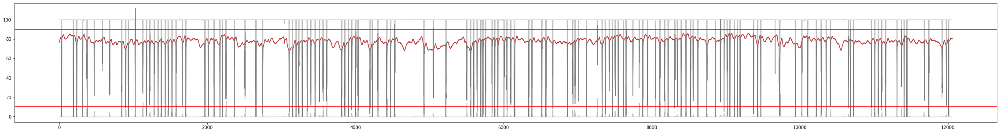

segment 0 165.18911503067648


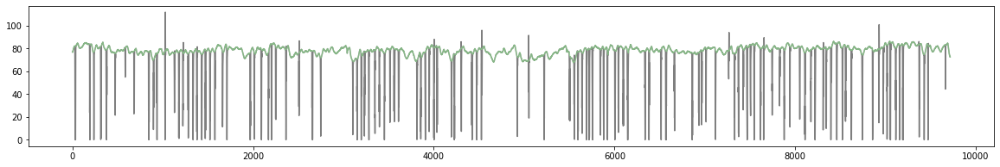

segment 1 39.40593927043665


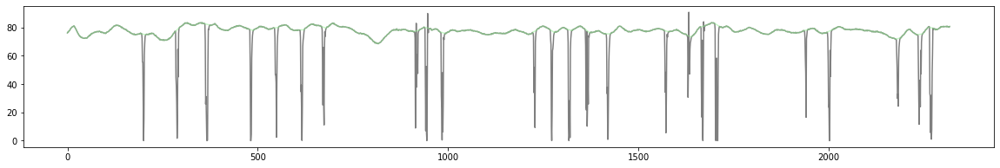

2 segments, 204.59505430111312 seconds total length
12 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_CVH_K12/002/pupil_data']
0.9


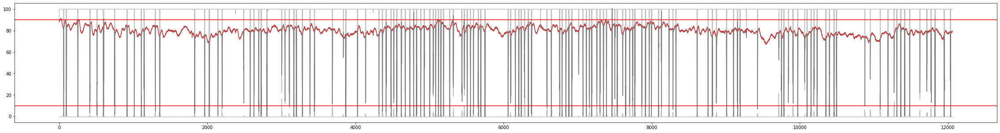

segment 0 204.9689486365969


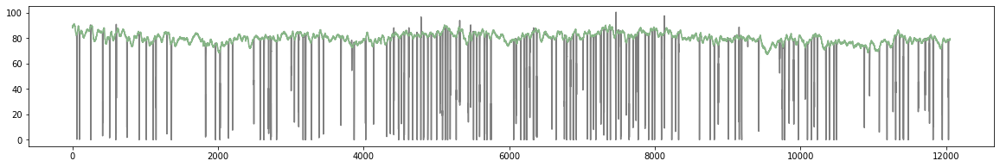

1 segments, 204.9689486365969 seconds total length
13 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_TOK_K13/000/pupil_data']
0.9


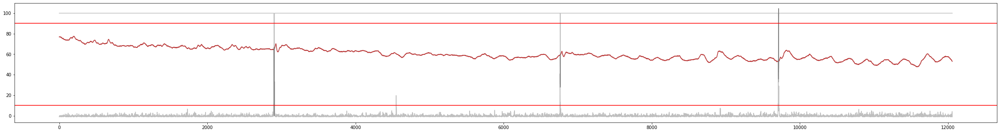

segment 0 204.96908131078817


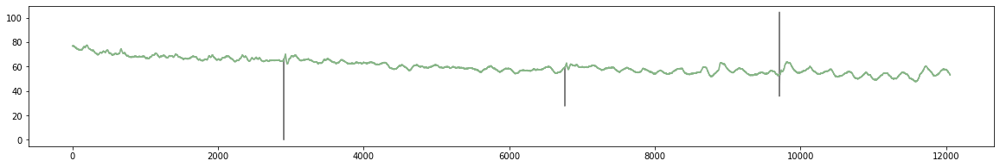

1 segments, 204.96908131078817 seconds total length
13 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_TOK_K13/001/pupil_data']
0.9


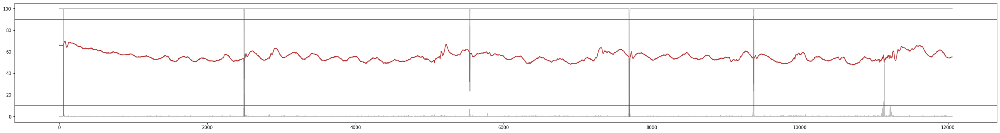

segment 0 204.96900121259387


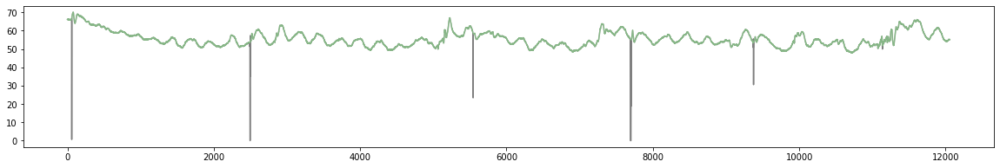

1 segments, 204.96900121259387 seconds total length
13 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/2017_07_19_TOK_K13/002/pupil_data']
Confidence equal in both eyes
0.9


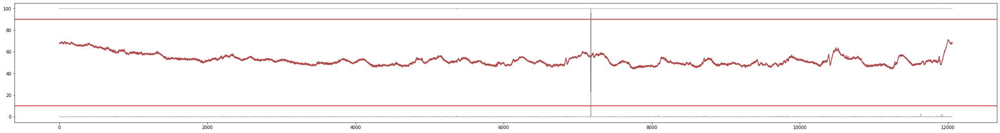

segment 0 204.96889629034558


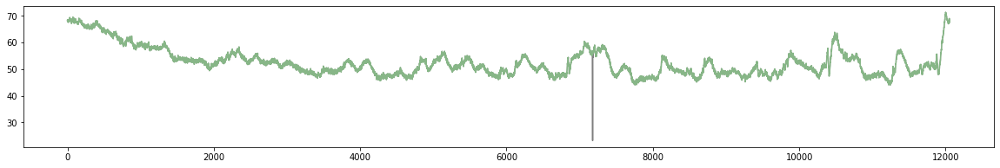

1 segments, 204.96889629034558 seconds total length


In [12]:
out_dir = '/Volumes/psp_data/Preprocessing_segmented_2023-12-27/Controls'
slu.mkdir_p(out_dir)


for subject, runs in dt.c_runs.items():
    for run in runs:
        if subject[0] != 'H':
            print(subject, session, run)
            sub = subject
            group = 'Controls'
            session = 'Baseline'

            path = glob(join('/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/recordings/20*K{0}'.format(sub),'{}*'.format(run),  'pupil_data'))
            print(path)
            with open(path[0], 'rb') as f:
                file = pickle.load(f, encoding="latin-1")
            df = pd.DataFrame(file['pupil_positions'])    
            p = PS.PupilFrame(subject, group, session, run, directory='', out_dir=out_dir)

            p.pupil['left'] = df.loc[df.id == 0].drop(['norm_pos',
                                                          'ellipse',
                                                          'method'], axis=1)
            p.pupil['right'] = df.loc[df.id == 1].drop(['norm_pos',
                                                           'ellipse',
                                                           'method'], axis=1)
            p.pupil['gaze'] = pd.DataFrame(file['gaze_positions'])


            p.cut_resample()
            p.excel()
            excel_thresh=10
            confidence_thresh=.9
            islands=10
            margin1=3
            margin2=3

            p.discard_interp(excel_thresh=excel_thresh, confidence_thresh=confidence_thresh,
                                 islands=islands, margin2=margin2, margin1=margin1)

            f, ax = plt.subplots(figsize=(40, 5))
            ax.plot(p.gp.diameter_mean.values, color='black', alpha=.5)
            ax.plot(p.gp.d_intp.values, color='red', alpha=.5)

            ax.plot(p.gp.confidence_d.values*100, color='grey', alpha=.5)
            ax.axhline(confidence_thresh*100, color='red')
            print(confidence_thresh)

            ax.plot(p.gp.acceleration.values*2, color='grey', alpha=.5)
            ax.axhline(excel_thresh, color='red')
            plt.show()
            p.normalize()

            threshhold = 350

            long_invalid_start = []
            long_invalid_end = []


            array = p.gp.diameter_blink.isnull()
            convolved = np.convolve(~array, [0.5, 1], 'same')
            ev_start = np.where(convolved == .5)[0]
            fragment_ends = ev_start
            if convolved[0] != 0:
                fragment_ends = fragment_ends[1:len(fragment_ends)]
            if convolved[len(convolved) - 1] == 0:
                fragment_ends = np.append(fragment_ends, len(array))
            ev_end = np.where(convolved == 1)[0]
            if convolved[0] == 0:
                fragment_starts = np.append(0, ev_end)
            else:
                fragment_starts = ev_end
            if convolved[-1] == 1:
                fragment_starts = fragment_starts[0:-1]
            assert len(fragment_ends) == len(fragment_starts)
            if fragment_ends[-1] == len(array):
                fragment_ends[-1] = fragment_ends[-1] - 1
            for i, s in enumerate(fragment_starts):
                timedelta = array.reset_index().iloc[fragment_ends[i]].time - array.reset_index().iloc[fragment_starts[i]].time
                if timedelta > pd.Timedelta('350ms'):
                    long_invalid_start.append(fragment_starts[i])
                    long_invalid_end.append(fragment_ends[i])


            long_invalid_end = np.append(0, long_invalid_end).astype(int)
            long_invalid_start = np.append(long_invalid_start, len(array)-1).astype(int)

            cum_length = []
            segments = []
            for i, s in enumerate(long_invalid_start):
                segment = p.gp[long_invalid_end[i]:long_invalid_start[i]]
                segment_length = p.gp.iloc[long_invalid_start[i]].timestamp.iloc[0] - p.gp.iloc[long_invalid_end[i]].timestamp.iloc[0]
                print("segment", i, segment_length)
                if segment_length > 24:
                    segments.append(segment)
                    cum_length.append(segment_length)
                    segment.drop(['id', 'time', 'timestamp'], axis=1).to_hdf(join(out_dir, 'Pupil_Preprocessed_SUB-{0}_{1}_{2}_{3}.hdf'.
                                        format(subject,
                                               session,
                                               run, i)), key='Pupil')
                    f, ax = plt.subplots(figsize=(20, 3))
                    ax.plot(segment.diameter_mean.values, color='black', alpha=.5)
                    ax.plot(segment.d_intp.values, color='lightgreen', alpha=.5)
                    plt.show()

            pdm = {'group':group,
                'subject': subject,
                                 'session': session,
                                 'run': run,
                                 'number_of_segments': len(segments),
                                 'segment_length': sum(cum_length),
                                 'excel_thresh': excel_thresh, 'confidence_thresh': confidence_thresh, 'islands': islands,
                                  'margin':margin1}
            preprocessing_meta.append(pdm)
            print('{0} segments, {1} seconds total length'.format(pdm['number_of_segments'], pdm['segment_length']))



## PD patients

- same as above

01 Baseline 000_DBS_OFF
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_01_27_STE_P01/000_DBS_OFF/pupil_data']
0.9


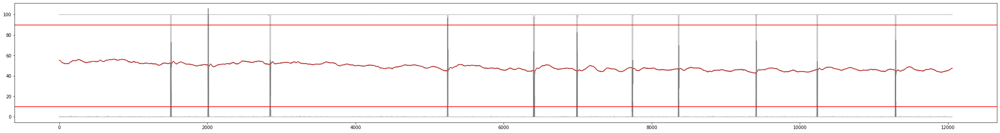

segment 0 25.48282956139883


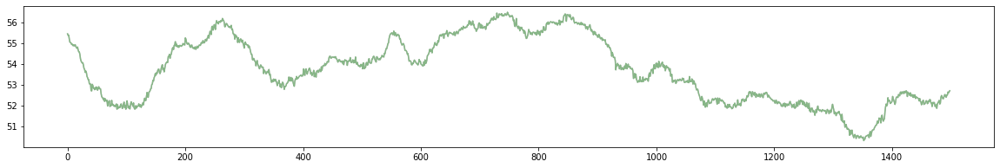

segment 1 82.92590494742035


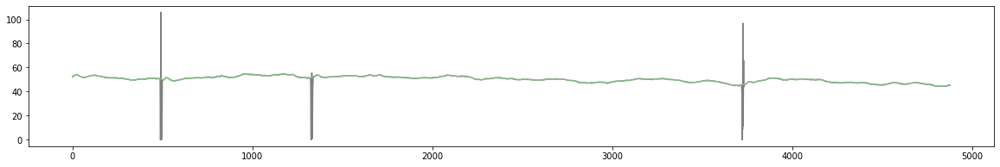

segment 2 95.77800306530844


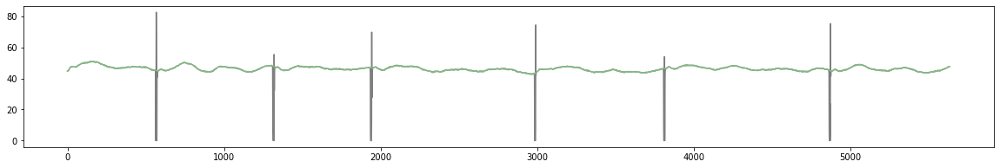

3 segments, 204.18673757412762 seconds total length
01 Baseline 001_DBS_OFF
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_01_27_STE_P01/001_DBS_OFF/pupil_data']
0.9


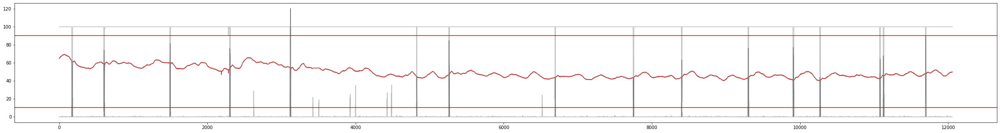

segment 0 168.333897964505


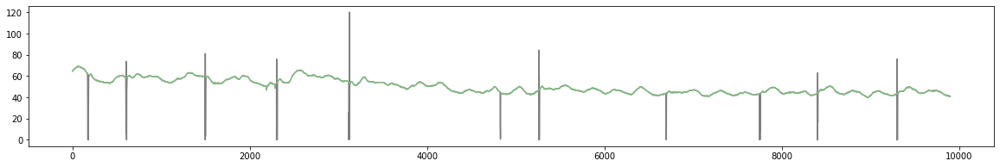

segment 1 20.331946356542176
segment 2 15.571933458399144
1 segments, 168.333897964505 seconds total length
01 Baseline 003_DBS_OFF
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_01_27_STE_P01/003_DBS_OFF/pupil_data']
0.9


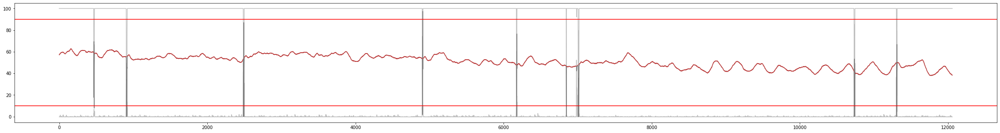

segment 0 42.17692474380601


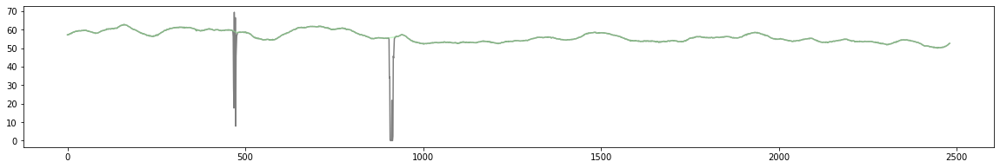

segment 1 76.09195868752431


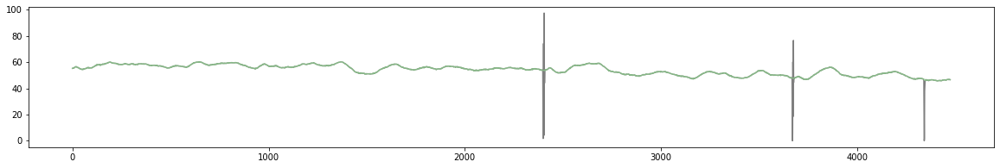

segment 2 85.61176239920314


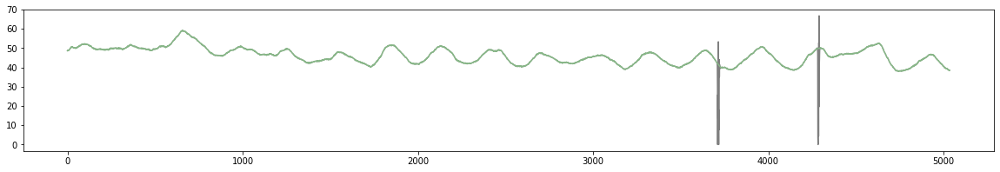

3 segments, 203.88064583053347 seconds total length
02 Baseline 006_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_02_14_DRP_P02/006_C/pupil_data']
0.9


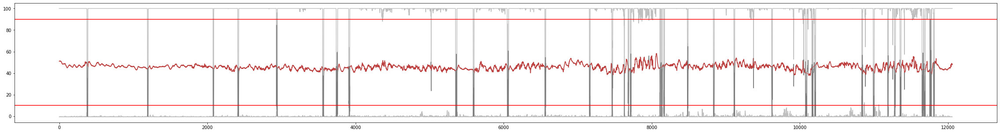

segment 0 60.4180511473387


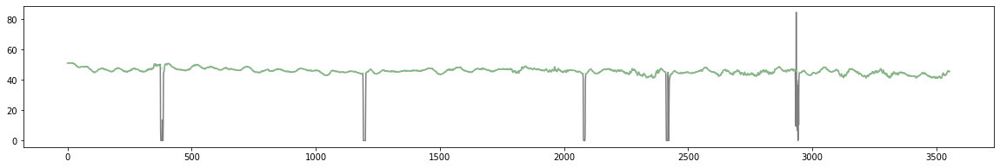

segment 1 2.753950264570449
segment 2 26.94497595905159


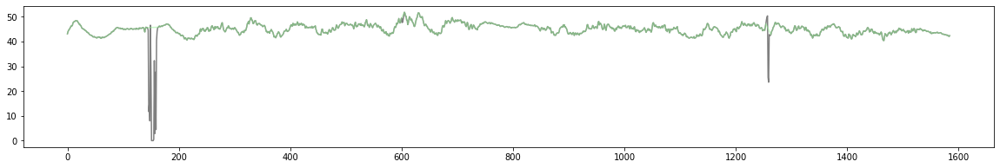

segment 3 11.440951855753156
segment 4 34.59500788574951


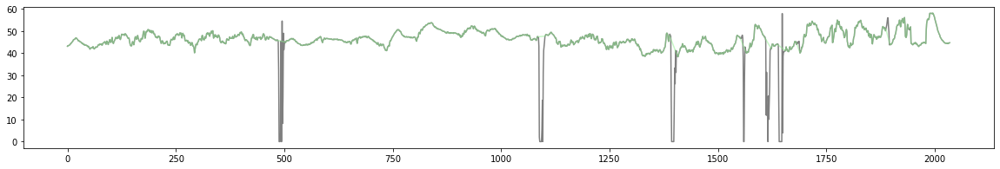

segment 5 32.74196157746883


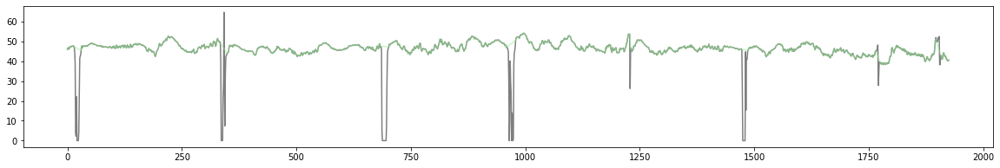

segment 6 0.730998879265826
segment 7 19.243985743998564
segment 8 4.65792889342265
segment 9 0.918050941081674
segment 10 4.7260238660892355
4 segments, 154.69999656960863 seconds total length
02 Baseline 007_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_02_14_DRP_P02/007_C/pupil_data']
0.9


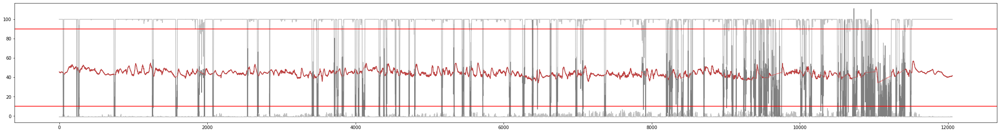

segment 0 12.511997334402622
segment 1 13.78711802990074
segment 2 4.606940455385484
segment 3 24.462997176493445


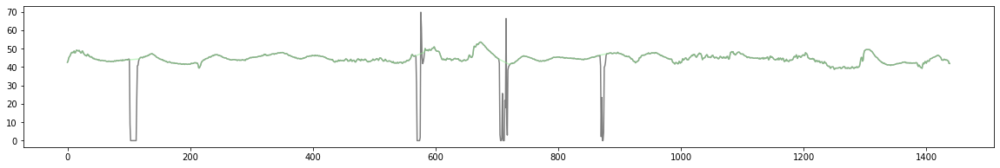

segment 4 0.5780557794987544
segment 5 4.147995337663815
segment 6 0.7479867752590508
segment 7 2.5161328623016743
segment 8 0.3059962632469251
segment 9 0.5779466942658473
segment 10 3.1110780520430126
segment 11 3.3151745717295853
segment 12 10.302054730847885
segment 13 4.352021743781734
segment 14 1.1729406126542017
segment 15 8.619047536056314
segment 16 2.6178741017156426
segment 17 1.5639642930218542
segment 18 3.706017431039072
segment 19 1.1389445493914536
segment 20 3.978183667146368
segment 21 1.020138475463682
segment 22 4.709025148273213
segment 23 8.211028342409918
segment 24 4.555994626147367
segment 25 0.16980376797801
segment 26 0.6800321225910011
segment 27 0.6290317610291822
segment 28 1.5808941665327438
segment 29 6.834090909496808
segment 30 0.28900097874247876
segment 31 0.8329446521693171
segment 32 2.2780482819416648
segment 33 1.445046989721959
segment 34 0.5609630120452493
segment 35 0.18692406680020213
segment 36 0.4760179058084759
segment 37 4.13102976467962

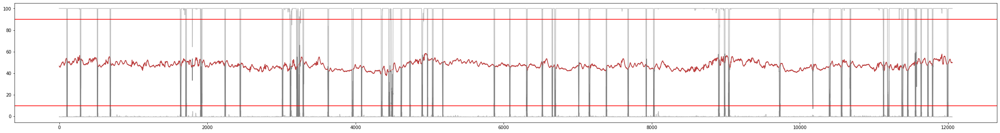

segment 0 32.36807722675803


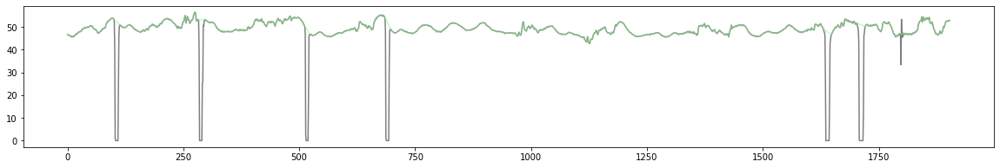

segment 1 20.077010023416733
segment 2 0.9520091426438739
segment 3 11.695994981344484
segment 4 6.324103676399318
segment 5 1.3430019814913976
segment 6 6.510976189198118
segment 7 67.60906118823732


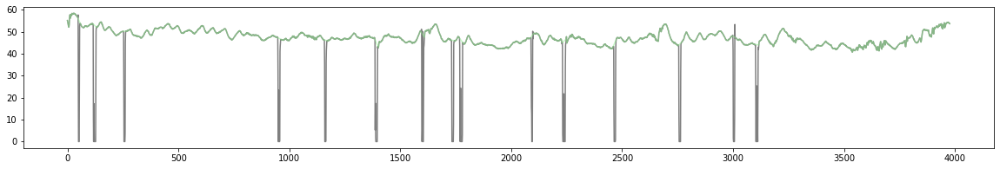

segment 8 25.023921264604724


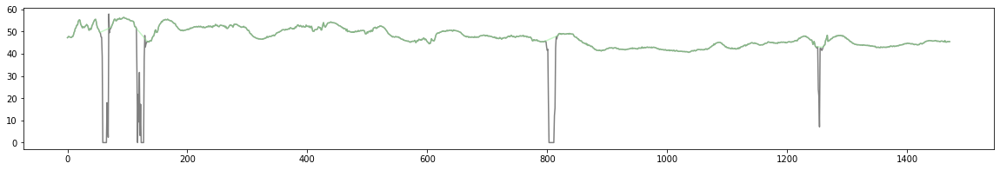

segment 9 13.021985675020915
segment 10 2.75400777845789
segment 11 2.6859991584969976
segment 12 8.177002929645823
3 segments, 125.00105967960008 seconds total length
03 Baseline 000_A
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_02_28_BRD_P03/000_A/pupil_data']
0.9


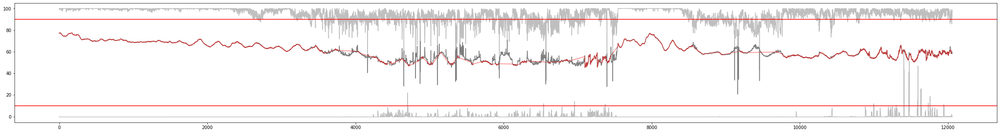

segment 0 45.611155548136594


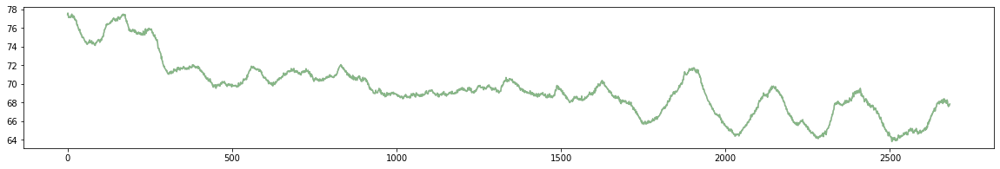

segment 1 11.033149267324916
segment 2 2.839024422373768
segment 3 0.6629829367702769
segment 4 0.3912394225044409
segment 5 0.47635904631533776
segment 6 1.9550809376123652
segment 7 0.30567760087069473
segment 8 0.254982582955563
segment 9 0.6459976558289782
segment 10 0.2890743020652735
segment 11 0.1870386536429578
segment 12 0.45896891434676945
segment 13 1.070978021278279
segment 14 0.23824278688334743
segment 15 1.3263841940643033
segment 16 0.22119745222880738
segment 17 0.3228804919963295
segment 18 2.4312679394533916
segment 19 0.6457800559037423
segment 20 1.0201419804616307
segment 21 1.3938103074215178
segment 22 0.22088115422229748
segment 23 2.056837194089894
segment 24 3.2300223137644934
segment 25 2.0060478095329017
segment 26 17.067871345265303
segment 27 0.42520988134128856
segment 28 0.20411290738047683
segment 29 0.8327791767769668
segment 30 0.5610785564240359
segment 31 0.186459547465347
segment 32 8.210884741791233
segment 33 2.24420415406712
segment 34 5.576194

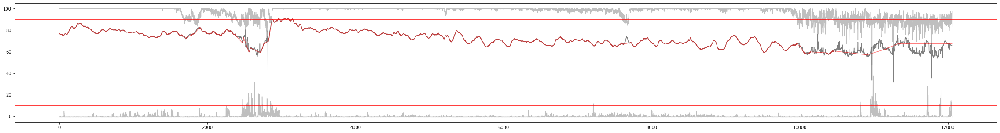

segment 0 28.57718039901374


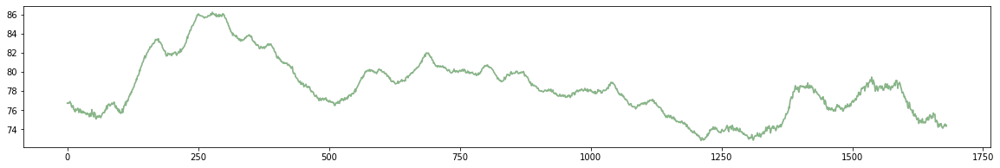

segment 1 0.20396565686678514
segment 2 0.680103418239014
segment 3 8.60197464311932
segment 4 0.2549701409698173
segment 5 0.4079481832450256
segment 6 0.9519791989660007
segment 7 0.22102657175491913
segment 8 80.68183524882625


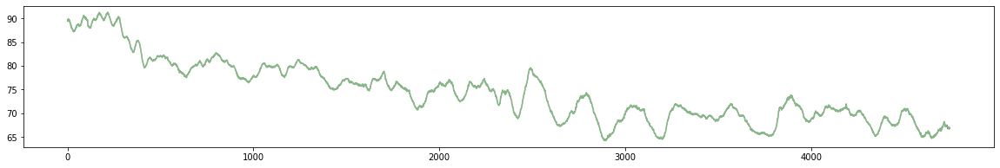

segment 9 38.65827861612706


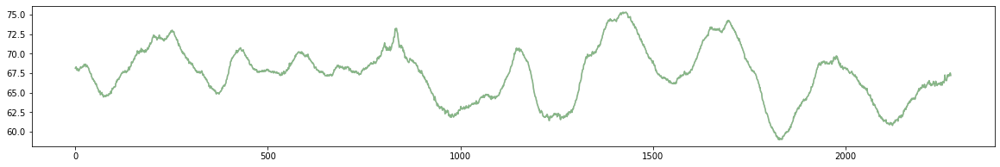

segment 10 0.1700310935957532
segment 11 0.7480704512854572
segment 12 0.2550035247913911
segment 13 1.7339669090433745
segment 14 0.27200842952152016
segment 15 0.28904323091046535
segment 16 0.16999234828472254
segment 17 0.0
3 segments, 147.91729426396705 seconds total length
03 Baseline 002_A
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_02_28_BRD_P03/002_A/pupil_data']
0.9


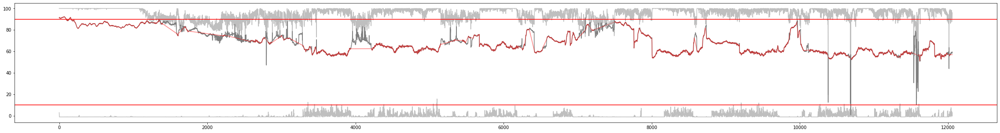

segment 0 20.70564768746408
segment 1 1.2579707555087225
segment 2 0.22081560013975832
segment 3 0.3570749590435298
segment 4 0.9521526008247747
segment 5 0.33991348430572543
segment 6 3.0600082941018627
segment 7 0.6969731183198746
segment 8 0.1870063245150959
segment 9 0.22077916095440742
segment 10 0.28908407947892556
segment 11 10.931018328396021
segment 12 15.912021386066044
segment 13 0.33998575935402187
segment 14 0.663146880298882
segment 15 0.4079618953510362
segment 16 10.438091942913161
segment 17 1.6149903640653065
segment 18 1.938045162045455
segment 19 7.1399360660943785
segment 20 0.7139368273346918
segment 21 0.3569620472553652
segment 22 18.241009860812483
segment 23 21.02897595819377
segment 24 3.229973889392568
segment 25 8.686973050076631
segment 26 0.594918585880805
segment 27 9.418031027325924
segment 28 2.8560791574091127
segment 29 6.477071921384777
segment 30 0.16994113495820784
segment 31 0.0
0 segments, 0 seconds total length
04 Baseline 006_C
['/Volumes/psp_

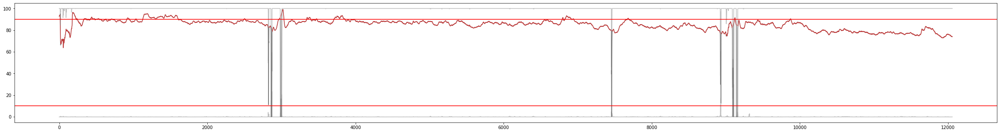

segment 0 50.69398247297613


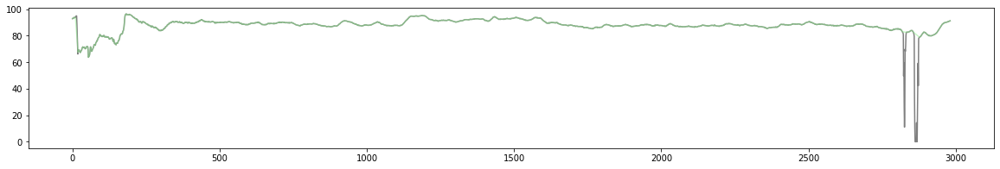

segment 1 103.30900183646918


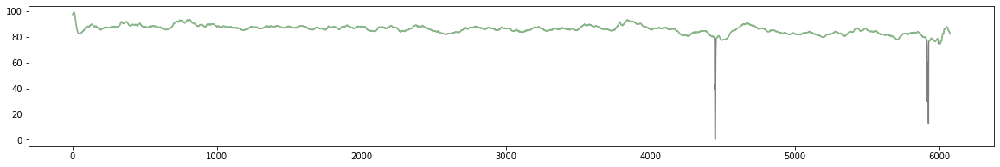

segment 2 0.47598375486813893
segment 3 49.18100594918542


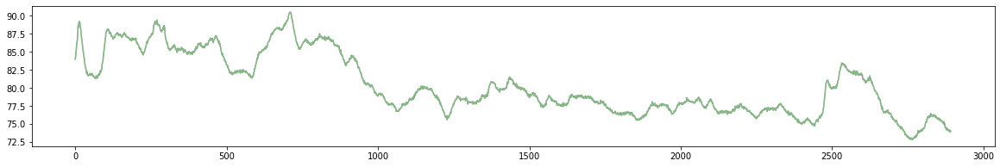

3 segments, 203.18399025863073 seconds total length
04 Baseline 007_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_03_29_WSA_P04/007_C/pupil_data']
0.9


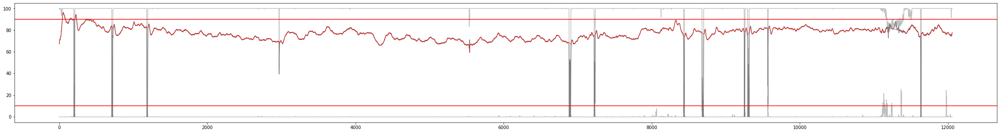

segment 0 12.019012734352145
segment 1 104.58409948197004


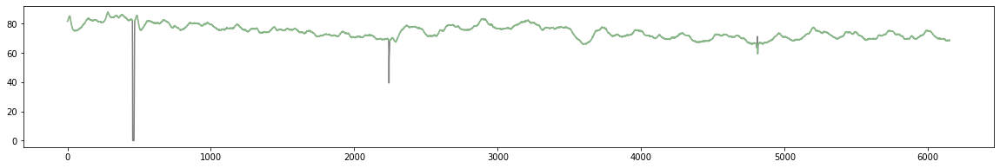

segment 2 29.97094611942157


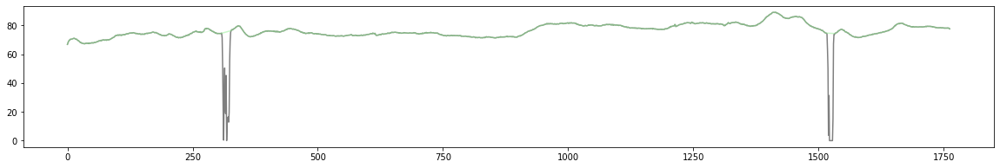

segment 3 9.996006219662377
segment 4 31.483997324678057


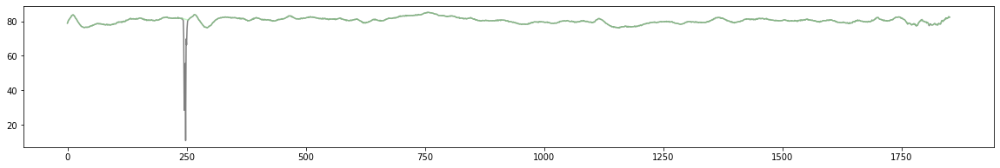

segment 5 11.185995228341199
3 segments, 166.03904292606967 seconds total length
04 Baseline 008_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_03_29_WSA_P04/008_C/pupil_data']
0.9


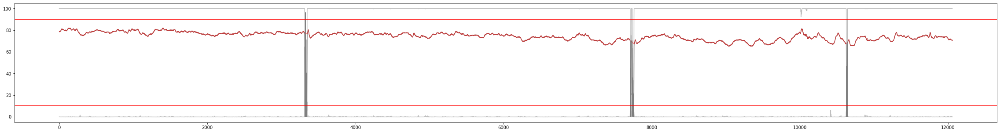

segment 0 56.2870118938863


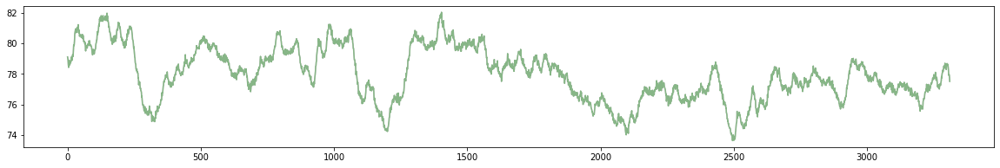

segment 1 74.06897895199836


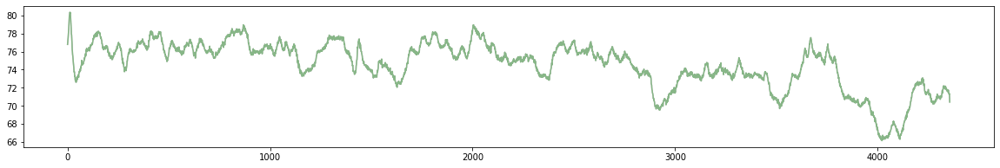

segment 2 48.61997572948712


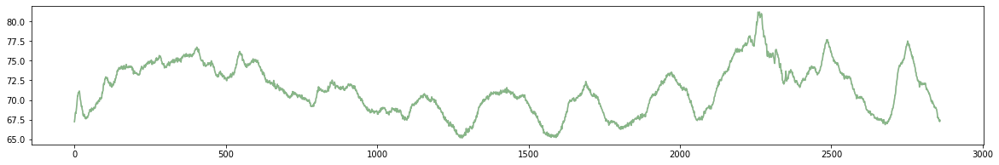

segment 3 23.98701282028378
3 segments, 178.97596657537179 seconds total length
05 Baseline 000_A
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_11_BOH_P05/000_A/pupil_data']
0.9


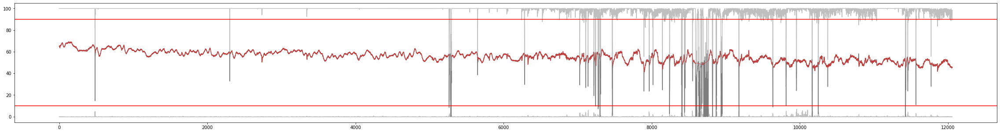

segment 0 89.4200131429725


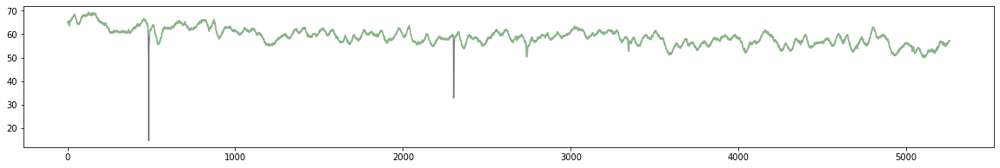

segment 1 33.37101532359611


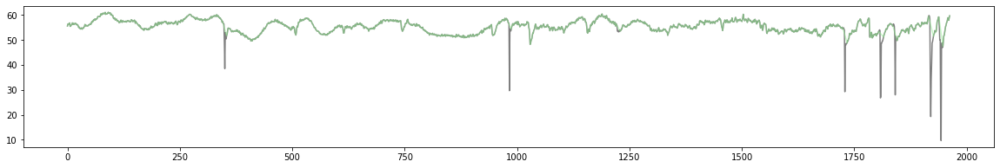

segment 2 19.10799890785256
segment 3 2.209983360330625
segment 4 0.18703271786034747
segment 5 2.753978866302532
segment 6 52.73401094453766


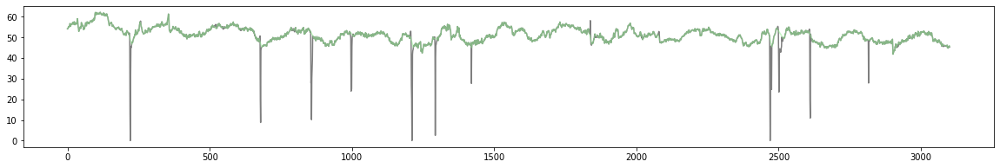

3 segments, 175.52503941110626 seconds total length
05 Baseline 001_A
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_11_BOH_P05/001_A/pupil_data']
0.9


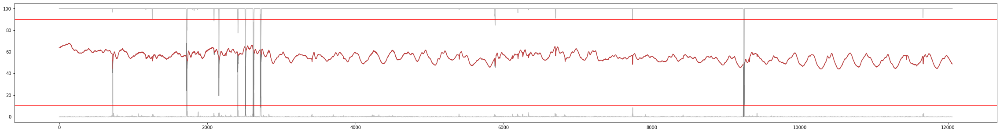

segment 0 156.96109058290403


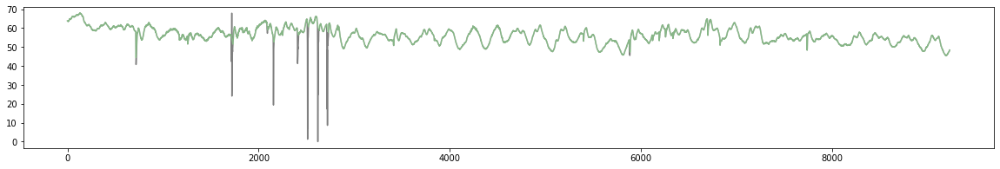

segment 1 47.65097006205815


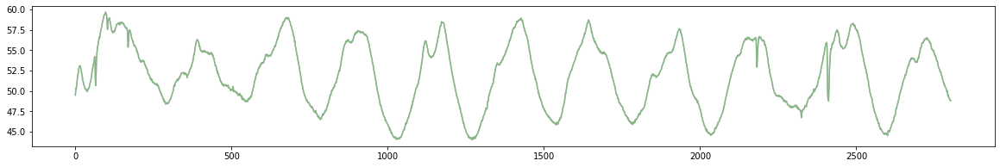

2 segments, 204.61206064496218 seconds total length
05 Baseline 002_A
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_11_BOH_P05/002_A/pupil_data']
0.9


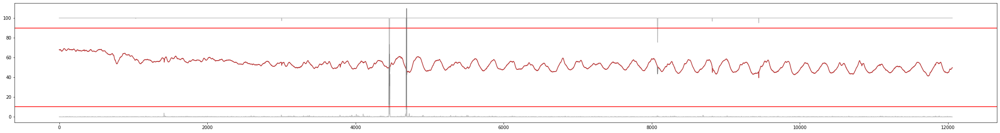

segment 0 204.96903084771475


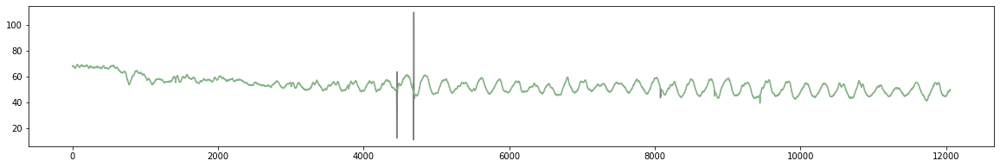

1 segments, 204.96903084771475 seconds total length
06 Baseline 003_B
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_12_KRE_P06/003_B/pupil_data']
0.9


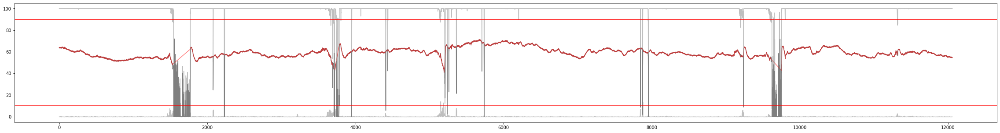

segment 0 25.95902051892699


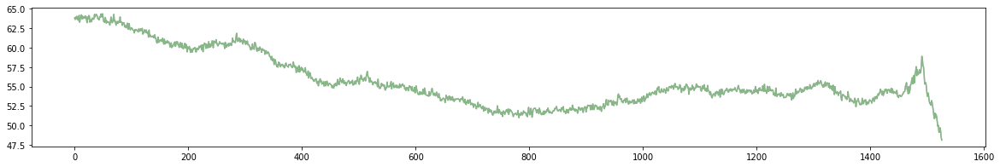

segment 1 32.555024375833455


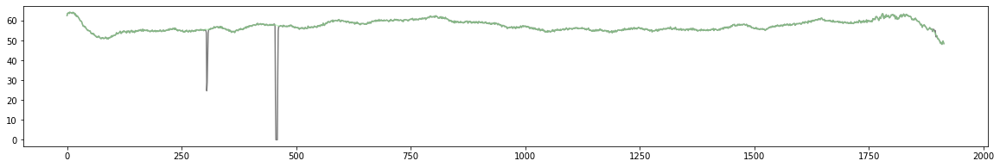

segment 2 0.169906323786563
segment 3 98.95698548140354


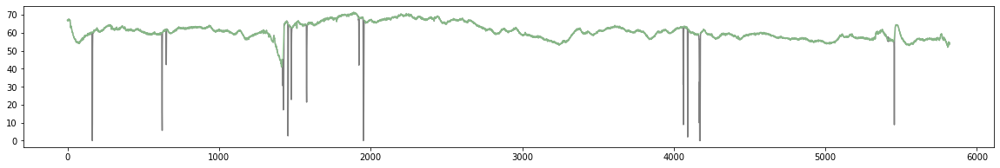

segment 4 39.15108031519412


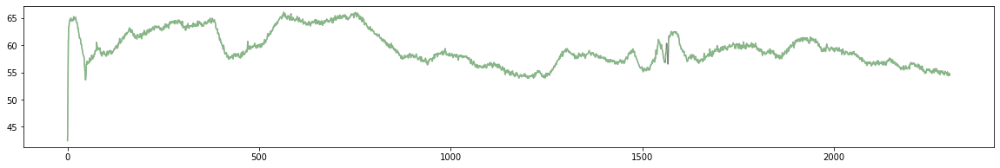

4 segments, 196.6221106913581 seconds total length
06 Baseline 004_B
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_12_KRE_P06/004_B/pupil_data']
0.9


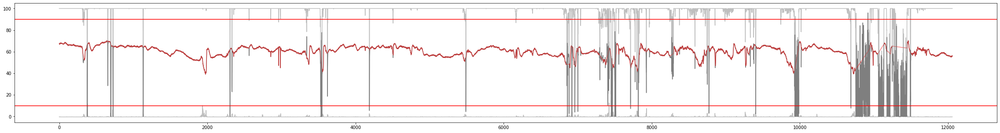

segment 0 59.857045396318426


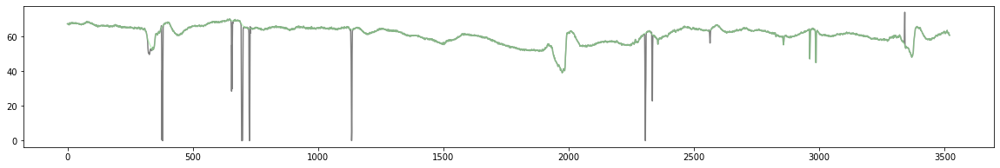

segment 1 55.99810678652648


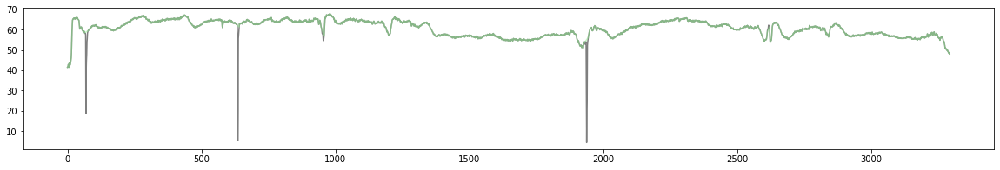

segment 2 6.731983082856459
segment 3 0.7139907283381035
segment 4 0.16995680982654449
segment 5 0.220969439142209
segment 6 5.014990307387052
segment 7 6.918889416887396
segment 8 17.254944087653712
segment 9 10.030010641159606
segment 10 12.869025725292886
segment 11 1.733917995068623
segment 12 0.5439703326192102
segment 13 0.37397606876766076
segment 14 10.3530247527342
2 segments, 115.8551521828449 seconds total length
06 Baseline 005_B
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_12_KRE_P06/005_B/pupil_data']
0.9


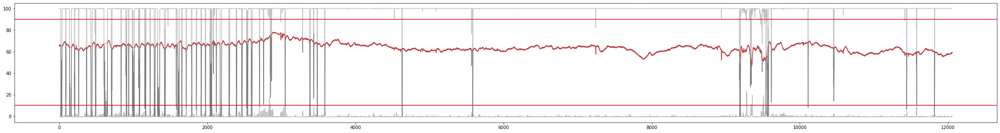

segment 0 0.32301640391960973
segment 1 1.6150019125088875
segment 2 4.317937245341454
segment 3 2.600940561907919
segment 4 5.57610531791579
segment 5 0.8669868985052744
segment 6 1.0200476260688447
segment 7 2.567028426383331
segment 8 3.689003927516751
segment 9 6.952964222127775
segment 10 1.7679556395087275
segment 11 5.609985619666986
segment 12 5.032055447307357
segment 13 45.763778249707684


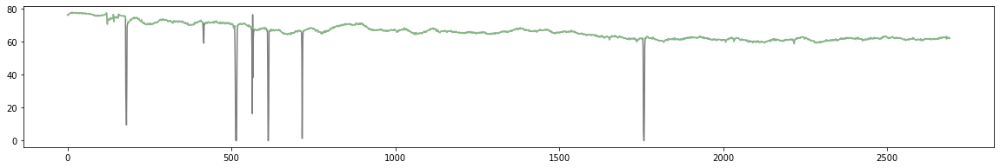

segment 14 61.046972517426184


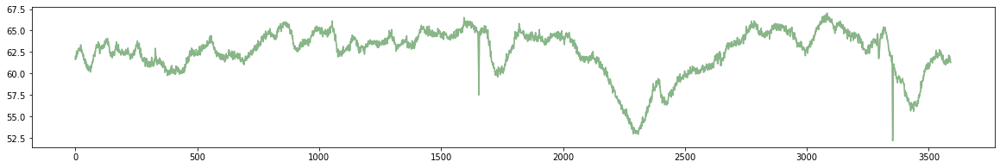

segment 15 2.0229801586792746
segment 16 1.988910110656434
segment 17 0.7139820007578237
segment 18 42.09202580947385


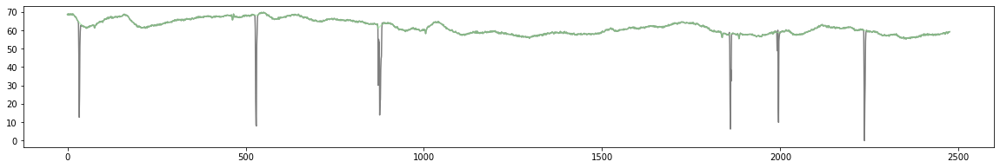

3 segments, 148.90277657660772 seconds total length
07 Baseline 007_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_25_OPP_P07/007_C/pupil_data']
0.9


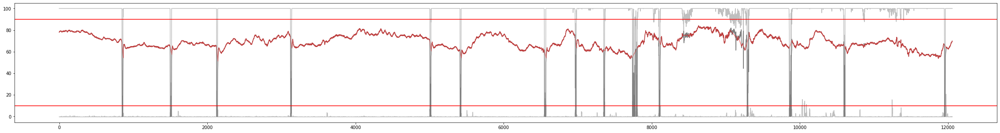

segment 0 25.415033903806034


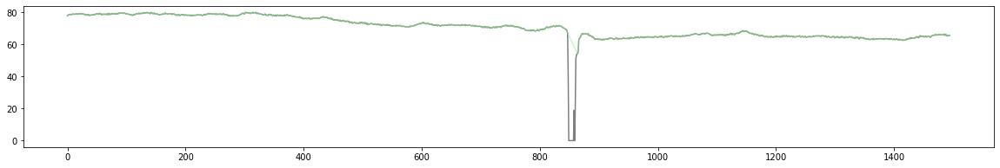

segment 1 10.200015065121988
segment 2 16.626014136632875
segment 3 31.619969216579193


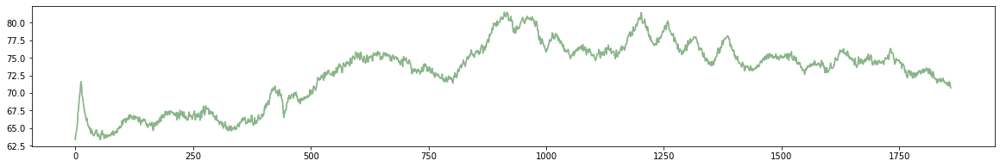

segment 4 25.90800965494418


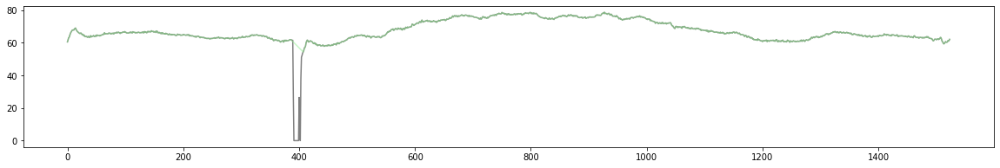

segment 5 6.613012033070845
segment 6 6.187900176173571
segment 7 6.22198689533252
segment 8 4.794275630796619
segment 9 5.134185561375489
segment 10 9.519859206015099
segment 11 0.23799612330185482
segment 12 0.9179982754067169
segment 13 9.197034262622765
segment 14 11.831937266822933
segment 15 22.694939722186973
segment 16 1.3600447534445266
3 segments, 82.94301277532941 seconds total length
07 Baseline 008_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_25_OPP_P07/008_C/pupil_data']
0.9


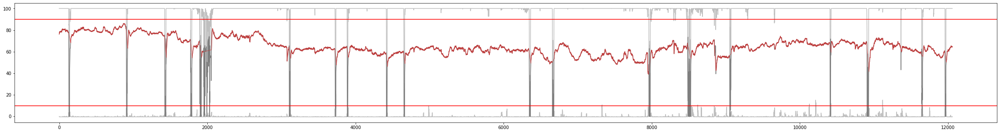

segment 0 2.1419696341326926
segment 1 21.53893400621382
segment 2 5.5420066238657455
segment 3 1.6999891670966463
segment 4 0.3229575422083144
segment 5 17.816033954954037
segment 6 54.72299671118162


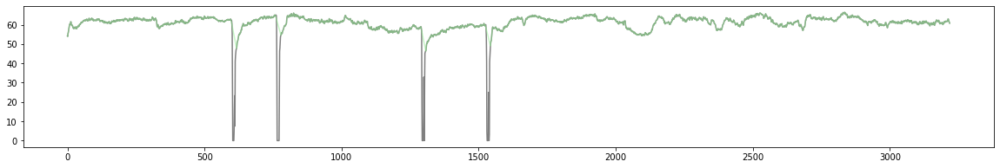

segment 7 4.895976250372769
segment 8 21.69194592762142
segment 9 8.33000255677689
segment 10 5.287002705459599
segment 11 3.0940543884207727
segment 12 31.093062535277568


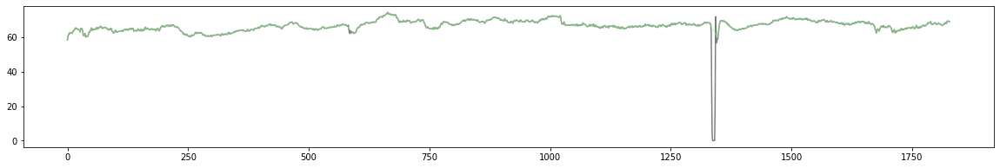

segment 13 19.142041621384124
2 segments, 85.81605924645919 seconds total length
07 Baseline 009_C
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_04_25_OPP_P07/009_C/pupil_data']
0.9


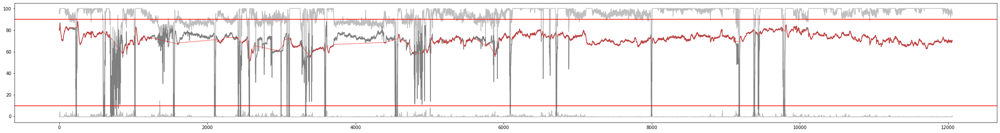

segment 0 2.346018083386298
segment 1 5.847977935125527
segment 2 0.8500624850203167
segment 3 2.5329585259205487
segment 4 3.332052610516257
segment 5 0.32300185379062896
segment 6 1.546986959685455
segment 7 0.22099540553244879
segment 8 1.0030167340373737
segment 9 1.0029974775534356
segment 10 0.1870289262406004
segment 11 0.22101189268141752
segment 12 2.379933046311635
segment 13 0.2549592971045058
segment 14 2.651972010586178
segment 15 1.4959648378498969
segment 16 0.2209880093942047
segment 17 0.8669918879058969
segment 18 0.17000214343715925
segment 19 0.20402382552128984
segment 20 0.25495298592431936
segment 21 3.38293577092918
segment 22 3.1960358630822157
segment 23 0.5949766187441128
segment 24 2.261032944159524
segment 25 0.7140340568839747
segment 26 0.2890413779641676
segment 27 2.2269610286675743
segment 28 8.516917820827075
segment 29 1.1049431111277954
segment 30 21.335015361550177
segment 31 19.125014747289242
segment 32 3.1110432839705027
segment 33 0.45898242593

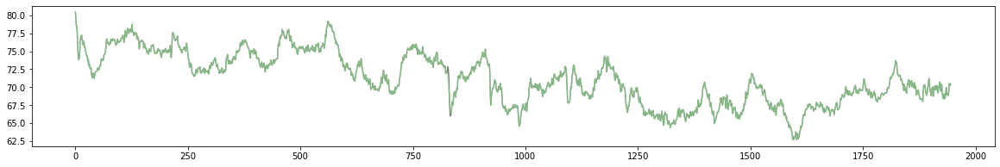

1 segments, 33.08199201462048 seconds total length
08 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_22_LEM_P08/000/pupil_data']
0.9


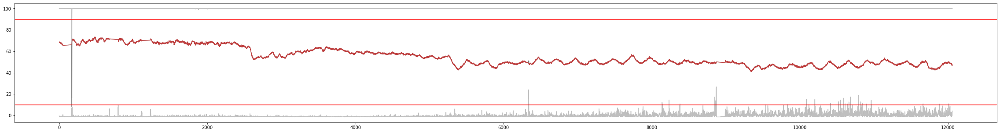

segment 0 204.96899317628913


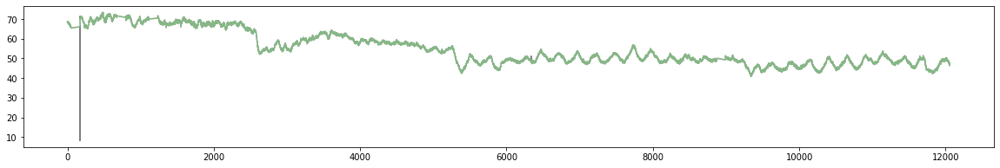

1 segments, 204.96899317628913 seconds total length
08 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_22_LEM_P08/001/pupil_data']
0.9


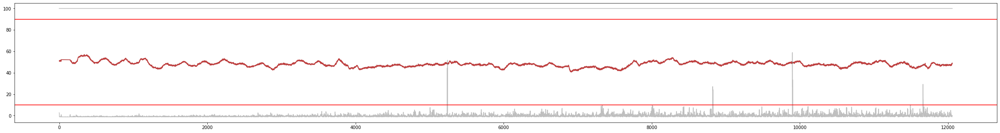

segment 0 204.96893287844887


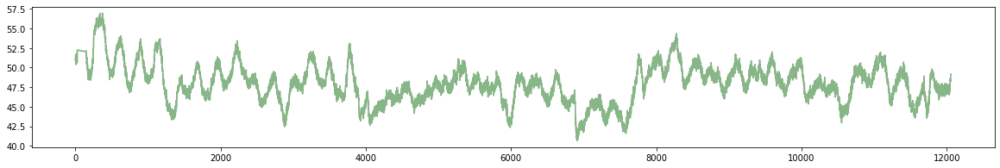

1 segments, 204.96893287844887 seconds total length
08 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_22_LEM_P08/002/pupil_data']
0.9


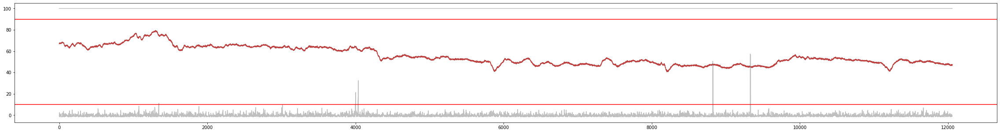

segment 0 204.96903350057255


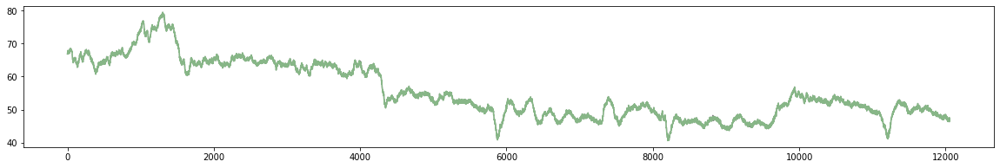

1 segments, 204.96903350057255 seconds total length
09 Baseline 006
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_29_TAJ_P09/006/pupil_data']
0.9


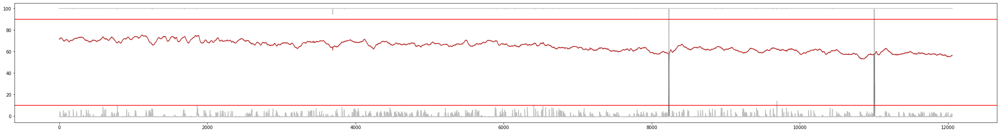

segment 0 204.96892608777853


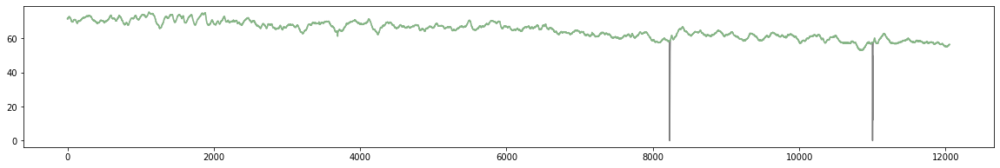

1 segments, 204.96892608777853 seconds total length
09 Baseline 007
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_29_TAJ_P09/007/pupil_data']
0.9


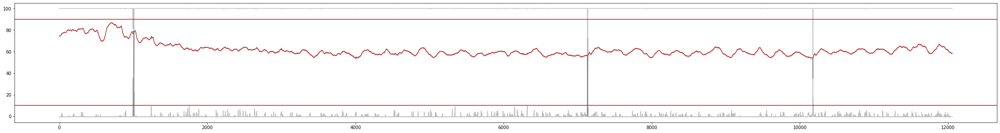

segment 0 16.829918327435735
segment 1 187.69704804266803


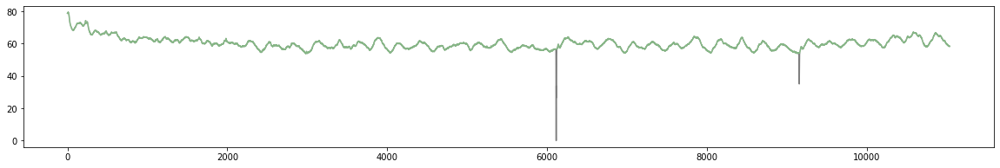

1 segments, 187.69704804266803 seconds total length
09 Baseline 008
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_08_29_TAJ_P09/008/pupil_data']
0.9


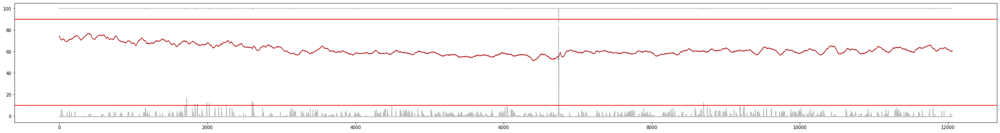

segment 0 204.96895957122615


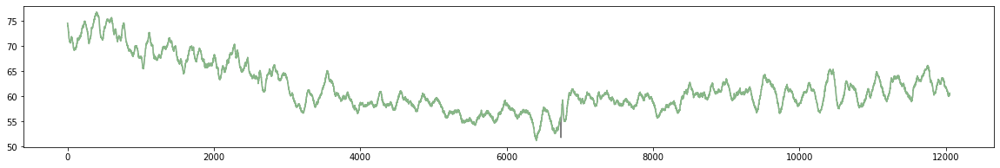

1 segments, 204.96895957122615 seconds total length
10 Baseline 000
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_09_12_BRH_P10/000/pupil_data']
0.9


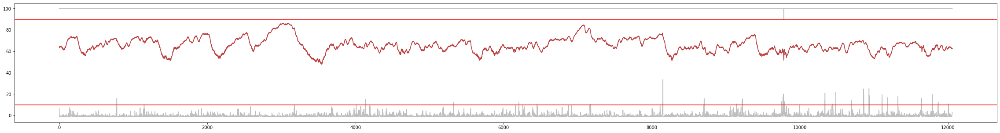

segment 0 204.96889045872376


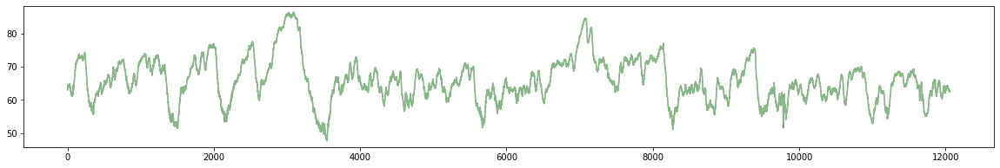

1 segments, 204.96889045872376 seconds total length
10 Baseline 001
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_09_12_BRH_P10/001/pupil_data']
0.9


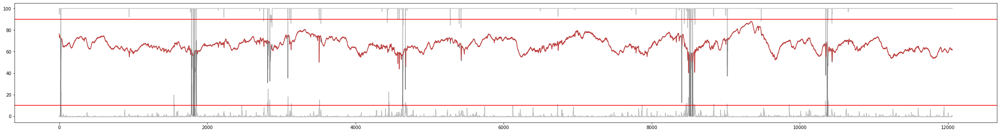

segment 0 30.71905388616142


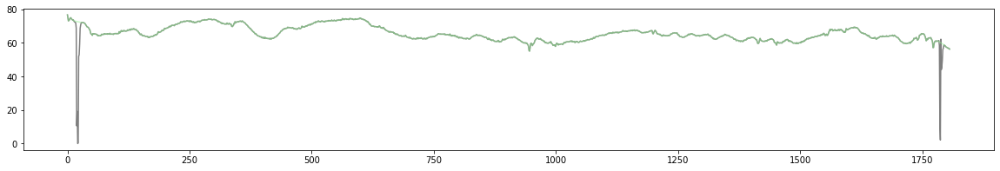

segment 1 17.102126931611565
segment 2 95.65896449070715


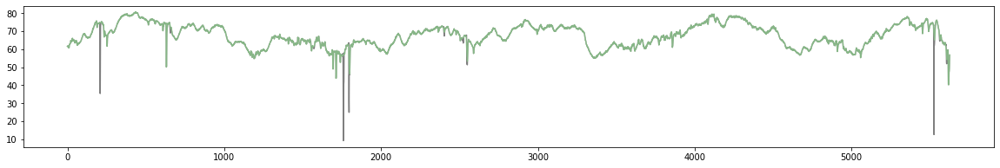

segment 3 59.90798525742139


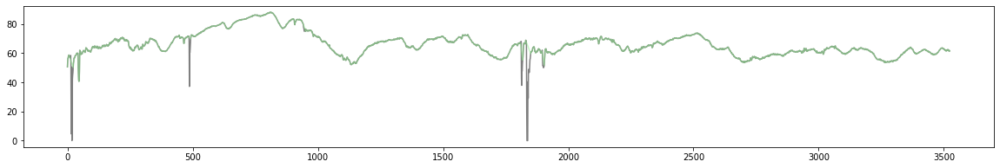

3 segments, 186.28600363428995 seconds total length
10 Baseline 002
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_09_12_BRH_P10/002/pupil_data']
0.9


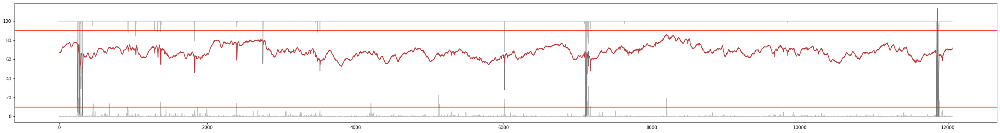

segment 0 120.71706003541476


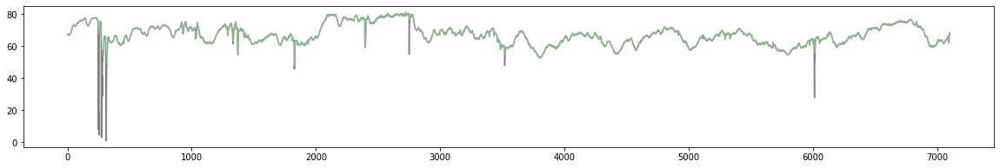

segment 1 80.08696294258698


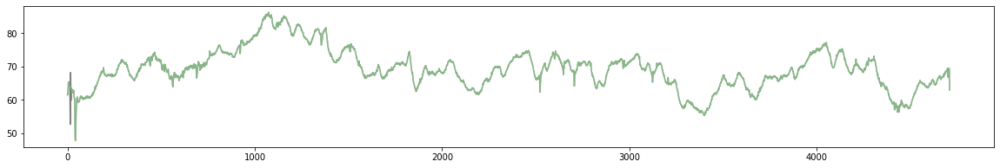

segment 2 3.0260061228618724
2 segments, 200.80402297800174 seconds total length
11 Baseline 003
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_10_17_LEH_P11/003/pupil_data']
Confidence equal in both eyes
0.9


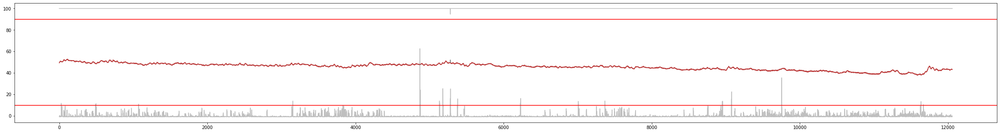

segment 0 204.96892118838332


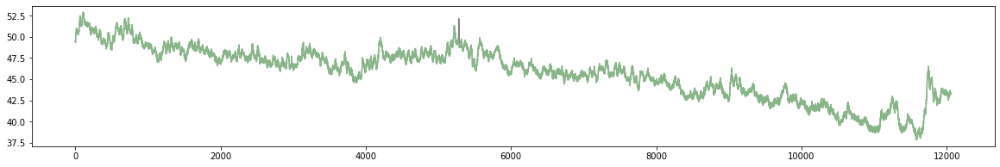

1 segments, 204.96892118838332 seconds total length
11 Baseline 004
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_10_17_LEH_P11/004/pupil_data']
0.9


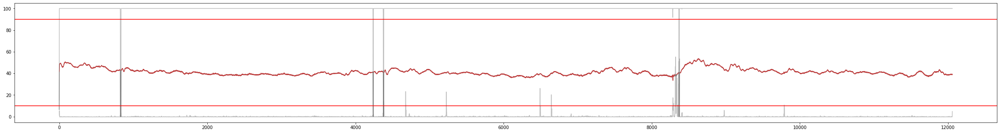

segment 0 141.35506333139074


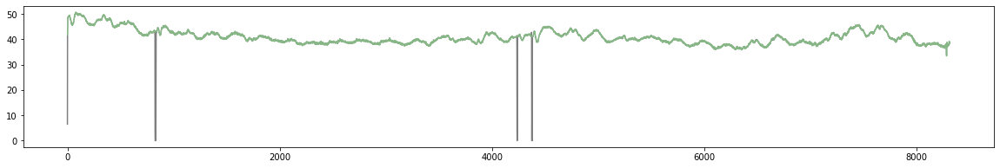

segment 1 0.2379385313106468
segment 2 62.50891180938379


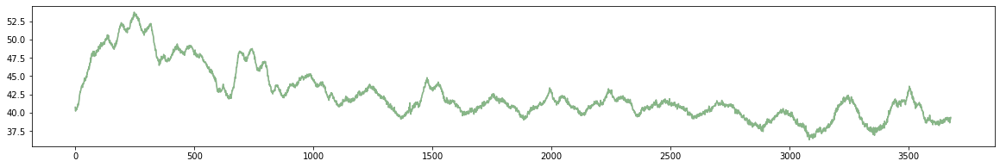

2 segments, 203.86397514077453 seconds total length
11 Baseline 005
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_10_17_LEH_P11/005/pupil_data']
0.9


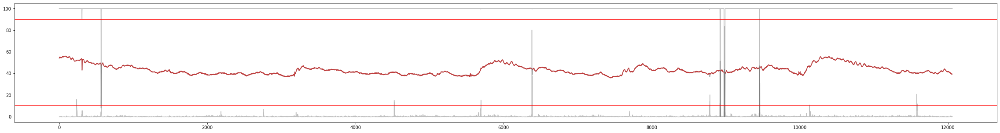

segment 0 204.96895546564792


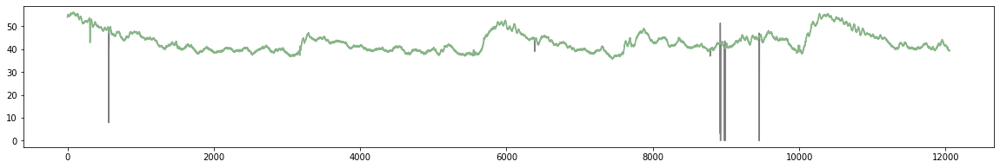

1 segments, 204.96895546564792 seconds total length
12 Baseline 006
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_11_22_THO_P12/006/pupil_data']
0.9


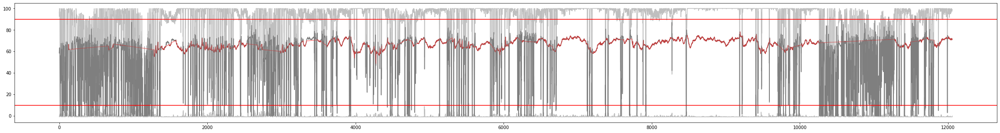

segment 0 0.0
segment 1 0.1869645564001985
segment 2 0.16995609347941354
segment 3 0.18701703308033757
segment 4 1.1729552656470332
segment 5 0.8330983955529518
segment 6 0.5099831941479351
segment 7 4.182074679352809
segment 8 1.3089635314245243
segment 9 4.369108871964272
segment 10 0.7650580824411009
segment 11 1.360082660074113
segment 12 1.1050281644857023
segment 13 0.22095012626959942
segment 14 0.2039077003719285
segment 15 3.0089711476757657
segment 16 0.39096172258723527
segment 17 0.7649746390234213
segment 18 0.7139754587260541
segment 19 0.7820052725146525
segment 20 0.3739556282234844
segment 21 2.567042901471723
segment 22 3.281009222351713
segment 23 5.032091156113893
segment 24 1.037020542396931
segment 25 0.2720317729981616
segment 26 0.5099544573167805
segment 27 6.680963583377888
segment 28 0.9859319867100567
segment 29 0.7819788255728781
segment 30 1.6320591588155366
segment 31 3.3490223428525496
segment 32 0.1700247217377182
segment 33 2.481918814504752
segment 34

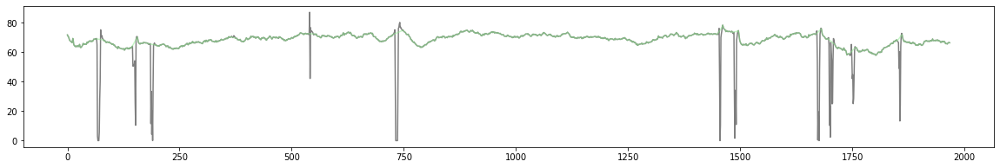

segment 43 0.7990001723519526
segment 44 0.6970298816158902
segment 45 4.011953655455727
segment 46 0.3570522164518479
segment 47 2.9580809813633095
segment 48 0.6630051572574303
segment 49 0.39099036471452564
segment 50 4.198875932954252
1 segments, 33.456032370217144 seconds total length
12 Baseline 007
['/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/2017_11_22_THO_P12/007/pupil_data']
0.9


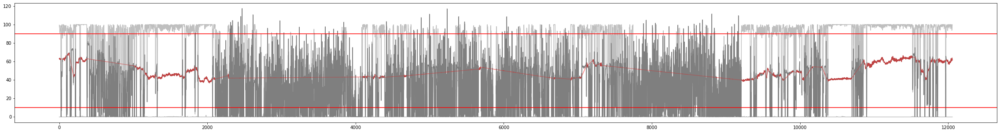

segment 0 0.32296243132441305
segment 1 1.3430236915592104
segment 2 2.957997813093243
segment 3 1.8359441159118433
segment 4 2.3119955747097265
segment 5 6.188067541370401
segment 6 0.35702871216926724
segment 7 5.8820207713288255
segment 8 0.23790329016628675
segment 9 1.0369247006019577
segment 10 0.3226008880592417
segment 11 1.2071193832089193
segment 12 0.4759416230081115
segment 13 0.37399847092456184
segment 14 0.23807368124835193
segment 15 0.2889574342116248
segment 16 0.2549245950067416
segment 17 0.27197413664544
segment 18 0.9180194186919834
segment 19 0.4419399013277143
segment 20 1.921082418935839
segment 21 0.4080015424406156
segment 22 0.7140004703542218
segment 23 1.2920583571540192
segment 24 0.6289266981475521
segment 25 0.391027674311772
segment 26 0.2209856804984156
segment 27 0.22105426437337883
segment 28 0.6120382698718458
segment 29 0.7309718227479607
segment 30 0.23798649592208676
segment 31 0.22102237719809636
segment 32 5.372061022324488
segment 33 11.20296

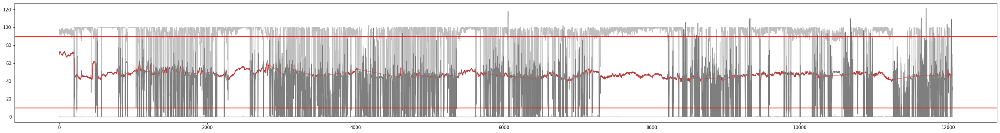

segment 0 8.074955806514481
segment 1 4.641005772224162
segment 2 0.8500335241842549
segment 3 3.026023386948509
segment 4 0.3059577613894362
segment 5 0.187087744474411
segment 6 0.6290435133851133
segment 7 0.6459666120645124
segment 8 0.20400724673527293
segment 9 0.18696167317102663
segment 10 0.7990358975075651
segment 11 0.18707178015029058
segment 12 1.9889871959749144
segment 13 5.269986639264971
segment 14 0.18701285548740998
segment 15 1.5809663025138434
segment 16 1.1219606501690578
segment 17 0.18700932446517982
segment 18 0.20420153709710576
segment 19 0.2720512946252711
segment 20 1.4279946177266538
segment 21 0.23799096321454272
segment 22 0.3059338341408875
segment 23 0.289039297203999
segment 24 0.203995202871738
segment 25 1.0200100381916855
segment 26 0.18702855380252004
segment 27 5.729022262792569
segment 28 0.7649470747564919
segment 29 0.7480061628448311
segment 30 1.4280109839746729
segment 31 0.3229900910228025
segment 32 0.25502340955426916
segment 33 0.322939

In [13]:
out_dir = '/Volumes/psp_data/Preprocessing_segmented_2023-12-27/PD'
slu.mkdir_p(out_dir)



for subject, runs in dt.ips_runs.items():
    for run in runs:
        if subject[0] != 'H':
            print(subject, session, run)
            sub = subject
            group = 'PD'
            session = 'Baseline'

            path = glob(join('/Volumes/psp_data/Eyetracking_PD_STN_SNr_Gulbi/IPS/20*P{0}'.format(sub),'{}*'.format(run),  'pupil_data'))
            print(path)
            with open(path[0], 'rb') as f:
                file = pickle.load(f, encoding="latin-1")
            df = pd.DataFrame(file['pupil_positions'])    
            p = PS.PupilFrame(subject, group, session, run, directory='', out_dir=out_dir)

            p.pupil['left'] = df.loc[df.id == 0].drop(['norm_pos',
                                                          'ellipse',
                                                          'method'], axis=1)
            p.pupil['right'] = df.loc[df.id == 1].drop(['norm_pos',
                                                           'ellipse',
                                                           'method'], axis=1)
            p.pupil['gaze'] = pd.DataFrame(file['gaze_positions'])


            p.cut_resample()
            p.excel()
            excel_thresh=10
            confidence_thresh=.9
            islands=10
            margin1=3
            margin2=3

            p.discard_interp(excel_thresh=excel_thresh, confidence_thresh=confidence_thresh,
                                 islands=islands, margin2=margin2, margin1=margin1)

            f, ax = plt.subplots(figsize=(40, 5))
            ax.plot(p.gp.diameter_mean.values, color='black', alpha=.5)
            ax.plot(p.gp.d_intp.values, color='red', alpha=.5)

            ax.plot(p.gp.confidence_d.values*100, color='grey', alpha=.5)
            ax.axhline(confidence_thresh*100, color='red')
            print(confidence_thresh)

            ax.plot(p.gp.acceleration.values*2, color='grey', alpha=.5)
            ax.axhline(excel_thresh, color='red')
            plt.show()
            p.normalize()

            threshhold = 350

            long_invalid_start = []
            long_invalid_end = []


            array = p.gp.diameter_blink.isnull()
            convolved = np.convolve(~array, [0.5, 1], 'same')
            ev_start = np.where(convolved == .5)[0]
            fragment_ends = ev_start
            if convolved[0] != 0:
                fragment_ends = fragment_ends[1:len(fragment_ends)]
            if convolved[len(convolved) - 1] == 0:
                fragment_ends = np.append(fragment_ends, len(array))
            ev_end = np.where(convolved == 1)[0]
            if convolved[0] == 0:
                fragment_starts = np.append(0, ev_end)
            else:
                fragment_starts = ev_end
            if convolved[-1] == 1:
                fragment_starts = fragment_starts[0:-1]
            assert len(fragment_ends) == len(fragment_starts)
            if fragment_ends[-1] == len(array):
                fragment_ends[-1] = fragment_ends[-1] - 1
            for i, s in enumerate(fragment_starts):
                timedelta = array.reset_index().iloc[fragment_ends[i]].time - array.reset_index().iloc[fragment_starts[i]].time
                if timedelta > pd.Timedelta('350ms'):
                    long_invalid_start.append(fragment_starts[i])
                    long_invalid_end.append(fragment_ends[i])


            long_invalid_end = np.append(0, long_invalid_end).astype(int)
            long_invalid_start = np.append(long_invalid_start, len(array)-1).astype(int)

            cum_length = []
            segments = []
            for i, s in enumerate(long_invalid_start):
                segment = p.gp[long_invalid_end[i]:long_invalid_start[i]]
                segment_length = p.gp.iloc[long_invalid_start[i]].timestamp.iloc[0] - p.gp.iloc[long_invalid_end[i]].timestamp.iloc[0]
                print("segment", i, segment_length)
                if segment_length > 24:
                    segments.append(segment)
                    cum_length.append(segment_length)
                    segment.drop(['id', 'time', 'timestamp'], axis=1).to_hdf(join(out_dir, 'Pupil_Preprocessed_SUB-{0}_{1}_{2}_{3}.hdf'.
                                        format(subject,
                                               session,
                                               run, i)), key='Pupil')
                    f, ax = plt.subplots(figsize=(20, 3))
                    ax.plot(segment.diameter_mean.values, color='black', alpha=.5)
                    ax.plot(segment.d_intp.values, color='lightgreen', alpha=.5)
                    plt.show()

            pdm = {'group':group,
                'subject': subject,
                                 'session': session,
                                 'run': run,
                                 'number_of_segments': len(segments),
                                 'segment_length': sum(cum_length),
                                 'excel_thresh': excel_thresh, 'confidence_thresh': confidence_thresh, 'islands': islands,
                                  'margin':margin1}
            preprocessing_meta.append(pdm)
            print('{0} segments, {1} seconds total length'.format(pdm['number_of_segments'], pdm['segment_length']))


In [37]:
# save metadata

meta = pd.DataFrame(preprocessing_meta)

In [50]:
meta.groupby(['group','subject', 'session']).sum().loc[meta.groupby(['group','subject', 'session']).sum().segment_length < 300]

number_of_segments  segment_length  excel_thresh  \
group subject session                                                      
PD    03      Baseline                   4      193.528450            30   
      07      Baseline                   6      201.841064            30   
      12      Baseline                   1       33.456032            30   
PSP   002     Baseline                   4      117.045026            30   
      003     Baseline                   2       53.040027            30   
      007     Followup                   8      249.152226            30   
      009     Baseline                   8      278.426116            30   

                        confidence_thresh  islands  margin  
group subject session                                       
PD    03      Baseline                2.7       30       9  
      07      Baseline                2.7       30       9  
      12      Baseline                2.7       30       9  
PSP   002     Baseline                2.7       30       9  
      003     Baseline                2.7       30       9  
      007     Followup                2.7       30       9  
      009     Baseline                2.7       30       9

In [51]:
meta.to_hdf(join(out_dir, 'Preprocessing_Metadata.hdf'), key='meta')

### Code for single subject for debugging and for correction

- Corrected manually: Subject 006 Basline

['/Volumes/psp_data/Lisa_Marc/2018_10_24_PSP_006_Baseline/004/pupil_data']
0.99


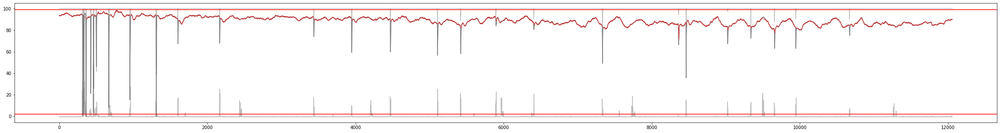

segment 0 5.202003609308122
segment 1 0.5779475883773557
segment 2 0.40794815741628554
segment 3 3.026013610316113
segment 4 29.42708127502192


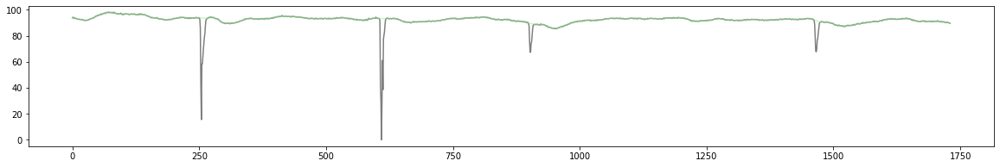

segment 5 59.41493884868487


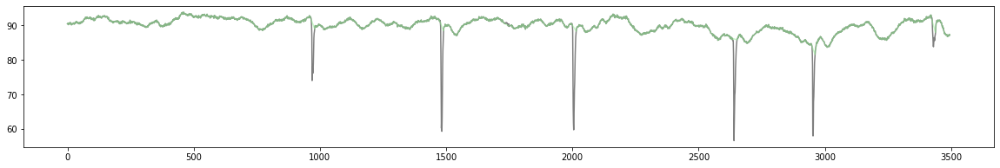

segment 6 29.35902004766922


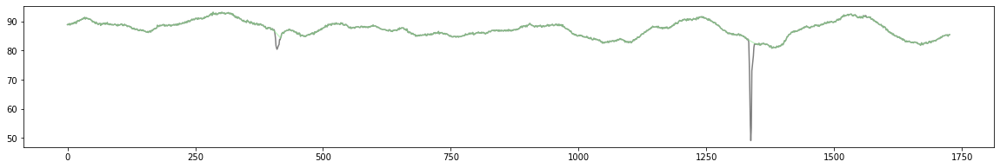

segment 7 29.613951352310323


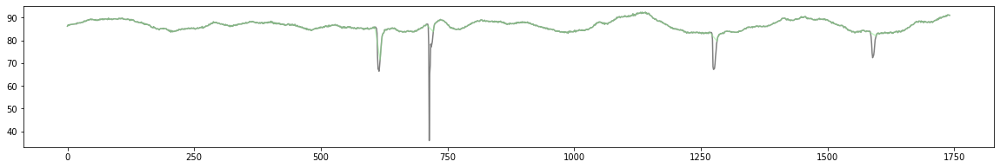

segment 8 42.99293599003704


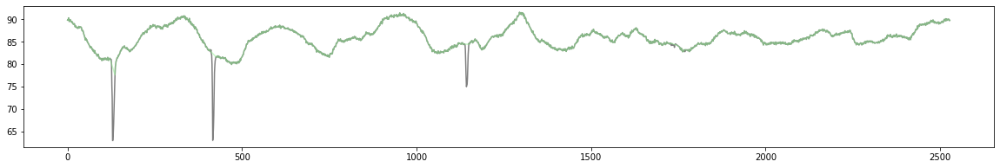

5 segments, 190.80792751372337 seconds total length


In [36]:
sub = '006'
subject = sub
session = 'Baseline'
run = '004'
group = 'PSP'
path = glob(join('/Volumes/psp_data/Lisa_Marc/20*SP_{0}_{2}*'.format(sub, run, session),'{}*'.format(run),  'pupil_data'))
out_dir = '/Volumes/psp_data/Preprocessing_segmented_2023-12-27/PSP'

print(path)
with open(path[0], 'rb') as f:
    file = pickle.load(f, encoding="latin-1")
df = pd.DataFrame(file['pupil_positions'])    
p = PS.PupilFrame(subject, group, session, run, directory='', out_dir=out_dir)

p.pupil['left'] = df.loc[df.id == 0].drop(['norm_pos',
                                              'ellipse',
                                              'method'], axis=1)
p.pupil['right'] = df.loc[df.id == 1].drop(['norm_pos',
                                               'ellipse',
                                               'method'], axis=1)
p.pupil['gaze'] = pd.DataFrame(file['gaze_positions'])


p.cut_resample()
p.excel()
excel_thresh=2
confidence_thresh=.99
islands=10
margin1=3
margin2=3

p.discard_interp(excel_thresh=excel_thresh, confidence_thresh=confidence_thresh,
                     islands=islands, margin2=margin2, margin1=margin1)

f, ax = plt.subplots(figsize=(40, 5))
ax.plot(p.gp.diameter_mean.values, color='black', alpha=.5)
ax.plot(p.gp.d_intp.values, color='red', alpha=.5)

ax.plot(p.gp.confidence_d.values*100, color='grey', alpha=.5)
ax.axhline(confidence_thresh*100, color='red')
print(confidence_thresh)

ax.plot(p.gp.acceleration.values*2, color='grey', alpha=.5)
ax.axhline(excel_thresh, color='red')
plt.show()
p.normalize()

threshhold = 350

long_invalid_start = []
long_invalid_end = []


array = p.gp.diameter_blink.isnull()
convolved = np.convolve(~array, [0.5, 1], 'same')
ev_start = np.where(convolved == .5)[0]
fragment_ends = ev_start
if convolved[0] != 0:
    fragment_ends = fragment_ends[1:len(fragment_ends)]
if convolved[len(convolved) - 1] == 0:
    fragment_ends = np.append(fragment_ends, len(array))
ev_end = np.where(convolved == 1)[0]
if convolved[0] == 0:
    fragment_starts = np.append(0, ev_end)
else:
    fragment_starts = ev_end
if convolved[-1] == 1:
    fragment_starts = fragment_starts[0:-1]
assert len(fragment_ends) == len(fragment_starts)
if fragment_ends[-1] == len(array):
    fragment_ends[-1] = fragment_ends[-1] - 1
for i, s in enumerate(fragment_starts):
    timedelta = array.reset_index().iloc[fragment_ends[i]].time - array.reset_index().iloc[fragment_starts[i]].time
    if timedelta > pd.Timedelta('350ms'):
        long_invalid_start.append(fragment_starts[i])
        long_invalid_end.append(fragment_ends[i])


long_invalid_end = np.append(0, long_invalid_end).astype(int)
long_invalid_start = np.append(long_invalid_start, len(array)-1).astype(int)

cum_length = []
segments = []
for i, s in enumerate(long_invalid_start):
    segment = p.gp[long_invalid_end[i]:long_invalid_start[i]]
    segment_length = p.gp.iloc[long_invalid_start[i]].timestamp.iloc[0] - p.gp.iloc[long_invalid_end[i]].timestamp.iloc[0]
    print("segment", i, segment_length)
    if segment_length > 24:
        segments.append(segment)
        cum_length.append(segment_length)
        segment.drop(['id', 'time', 'timestamp'], axis=1).to_hdf(join(out_dir, 'Pupil_Preprocessed_SUB-{0}_{1}_{2}_{3}.hdf'.
                            format(subject,
                                   session,
                                   run, i)), key='Pupil')
        f, ax = plt.subplots(figsize=(20, 3))
        ax.plot(segment.diameter_mean.values, color='black', alpha=.5)
        ax.plot(segment.d_intp.values, color='lightgreen', alpha=.5)
        plt.show()

pdm = {'group':group,
'subject': subject,
             'session': session,
             'run': run,
             'number_of_segments': len(segments),
             'segment_length': sum(cum_length),
             'excel_thresh': excel_thresh, 'confidence_thresh': confidence_thresh, 'islands': islands,
              'margin':margin1}
preprocessing_meta.append(pdm)
print('{0} segments, {1} seconds total length'.format(pdm['number_of_segments'], pdm['segment_length']))

